**<h3><span style="font-family: 'Consolas'; color:blue"><center>
                                AI-DRIVEN STOCKOUT RISK PREDICTION FOR SMARTER RETAIL INVENTORY MANAGEMENT
                                                </center></span></h3>**

<span style="font-family: 'Consolas';"><span style="color:magenta">
IMPORT REQUIRED LIBRARIES


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
from itertools import combinations
import scipy.stats as stats
from sklearn.preprocessing import LabelEncoder
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import PowerTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report


plt.rcParams['figure.figsize'] = 15,10
pd.set_option('display.max_columns', None)

<span style="font-family: 'Consolas';"><span style="color:magenta">
LOAD THE DATASET

In [3]:
df = pd.read_csv("C:/Desktop/GL - Data Science/CAPSTONE PROJECT/retail_store_inventory.csv")
df.head()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
0,2022-01-01,S001,P0001,Groceries,North,231,127,55,135.47,33.50,20,Rainy,0,29.69,Autumn
1,2022-01-01,S001,P0002,Toys,South,204,150,66,144.04,63.01,20,Sunny,0,66.16,Autumn
2,2022-01-01,S001,P0003,Toys,West,102,65,51,74.02,27.99,10,Sunny,1,31.32,Summer
3,2022-01-01,S001,P0004,Toys,North,469,61,164,62.18,32.72,10,Cloudy,1,34.74,Autumn
4,2022-01-01,S001,P0005,Electronics,East,166,14,135,9.26,73.64,0,Sunny,0,68.95,Summer


In [4]:
print(f'Number of Rows : {df.shape[0]}')
print(f'Number of Columns : {df.shape[1]}')
print()
print('Datatype of each column :')
df.dtypes

Number of Rows : 73100
Number of Columns : 15

Datatype of each column :


Date                   object
Store ID               object
Product ID             object
Category               object
Region                 object
Inventory Level         int64
Units Sold              int64
Units Ordered           int64
Demand Forecast       float64
Price                 float64
Discount                int64
Weather Condition      object
Holiday/Promotion       int64
Competitor Pricing    float64
Seasonality            object
dtype: object

In [5]:
cols = ['Holiday/Promotion']
for col in cols:
    print(f"Unique values in column '{col}':")
    print(df[col].unique())
    print()

Unique values in column 'Holiday/Promotion':
[0 1]



<span style="font-family: 'Consolas';"><span style="color:limegreen">
Holiday/Promotion can be treated as a categorical column

In [7]:
df['Holiday/Promotion'] = df['Holiday/Promotion'].astype(object)
df.dtypes

Date                   object
Store ID               object
Product ID             object
Category               object
Region                 object
Inventory Level         int64
Units Sold              int64
Units Ordered           int64
Demand Forecast       float64
Price                 float64
Discount                int64
Weather Condition      object
Holiday/Promotion      object
Competitor Pricing    float64
Seasonality            object
dtype: object

<span style="font-family: 'Consolas';"><span style="color:limegreen">
Seasonality column shows incosistent values, replacing it by classifying according to date

In [9]:
df = df.drop('Seasonality', axis = 1)

df['Date'] = pd.to_datetime(df['Date'])
df['Month'] = pd.to_datetime(df['Date']).dt.strftime('%b')

def get_season(month):
    if month in ['Dec', 'Jan', 'Feb']:
        return 'Winter'
    elif month in ['Mar', 'Apr', 'May']:
        return 'Spring'
    elif month in ['Jun', 'July', 'Aug']:
        return 'Summer'
    else:
        return 'Autumn'

df['Seasonality'] = df['Month'].apply(get_season)
df.head()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Month,Seasonality
0,2022-01-01,S001,P0001,Groceries,North,231,127,55,135.47,33.50,20,Rainy,0,29.69,Jan,Winter
1,2022-01-01,S001,P0002,Toys,South,204,150,66,144.04,63.01,20,Sunny,0,66.16,Jan,Winter
2,2022-01-01,S001,P0003,Toys,West,102,65,51,74.02,27.99,10,Sunny,1,31.32,Jan,Winter
3,2022-01-01,S001,P0004,Toys,North,469,61,164,62.18,32.72,10,Cloudy,1,34.74,Jan,Winter
4,2022-01-01,S001,P0005,Electronics,East,166,14,135,9.26,73.64,0,Sunny,0,68.95,Jan,Winter


<span style="font-family: 'Consolas';"><span style="color:magenta">
CHECK FOR NULL VALUES AND DUPLICATES

In [16]:
df.isnull().sum()

Date                  0
Store ID              0
Product ID            0
Category              0
Region                0
Inventory Level       0
Units Sold            0
Units Ordered         0
Demand Forecast       0
Price                 0
Discount              0
Weather Condition     0
Holiday/Promotion     0
Competitor Pricing    0
Month                 0
Seasonality           0
dtype: int64

In [17]:
df[df.duplicated()]

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Month,Seasonality


<span style="font-family: 'Consolas';"><span style="color:magenta">
TARGET VARIABLE

In [21]:
low_inventory_threshold = df['Inventory Level'].quantile(0.25)

df['Stockout Risk'] = (df['Inventory Level'] < low_inventory_threshold).astype(int)

df['Stockout Risk'] = df['Stockout Risk'].map({0 : 'No', 1 : 'Yes'})

df.head()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Month,Seasonality,Stockout Risk
0,2022-01-01,S001,P0001,Groceries,North,231,127,55,135.47,33.50,20,Rainy,0,29.69,Jan,Winter,No
1,2022-01-01,S001,P0002,Toys,South,204,150,66,144.04,63.01,20,Sunny,0,66.16,Jan,Winter,No
2,2022-01-01,S001,P0003,Toys,West,102,65,51,74.02,27.99,10,Sunny,1,31.32,Jan,Winter,Yes
3,2022-01-01,S001,P0004,Toys,North,469,61,164,62.18,32.72,10,Cloudy,1,34.74,Jan,Winter,No
4,2022-01-01,S001,P0005,Electronics,East,166,14,135,9.26,73.64,0,Sunny,0,68.95,Jan,Winter,No


In [24]:
df['Stockout Risk'].value_counts(normalize = True)

No     0.751902
Yes    0.248098
Name: Stockout Risk, dtype: float64

<span style="font-family: 'Consolas';"><span style="color:magenta">
UNIVARIATE ANALYSIS

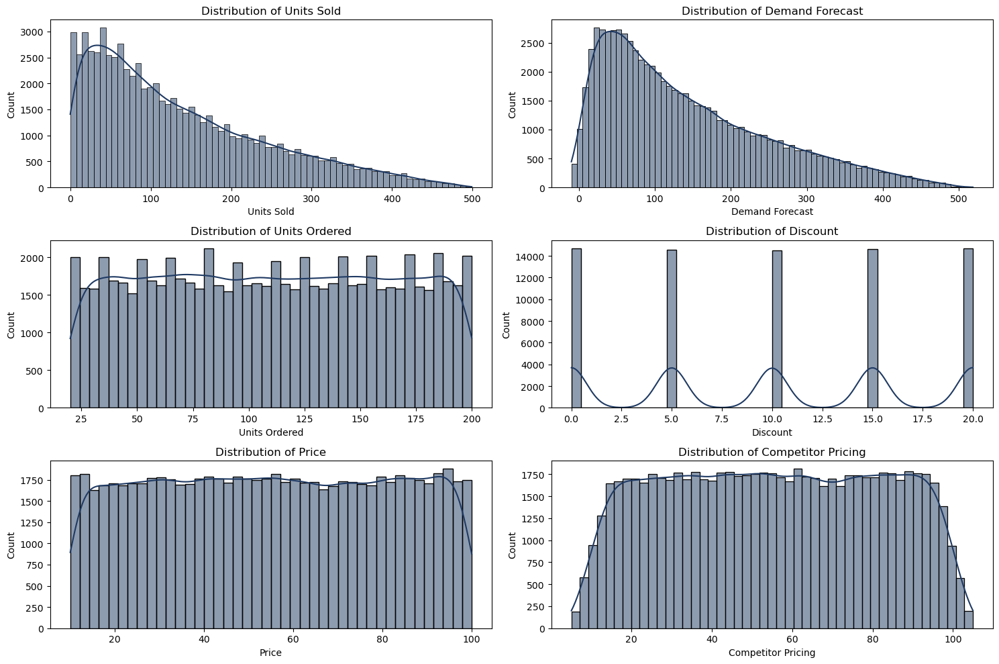

In [27]:
num_cols = ['Units Sold','Demand Forecast', 'Units Ordered', 'Discount', 'Price', 'Competitor Pricing']

for i, col in enumerate(num_cols):
  plt.subplot(3,2,i+1)
  sns.histplot(x = df[col], color = "#1F3A63", kde = True)
  plt.title(f'Distribution of {col}')
  plt.tight_layout()

plt.show()

- <span style="font-family: 'Consolas';"><span style="color:limegreen"> Although Discount is not a continuous variable and typically takes on discrete values (e.g., 5%, 10%, 15%), it inherently represents a quantitative measure of price reduction. Treating it as a numerical feature allows the model to learn gradual effects of discount levels on stockout risk, capturing potential linear or non-linear trends without artificially segmenting the data.<br><br>
Additionally, one-hot encoding discount levels as categories could lead to sparsity and loss of ordinal meaning, especially if new discount values appear in future data. By retaining it as a numerical variable, we preserve its scale, interpretability, and ensure better generalization in predictive modeling.<br><br>
- <span style="font-family: 'Consolas';"><span style="color:limegreen">Demand Forecast cannot be negative, so replacing the negative values with zero

In [29]:
df['Demand Forecast'] = df['Demand Forecast'].apply(lambda x: 0 if x < 0 else x)

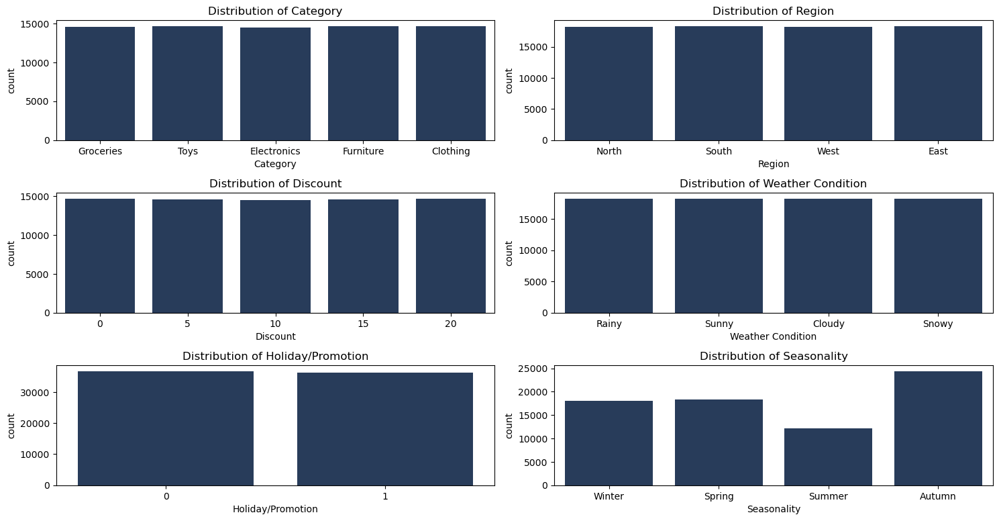

In [30]:
cat_cols = ['Category','Region', 'Discount', 'Weather Condition', 'Holiday/Promotion', 'Seasonality']

for i, col in enumerate(cat_cols):
  plt.subplot(4,2,i+1)
  sns.countplot(x = df[col], color = "#1F3A63")
  plt.title(f'Distribution of {col}')
  plt.tight_layout()

plt.show()

<span style="font-family: 'Consolas';"><span style="color:magenta">
NEW FEATURES ADDITION

In [32]:
#Month already added above

#Relative Price Difference
df['Relative Price Difference'] = df['Price']/df['Competitor Pricing']

#Demand-Supply Gap
df['Demand-Supply Gap'] = df['Demand Forecast'] - df['Inventory Level']

# Sales Velocity
df['Sales Velocity'] = df['Units Sold'] / (df['Inventory Level'].replace(0,1))  # avoid division by zero

df.head()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Month,Seasonality,Stockout Risk,Relative Price Difference,Demand-Supply Gap,Sales Velocity
0,2022-01-01,S001,P0001,Groceries,North,231,127,55,135.47,33.50,20,Rainy,0,29.69,Jan,Winter,No,1.128326,-95.53,0.549784
1,2022-01-01,S001,P0002,Toys,South,204,150,66,144.04,63.01,20,Sunny,0,66.16,Jan,Winter,No,0.952388,-59.96,0.735294
2,2022-01-01,S001,P0003,Toys,West,102,65,51,74.02,27.99,10,Sunny,1,31.32,Jan,Winter,Yes,0.893678,-27.98,0.637255
3,2022-01-01,S001,P0004,Toys,North,469,61,164,62.18,32.72,10,Cloudy,1,34.74,Jan,Winter,No,0.941854,-406.82,0.130064
4,2022-01-01,S001,P0005,Electronics,East,166,14,135,9.26,73.64,0,Sunny,0,68.95,Jan,Winter,No,1.068020,-156.74,0.084337


<span style="font-family: 'Consolas';"><span style="color:limegreen">
Inventory Level can be dropped becuase it can bias model

In [34]:
df = df.drop('Inventory Level', axis = 1)

<span style="font-family: 'Consolas';"><span style="color:limegreen">
Date, Store ID, Product ID :  These identifier features that do not carry predictive power and can introduce data leakage or model overfitting

In [36]:
df = df.drop(['Date','Store ID', 'Product ID'], axis = 1)

<span style="font-family: 'Consolas';"><span style="color:magenta">
UNIVARIATE ANALYSIS OF NEW FEATURES

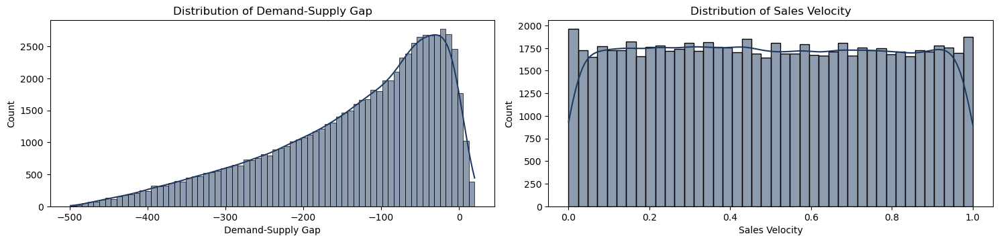

In [38]:
num_cols = ['Demand-Supply Gap', 'Sales Velocity']

for i, col in enumerate(num_cols):
  plt.subplot(3,2,i+1)
  sns.histplot(x = df[col], color = "#1F3A63", kde = True)
  plt.title(f'Distribution of {col}')
  plt.tight_layout()


plt.show()

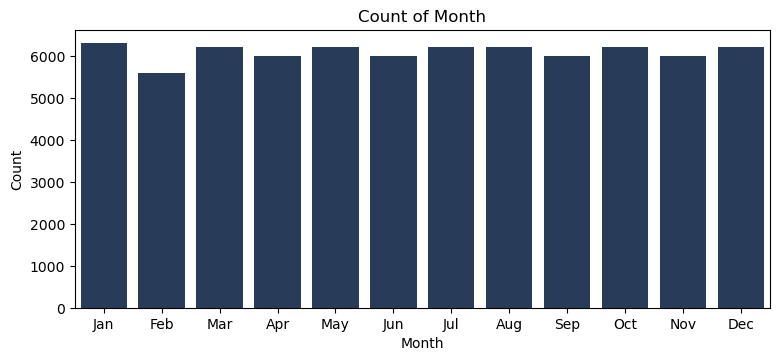

In [39]:
cat_cols = ['Month']

for i, col in enumerate(cat_cols):
    plt.subplot(3, 2, i + 1)
    ax = sns.countplot(data=df, x=col, color="#1F3A63")
    plt.title(f'Count of {col}')
    plt.xlabel(col)
    plt.ylabel("Count")


plt.tight_layout()
plt.show()


<span style="font-family: 'Consolas';"><span style="color:magenta">
BIVARIATE ANALYSIS

<span style="font-family: 'Consolas';"><span style="color:magenta">
NUMERICAL VS TARGET(CATEGORICAL)

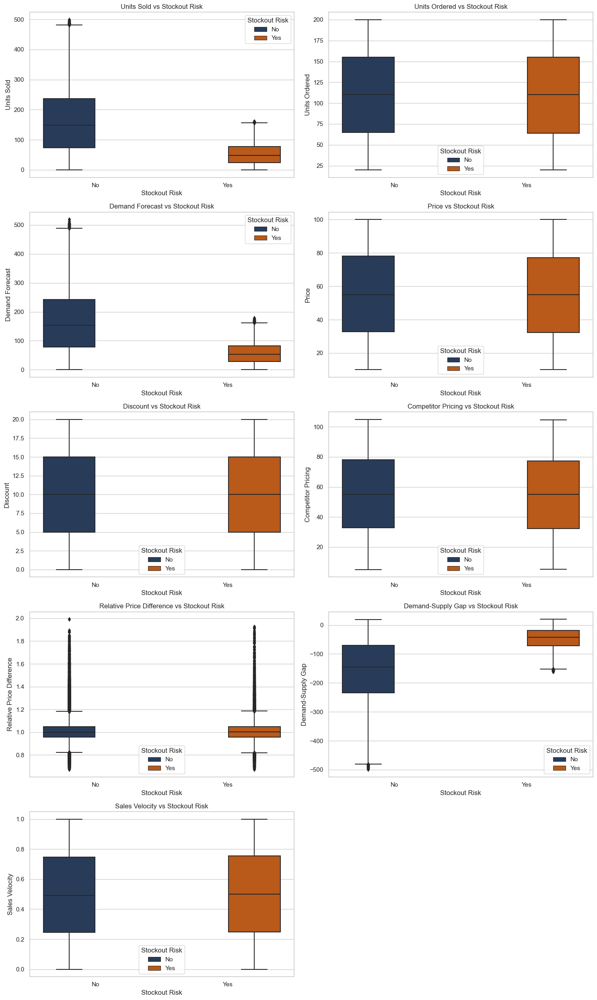

In [42]:
sns.set(style='whitegrid')

numerical_features = df.select_dtypes(np.number).columns.to_list()

stockout_palette = {'No': "#1F3A63", 'Yes': "#D35400"}

plots_per_row = 2
num_features = len(numerical_features)
num_rows = int(np.ceil(num_features / plots_per_row))

fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for i, feature in enumerate(numerical_features):
    sns.boxplot(x='Stockout Risk', y=feature, hue='Stockout Risk',
                data=df, palette=stockout_palette, ax=axes[i])
    axes[i].set_title(f'{feature} vs Stockout Risk')

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

<span style="font-family: 'Consolas';"><span style="color:magenta">
CATEGORICAL VS TARGET(CATEGORICAL)

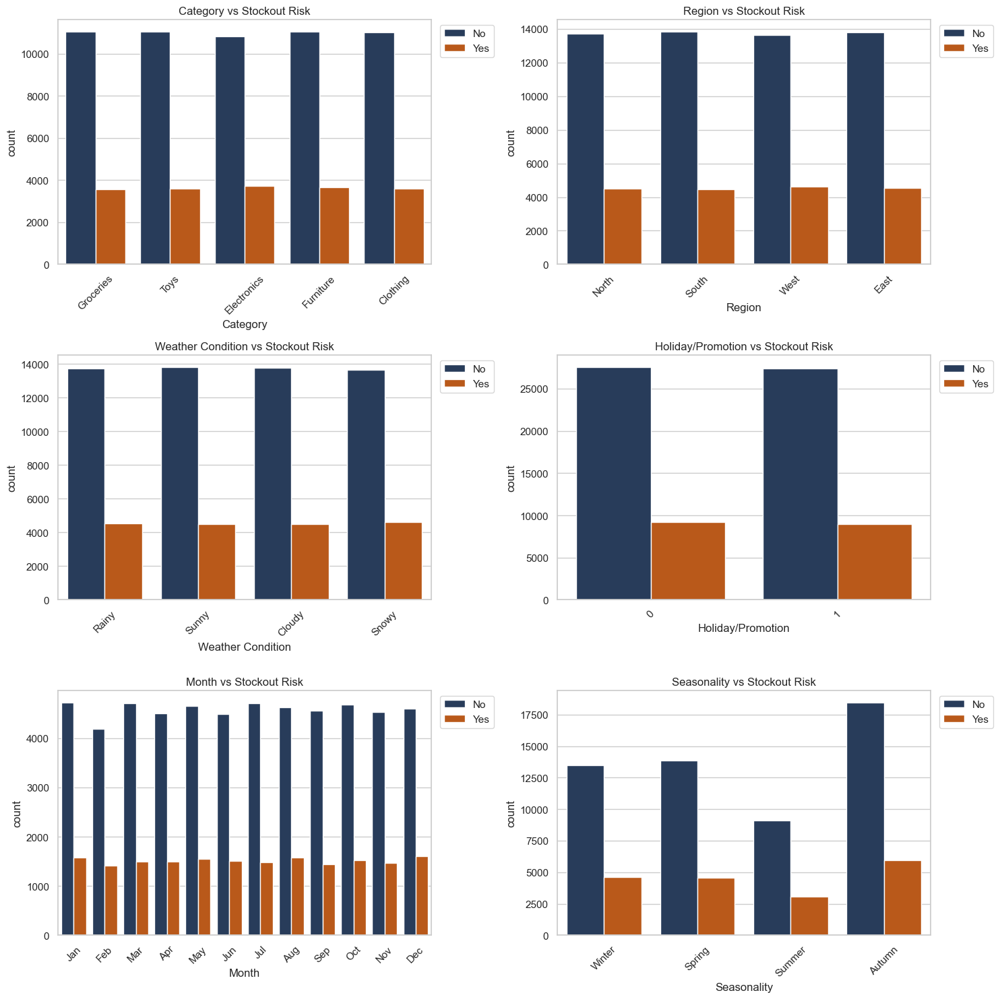

In [44]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

sns.set(style='whitegrid')

df_cat = df.select_dtypes(object).drop(columns=['Stockout Risk'])

features = df_cat.columns
plots_per_row = 2
num_features = len(features)
num_rows = int(np.ceil(num_features / plots_per_row))

fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(15, 5 * num_rows))
axes = axes.flatten()

for i, feature in enumerate(features):
    sns.countplot(x=feature, hue='Stockout Risk', data=df,
                  palette={'No': "#1F3A63", 'Yes': "#D35400"}, ax=axes[i])
    axes[i].set_title(f'{feature} vs Stockout Risk')
    axes[i].tick_params(axis='x', rotation=45)
    axes[i].legend(loc='upper left', bbox_to_anchor=(1.01, 1))

for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

<span style="font-family: 'Consolas';"><span style="color:magenta">
NUMERICAL FEATURE VS NUMERICAL FEATURE

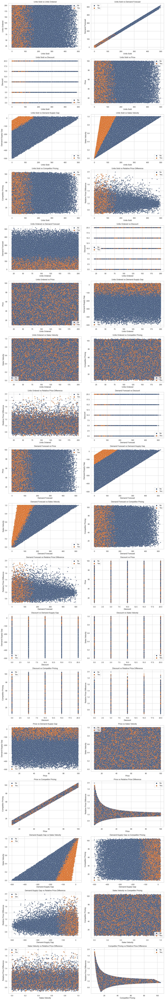

In [48]:
numerical_features = ['Units Sold', 'Units Ordered', 'Demand Forecast', 'Discount', 'Price', 'Demand-Supply Gap', 
                      'Sales Velocity', 'Competitor Pricing', 'Relative Price Difference']

feature_pairs = list(combinations(numerical_features, 2))

stockout_palette = {'No': "#1F3A63", 'Yes': "#D35400"}


plots_per_row = 2
num_plots = len(feature_pairs)
num_rows = int(np.ceil(num_plots / plots_per_row))

plt.figure(figsize=(15, 5 * num_rows))
sns.set(style="whitegrid")


for i, (x_feature, y_feature) in enumerate(feature_pairs):
    plt.subplot(num_rows, plots_per_row, i + 1)
    sns.scatterplot(data=df, x=x_feature, y=y_feature, hue='Stockout Risk', palette=stockout_palette, alpha=0.6)
    plt.title(f'{x_feature} vs {y_feature}')
    plt.legend(loc='best')

plt.tight_layout()
plt.show()

<span style="font-family: 'Consolas';"><span style="color:magenta">
MULTIVARIATE ANALYSIS

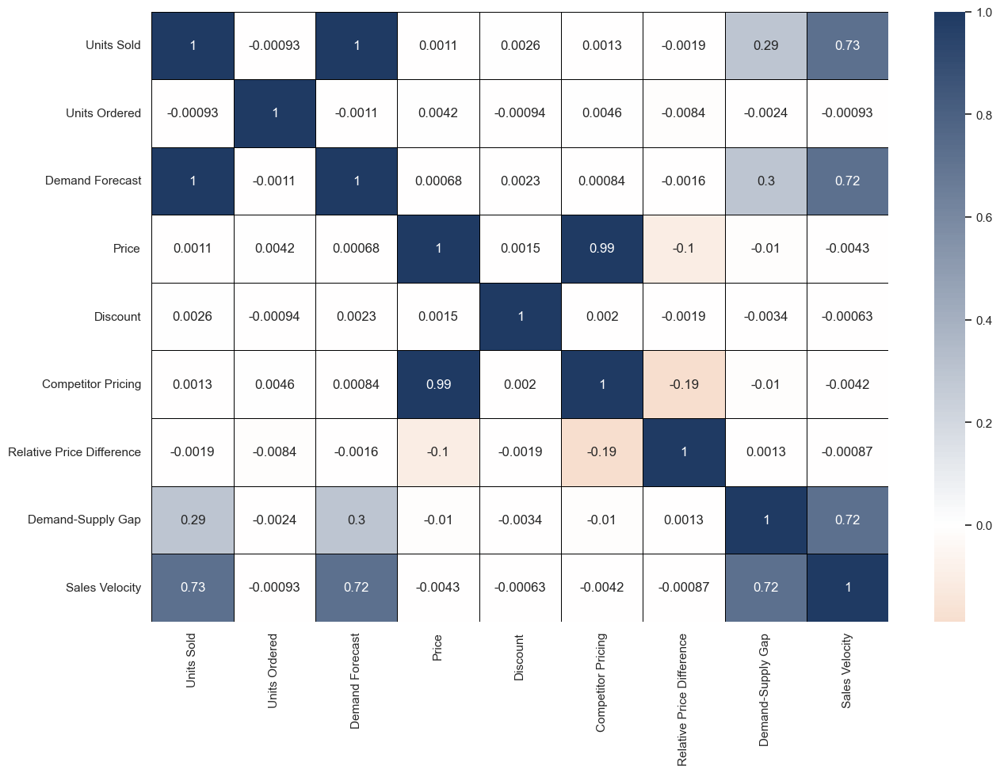

In [58]:
df_num = df.select_dtypes(include=np.number)


custom_cmap = LinearSegmentedColormap.from_list("custom_cmap", ["#D35400", "white", "#1F3A63"])


sns.heatmap(
    df_num.corr(),
    annot=True,
    cmap=custom_cmap,
    center=0,
    linewidths=0.5,  
    linecolor='black'
)

plt.show()


<span style="font-family:'Consolas';color:limegreen">During feature selection, we observed significant multicollinearity among several pairs of features:

- <span style="font-family:'Consolas';color:limegreen">Price & Competitor Pricing

- <span style="font-family:'Consolas';color:limegreen">Units Sold & Sales Velocity

- <span style="font-family:'Consolas';color:limegreen">Demand Forecast & Sales Velocity

- <span style="font-family:'Consolas';color:limegreen">Demand-Supply Gap & Sales Velocity

<span style="font-family:'Consolas';color:limegreen">To address this and avoid redundancy, the following decisions were made:

- <span style="font-family:'Consolas';color:limegreen">Price and Competitor Pricing were removed, as their relationship is already captured by the derived feature Relative Price Difference, which provides a more meaningful and scaled representation.

- <span style="font-family:'Consolas';color:limegreen">Units Sold and Demand Forecast were also excluded because their influence is already embedded in derived features such as Sales Velocity and Demand-Supply Gap, which better capture real-time stock movement and supply-demand imbalance.
- <span style="font-family:'Consolas';color:limegreen">Although Sales Velocity and Demand-Supply Gap exhibit moderate multicollinearity (correlation = 0.72), both features were retained in the final model due to their distinct operational interpretations and complementary predictive power.

    - <span style="font-family:'Consolas';color:limegreen">Sales Velocity captures the pace at which inventory is consumed relative to time, reflecting product movement efficiency.

    - <span style="font-family:'Consolas';color:limegreen">Demand-Supply Gap directly quantifies the mismatch between forecasted demand and available supply, a key driver of stockouts.

<span style="font-family:'Consolas';color:limegreen">
Retaining both features allowed the model to learn from different dimensions of inventory dynamics, contributing to higher recall and overall performance. Feature importance analysis and model validation confirmed that both variables added value without causing instability or overfitting.

In [61]:
df = df.drop(['Units Sold', 'Demand Forecast', 'Price', 'Competitor Pricing'], axis = 1)

In [63]:
target = 'Stockout Risk'

# Encode target if it's categorical (like "Low", "High")
if df[target].dtype == 'object':
    df[target] = LabelEncoder().fit_transform(df[target])  # 0 = Low, 1 = High

results = []

for col in df.columns:
    if col == target:
        continue

    try:
        if df[col].dtype in ['int64', 'float64']:  # Numerical feature
            # Use Mann-Whitney U test (non-parametric test for 2 independent samples)
            group0 = df[df[target] == 0][col]
            group1 = df[df[target] == 1][col]
            stat, p = stats.mannwhitneyu(group0, group1, alternative='two-sided')
            test_name = 'Mann-Whitney U'

        elif df[col].dtype == 'object' or df[col].nunique() < 10:  # Categorical feature
            # Use Chi-square test
            contingency = pd.crosstab(df[col], df[target])
            stat, p, _, _ = stats.chi2_contingency(contingency)
            test_name = 'Chi-square'

        else:
            continue

        results.append({
            'Feature': col,
            'Test': test_name,
            'P-Value': p,
            'Statistically Significant': p < 0.05
        })

    except Exception as e:
        print(f"Skipping {col} due to error: {e}")

# Show results
results_df = pd.DataFrame(results).sort_values(by='P-Value')
results_df

,Feature,Test,P-Value,Statistically Significant
9,Demand-Supply Gap,Mann-Whitney U,0.000000,True
10,Sales Velocity,Mann-Whitney U,0.024511,True
7,Seasonality,Chi-square,0.045980,True
3,Discount,Mann-Whitney U,0.056357,False
0,Category,Chi-square,0.196718,False
1,Region,Chi-square,0.199971,False
4,Weather Condition,Chi-square,0.241257,False
6,Month,Chi-square,0.335071,False
5,Holiday/Promotion,Chi-square,0.340747,False
2,Units Ordered,Mann-Whitney U,0.971854,False


<span style="font-family: 'Consolas';"><span style="color:magenta">
VIF

In [66]:
df_vif = df.select_dtypes(np.number)

df_vif = add_constant(df_vif)  # Add intercept term
vif_data = pd.DataFrame()
vif_data["Feature"] = df_vif.columns
vif_data["VIF"] = [variance_inflation_factor(df_vif.values, i) for i in range(df_vif.shape[1])]
vif_data.sort_values(by = 'VIF',ascending = False)

,Feature,VIF
0,const,140.046926
5,Demand-Supply Gap,3.545988
6,Sales Velocity,2.841434
3,Stockout Risk,1.685941
4,Relative Price Difference,1.000089
1,Units Ordered,1.000083
2,Discount,1.000055


<span style="font-family: 'Consolas';"><span style="color:magenta">
ENCODING

In [69]:
df['Month'] = df['Month'].map({'Jan' : 1,
                               'Feb' : 2,
                               'Mar' : 3,
                               'Apr' : 4,
                               'May' : 5,
                               'Jun' : 6,
                               'Jul' : 7,
                               'Aug' : 8,
                               'Sep' : 9,
                               'Oct' : 10,
                               'Nov' : 11,
                               'Dec' : 12})

In [71]:
df_cat=df.select_dtypes(include='object').drop(['Holiday/Promotion'],axis=1)
df_cat.head()

,Category,Region,Weather Condition,Seasonality
0,Groceries,North,Rainy,Winter
1,Toys,South,Sunny,Winter
2,Toys,West,Sunny,Winter
3,Toys,North,Cloudy,Winter
4,Electronics,East,Sunny,Winter


In [73]:
categorical_cols = ['Category', 'Region', 'Weather Condition', 'Seasonality']

encoder = OneHotEncoder(drop='first', sparse_output=False)

encoded_array = encoder.fit_transform(df[categorical_cols])

encoded_col_names = encoder.get_feature_names_out(categorical_cols)

df_encoded = pd.DataFrame(encoded_array, columns=encoded_col_names, index=df.index)

df = pd.concat([df.drop(columns=categorical_cols), df_encoded], axis=1)
df.head()

,Units Ordered,Discount,Holiday/Promotion,Month,Stockout Risk,Relative Price Difference,Demand-Supply Gap,Sales Velocity,Category_Electronics,Category_Furniture,Category_Groceries,Category_Toys,Region_North,Region_South,Region_West,Weather Condition_Rainy,Weather Condition_Snowy,Weather Condition_Sunny,Seasonality_Spring,Seasonality_Summer,Seasonality_Winter
0,55,20,0,1,0,1.128326,-95.53,0.549784,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1,66,20,0,1,0,0.952388,-59.96,0.735294,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
2,51,10,1,1,1,0.893678,-27.98,0.637255,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
3,164,10,1,1,0,0.941854,-406.82,0.130064,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,135,0,0,1,0,1.068020,-156.74,0.084337,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


<span style="font-family: 'Consolas';"><span style="color:magenta">
TRAIN-TEST SPLIT

In [76]:
X=df.drop('Stockout Risk',axis=1)
y=df['Stockout Risk']
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.3,random_state=42)
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

<IPython.core.display.Javascript object>

(51170, 20)
(21930, 20)
(51170,)
(21930,)


In [78]:
col = ['Units Ordered', 'Discount', 'Relative Price Difference', 'Demand-Supply Gap', 'Sales Velocity']
X_train[col].skew()

Units Ordered                0.006623
Discount                     0.001307
Relative Price Difference    1.866781
Demand-Supply Gap           -0.881969
Sales Velocity               0.010696
dtype: float64

<span style="font-family: 'Consolas';"><span style="color:magenta">
TRANSFORMATION

In [81]:
pt = PowerTransformer(method='yeo-johnson')  # Works with negative & zero values
X_train[['Relative Price Difference']] = pt.fit_transform(X_train[['Relative Price Difference']])
X_test[['Relative Price Difference']] = pt.transform(X_test[['Relative Price Difference']])

train_skewness = X_train['Relative Price Difference'].skew()
test_skewness = X_test['Relative Price Difference'].skew()

print(f'Skewness of Relative Price Diff in training set : {train_skewness:.2f}')
print(f'Skewness of Relative Price Diff in test set : {test_skewness:.2f}')

pt = PowerTransformer(method='yeo-johnson')  # Works with negative & zero values
X_train[['Demand-Supply Gap']] = pt.fit_transform(X_train[['Demand-Supply Gap']])
X_test[['Demand-Supply Gap']] = pt.transform(X_test[['Demand-Supply Gap']])

train_skewness = X_train['Demand-Supply Gap'].skew()
test_skewness = X_test['Demand-Supply Gap'].skew()

print(f'Skewness of Demand-Supply Gap in training set : {train_skewness:.2f}')
print(f'Skewness of Demand-Supply Gap in test set : {test_skewness:.2f}')

Skewness of Relative Price Diff in training set : -0.18
Skewness of Relative Price Diff in test set : -0.18
Skewness of Demand-Supply Gap in training set : -0.07
Skewness of Demand-Supply Gap in test set : -0.07


<span style="font-family: 'Consolas';"><span style="color:magenta">
SCALING

In [84]:
features_to_scale = ['Units Ordered', 'Discount', 'Month', 
                     'Relative Price Difference', 'Demand-Supply Gap', 'Sales Velocity']

scaler = StandardScaler()

X_train[features_to_scale] = scaler.fit_transform(X_train[features_to_scale])

X_test[features_to_scale] = scaler.transform(X_test[features_to_scale])

X_train.head()

<IPython.core.display.Javascript object>

,Units Ordered,Discount,Holiday/Promotion,Month,Relative Price Difference,Demand-Supply Gap,Sales Velocity,Category_Electronics,Category_Furniture,Category_Groceries,Category_Toys,Region_North,Region_South,Region_West,Weather Condition_Rainy,Weather Condition_Snowy,Weather Condition_Sunny,Seasonality_Spring,Seasonality_Summer,Seasonality_Winter
61925,-1.623187,0.705227,0,0.722620,-0.545726,-0.918131,-1.050346,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
36316,1.628472,-1.407564,1,1.593569,0.150564,1.080966,0.753788,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
29247,1.456325,-1.407564,0,1.012936,0.619556,-0.576784,-0.275812,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
40876,-1.336276,0.705227,0,-1.309596,-0.988406,-0.309160,-1.469904,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
36711,-0.877218,-1.407564,1,-1.599912,0.370856,-0.135710,0.225276,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


<span style="font-family: 'Consolas';"><span style="color:magenta">
MODEL BUILDING

<span style="font-family: 'Consolas';"><span style="color:magenta">
MODEL PERFORMANCE BEFORE SMOTE

🔍 Logistic Regression
---------------------


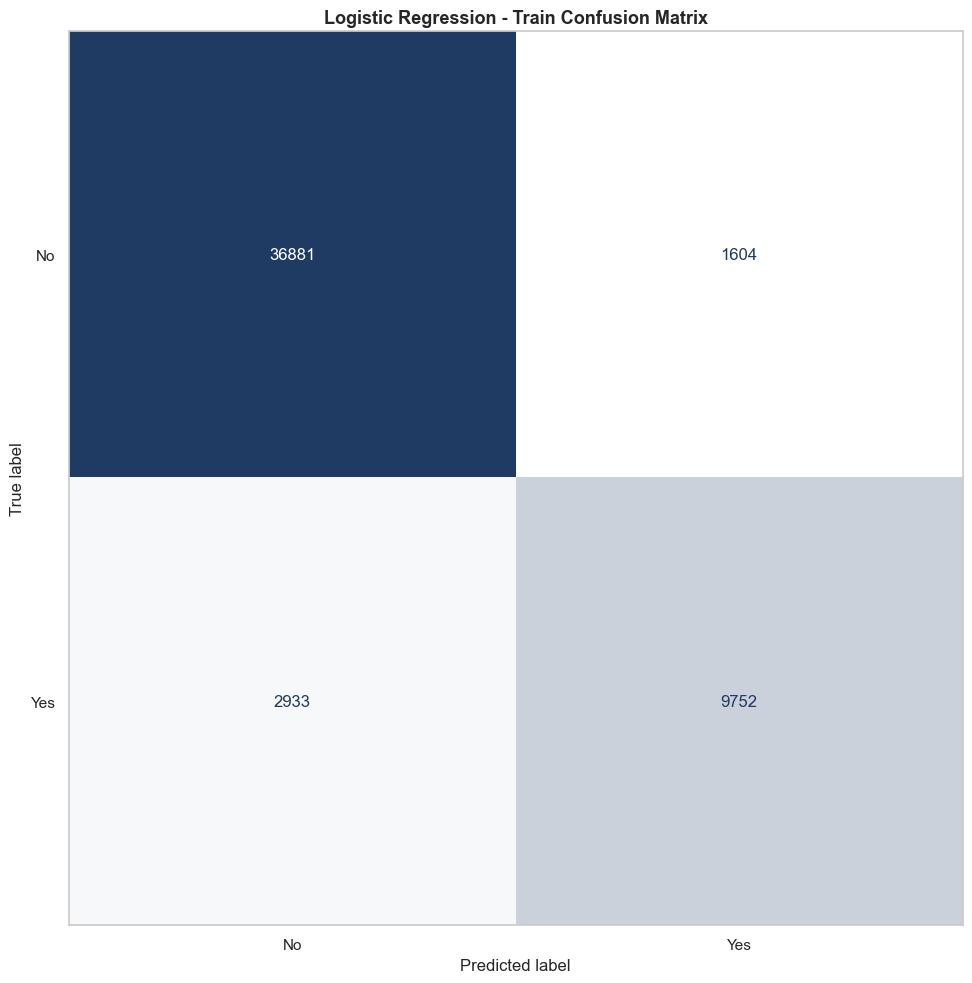

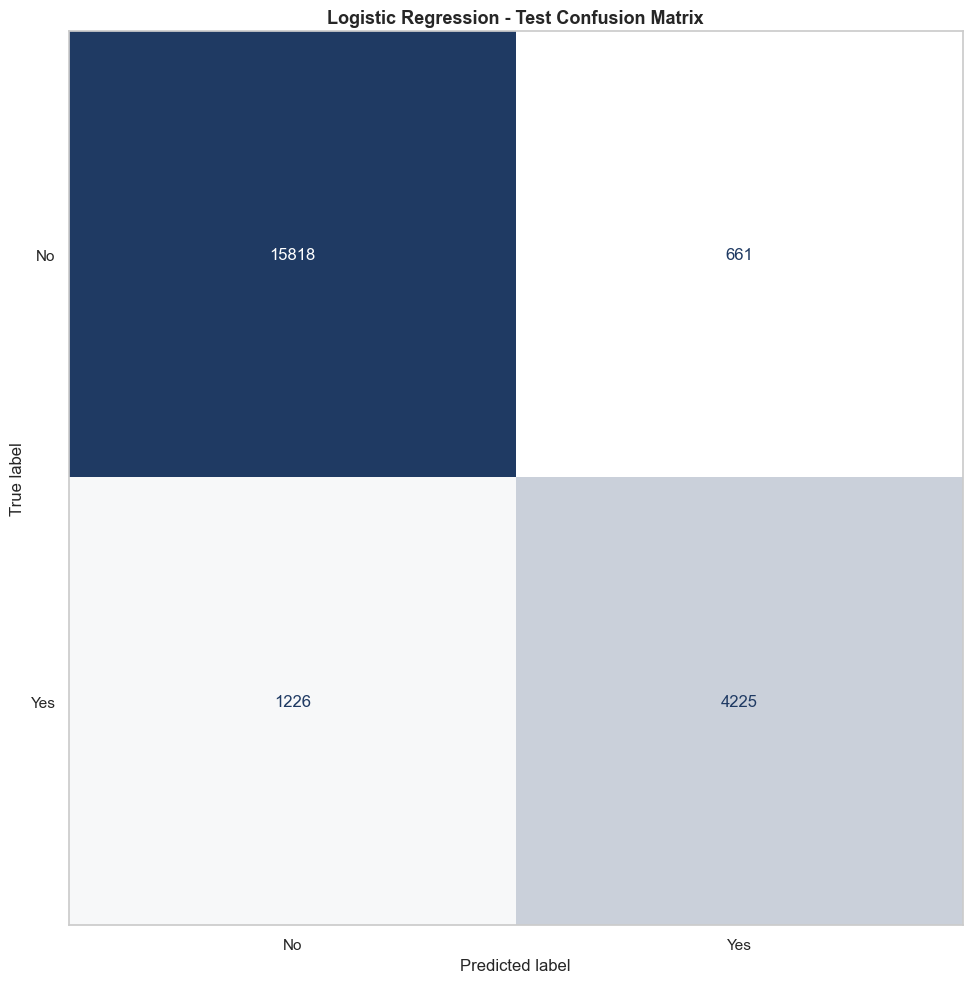

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.93      0.96      0.94     38485
           1       0.86      0.77      0.81     12685

    accuracy                           0.91     51170
   macro avg       0.89      0.86      0.88     51170
weighted avg       0.91      0.91      0.91     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.93      0.96      0.94     16479
           1       0.86      0.78      0.82      5451

    accuracy                           0.91     21930
   macro avg       0.90      0.87      0.88     21930
weighted avg       0.91      0.91      0.91     21930

ROC AUC Score (Train): 0.9662797267966896
ROC AUC Score (Test): 0.9682361307975575
------------------------------------------------------------
🔍 GaussianNB
------------


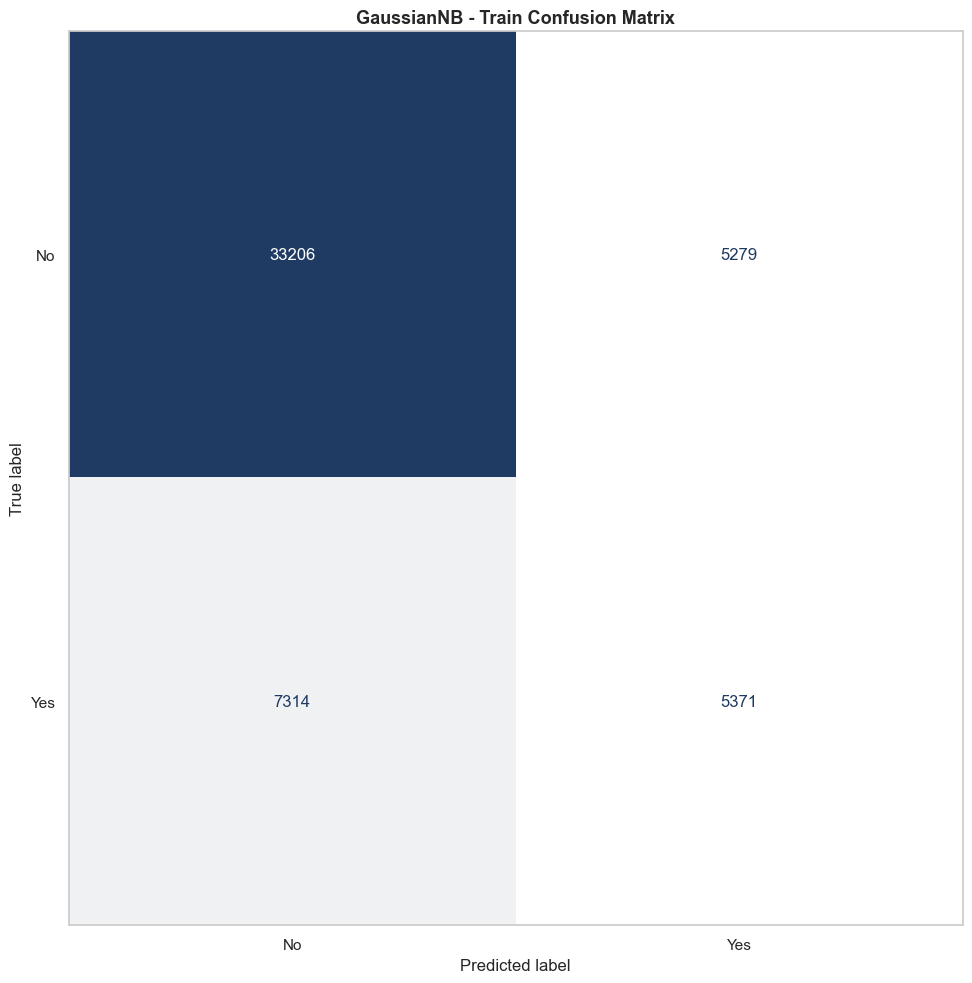

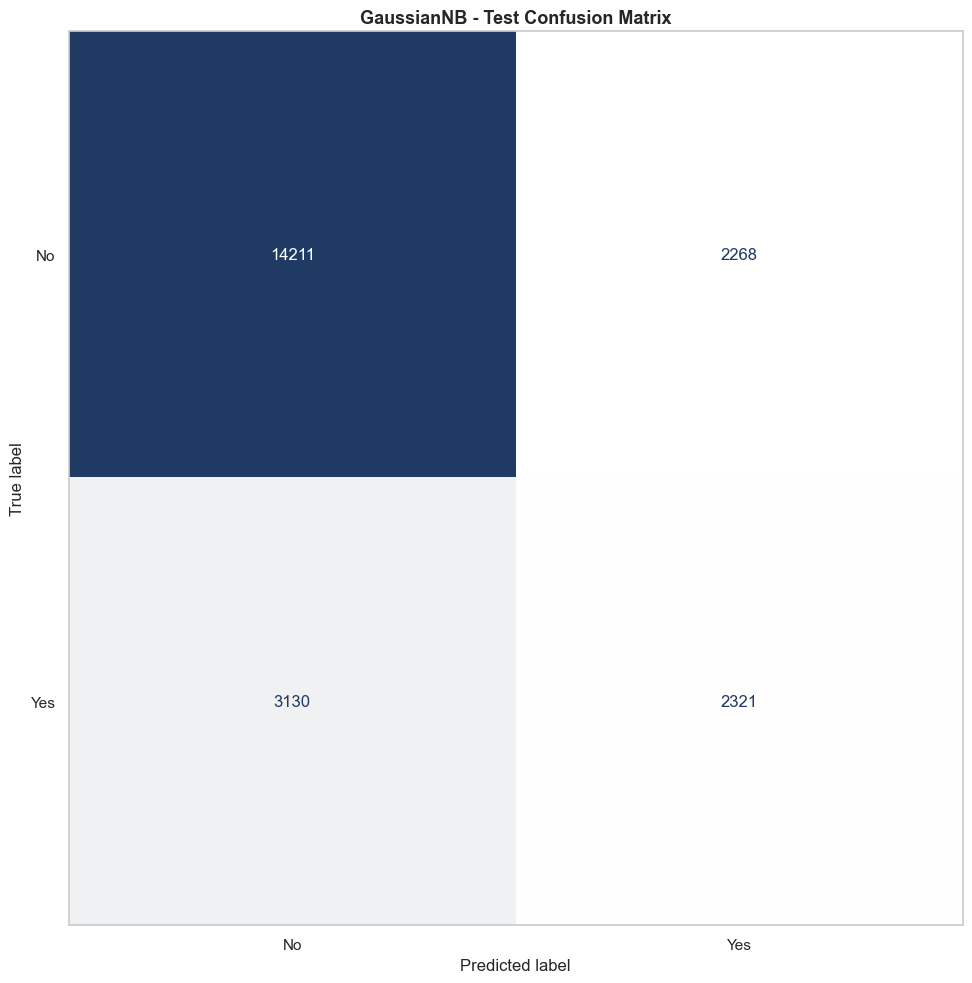

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.82      0.86      0.84     38485
           1       0.50      0.42      0.46     12685

    accuracy                           0.75     51170
   macro avg       0.66      0.64      0.65     51170
weighted avg       0.74      0.75      0.75     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.82      0.86      0.84     16479
           1       0.51      0.43      0.46      5451

    accuracy                           0.75     21930
   macro avg       0.66      0.64      0.65     21930
weighted avg       0.74      0.75      0.75     21930

ROC AUC Score (Train): 0.8174189812011283
ROC AUC Score (Test): 0.8165240998898005
------------------------------------------------------------
🔍 LinearSVC
-----------


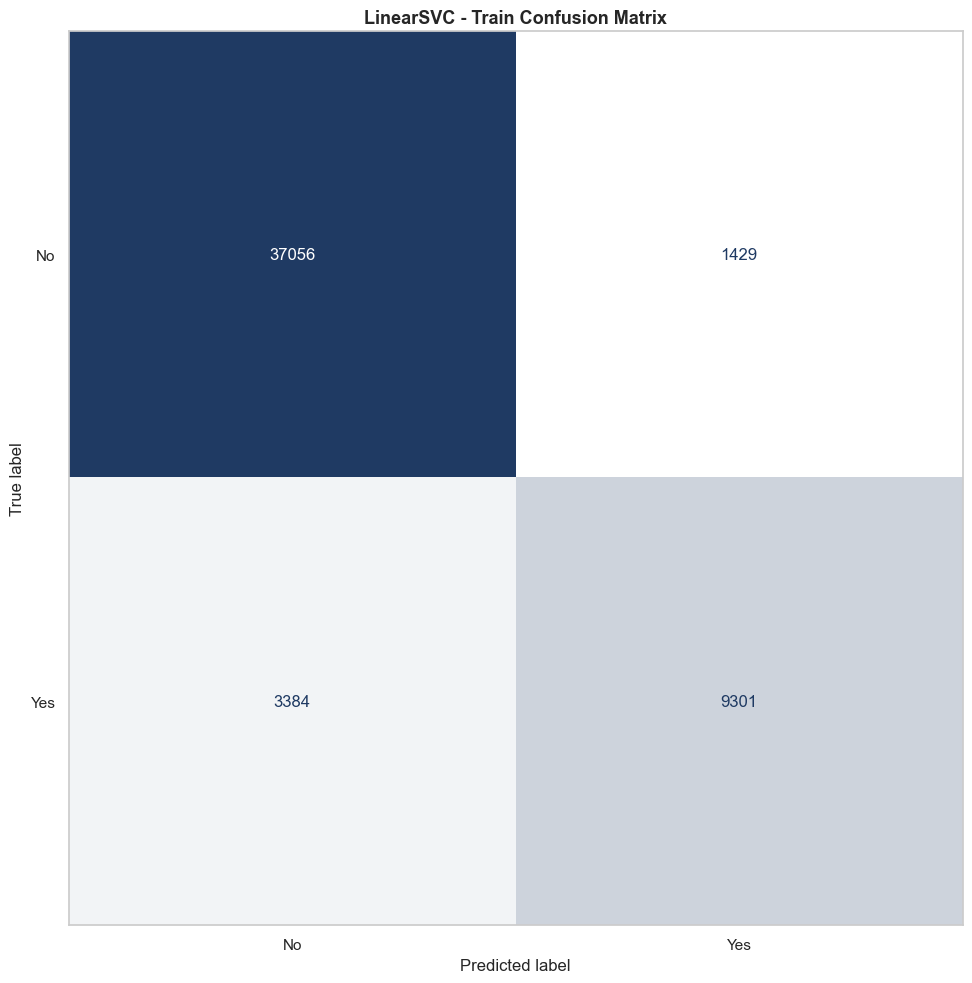

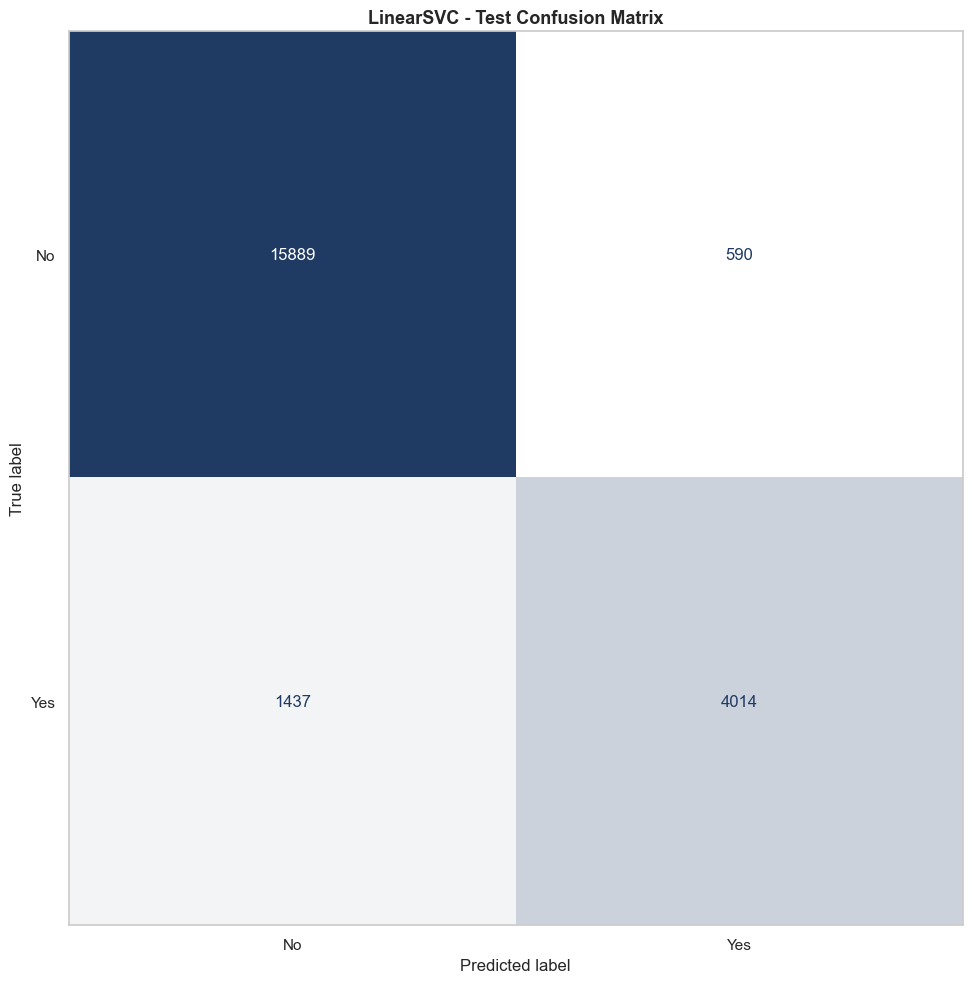

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.92      0.96      0.94     38485
           1       0.87      0.73      0.79     12685

    accuracy                           0.91     51170
   macro avg       0.89      0.85      0.87     51170
weighted avg       0.90      0.91      0.90     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.92      0.96      0.94     16479
           1       0.87      0.74      0.80      5451

    accuracy                           0.91     21930
   macro avg       0.89      0.85      0.87     21930
weighted avg       0.91      0.91      0.90     21930

ROC AUC Score (Train): 0.9646199449396177
ROC AUC Score (Test): 0.966735591355248
------------------------------------------------------------
🔍 Random Forest
---------------


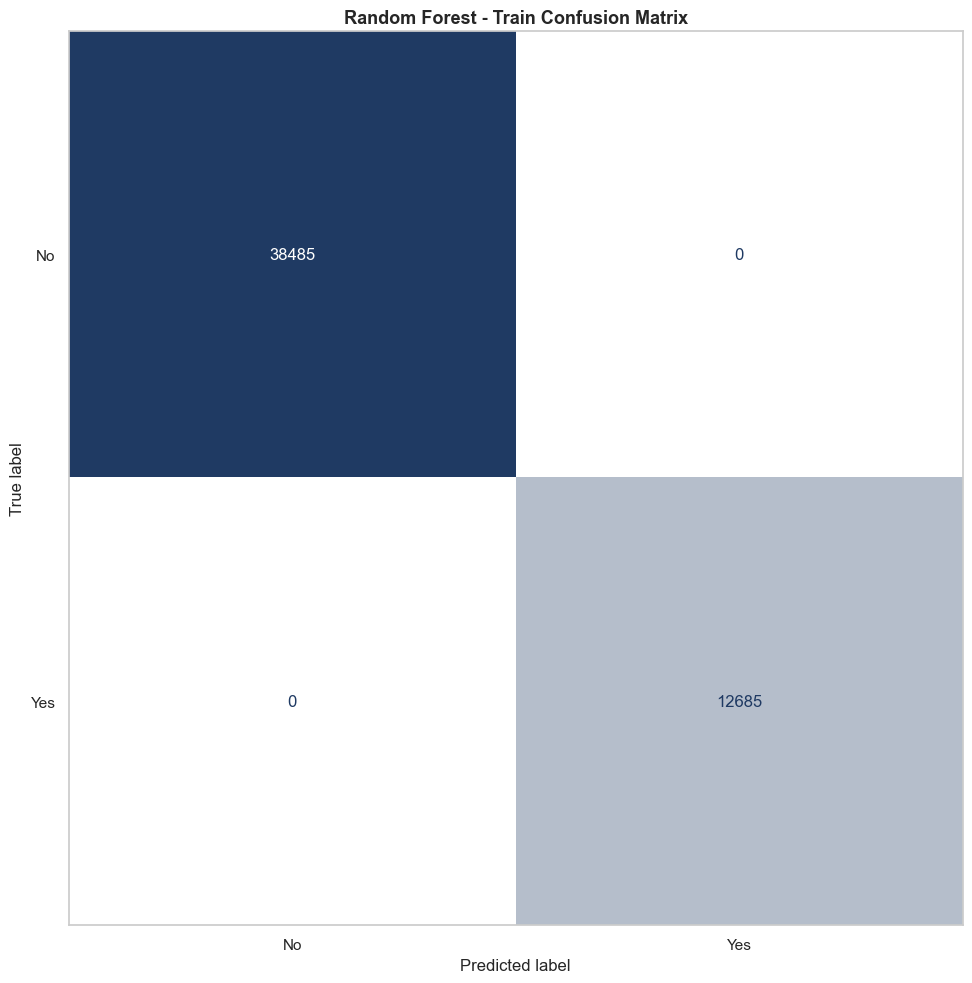

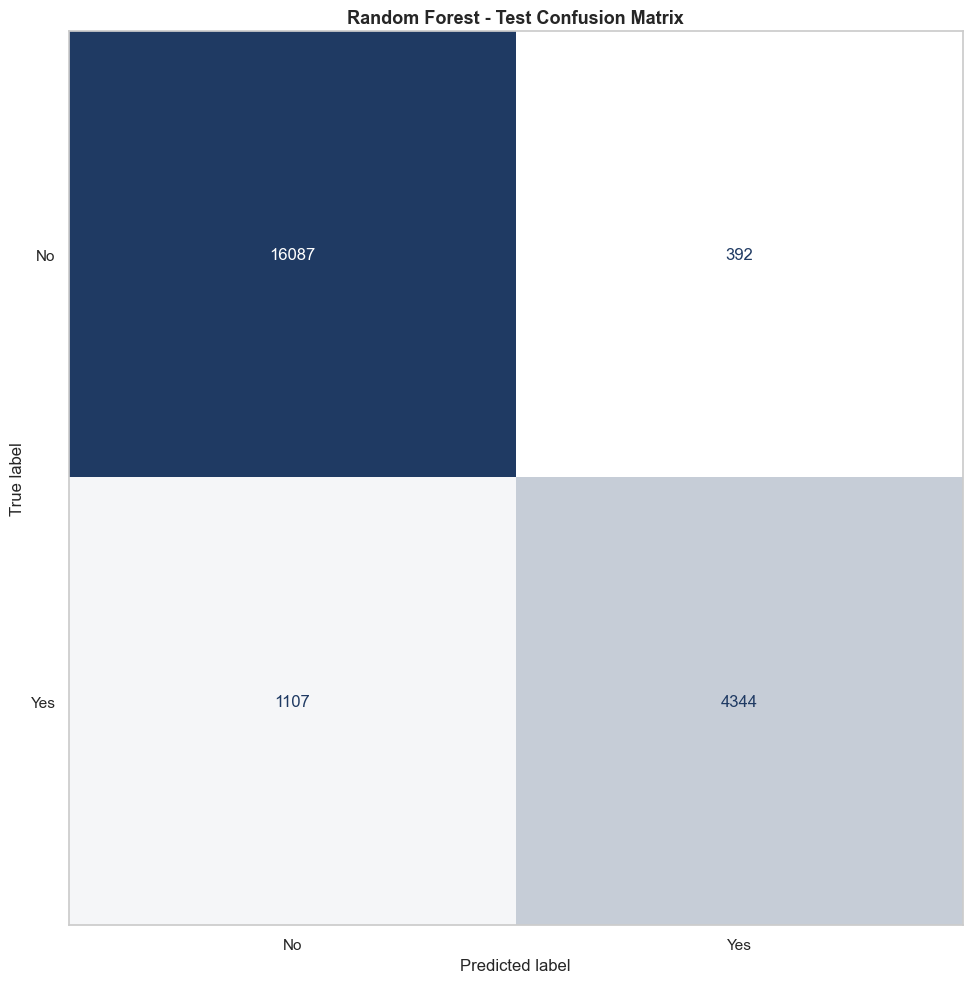

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     38485
           1       1.00      1.00      1.00     12685

    accuracy                           1.00     51170
   macro avg       1.00      1.00      1.00     51170
weighted avg       1.00      1.00      1.00     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.94      0.98      0.96     16479
           1       0.92      0.80      0.85      5451

    accuracy                           0.93     21930
   macro avg       0.93      0.89      0.90     21930
weighted avg       0.93      0.93      0.93     21930

ROC AUC Score (Train): 1.0
ROC AUC Score (Test): 0.982508605511154
------------------------------------------------------------
🔍 XGBoost
---------


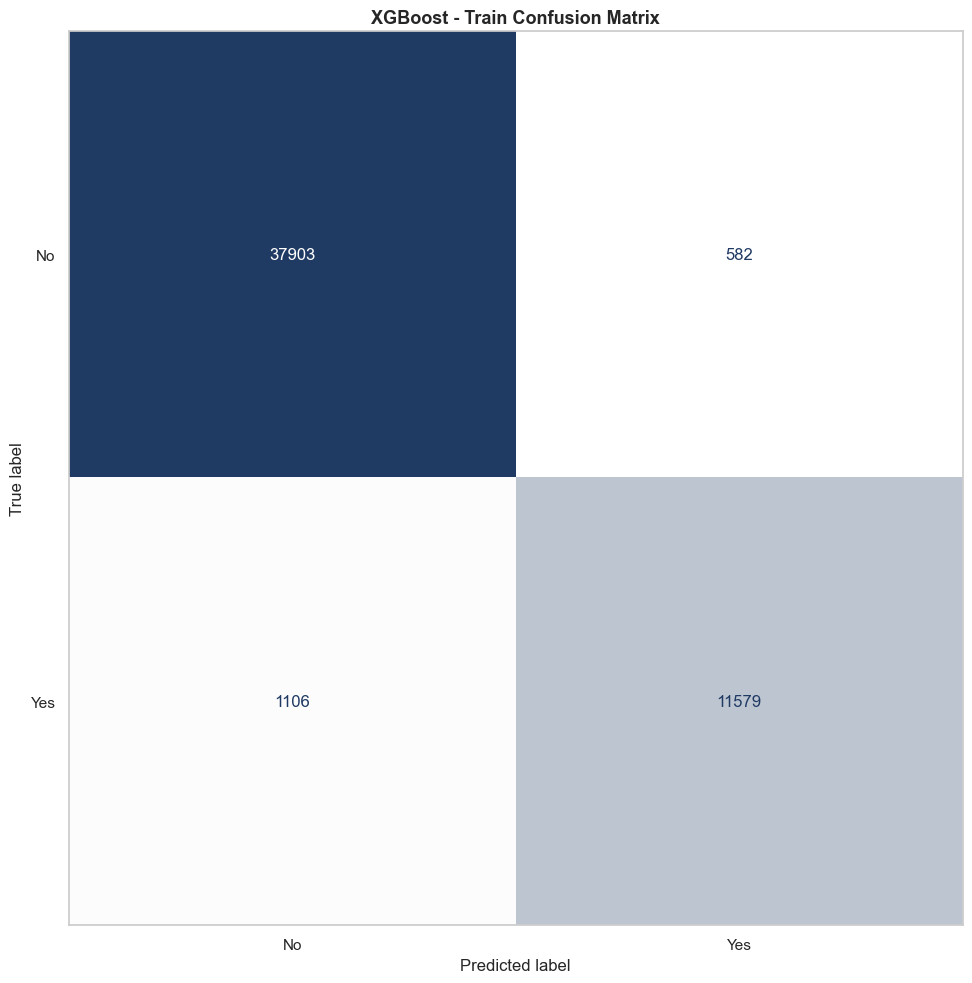

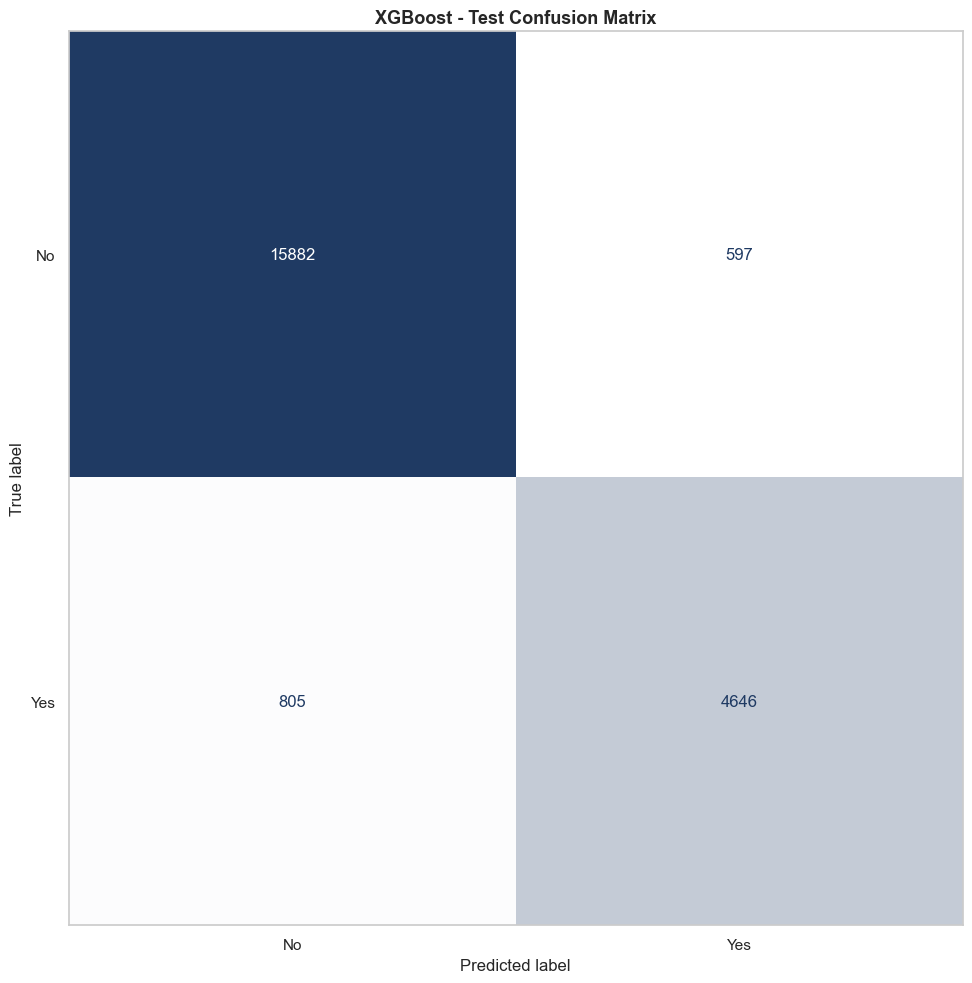

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.97      0.98      0.98     38485
           1       0.95      0.91      0.93     12685

    accuracy                           0.97     51170
   macro avg       0.96      0.95      0.96     51170
weighted avg       0.97      0.97      0.97     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.95      0.96      0.96     16479
           1       0.89      0.85      0.87      5451

    accuracy                           0.94     21930
   macro avg       0.92      0.91      0.91     21930
weighted avg       0.94      0.94      0.94     21930

ROC AUC Score (Train): 0.9956477143345398
ROC AUC Score (Test): 0.9851657010720014
------------------------------------------------------------
🔍 LightGBM
----------


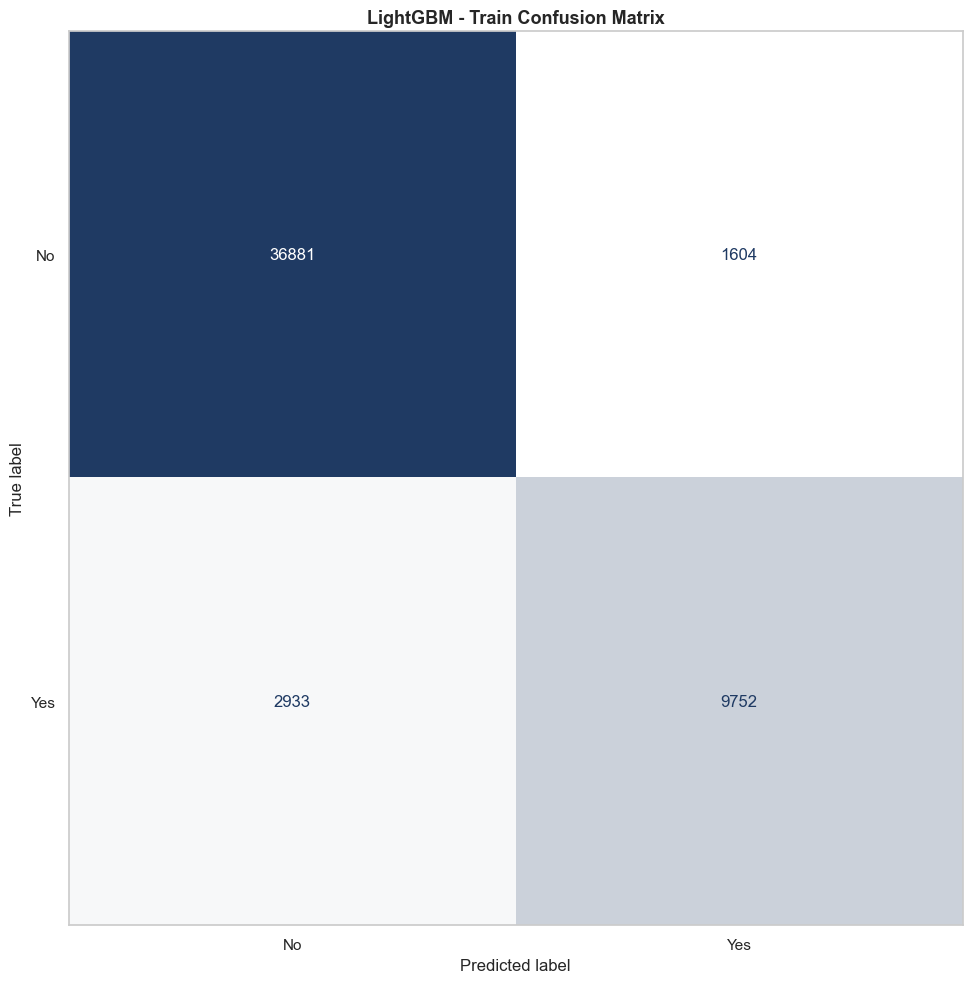

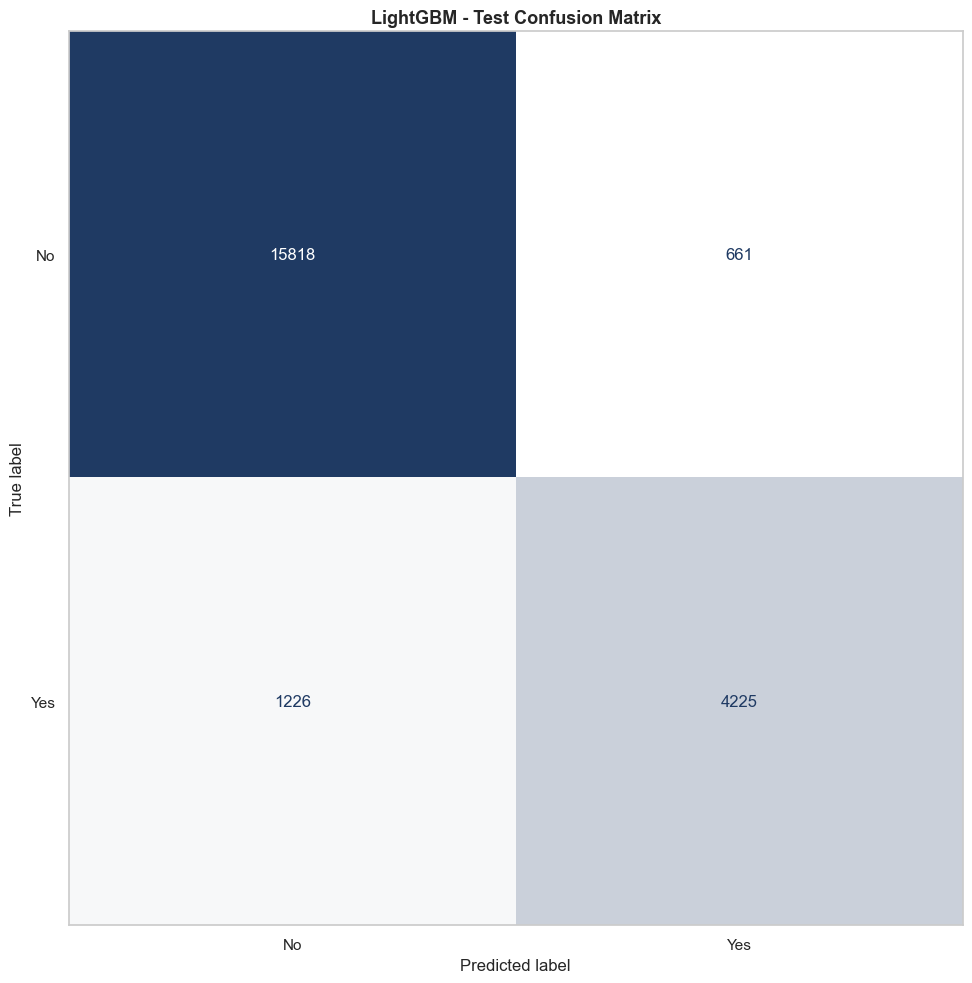

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.93      0.96      0.94     38485
           1       0.86      0.77      0.81     12685

    accuracy                           0.91     51170
   macro avg       0.89      0.86      0.88     51170
weighted avg       0.91      0.91      0.91     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.93      0.96      0.94     16479
           1       0.86      0.78      0.82      5451

    accuracy                           0.91     21930
   macro avg       0.90      0.87      0.88     21930
weighted avg       0.91      0.91      0.91     21930

ROC AUC Score (Train): 0.9662794420669454
ROC AUC Score (Test): 0.9682357300273173
------------------------------------------------------------
🔍 MLP
-----


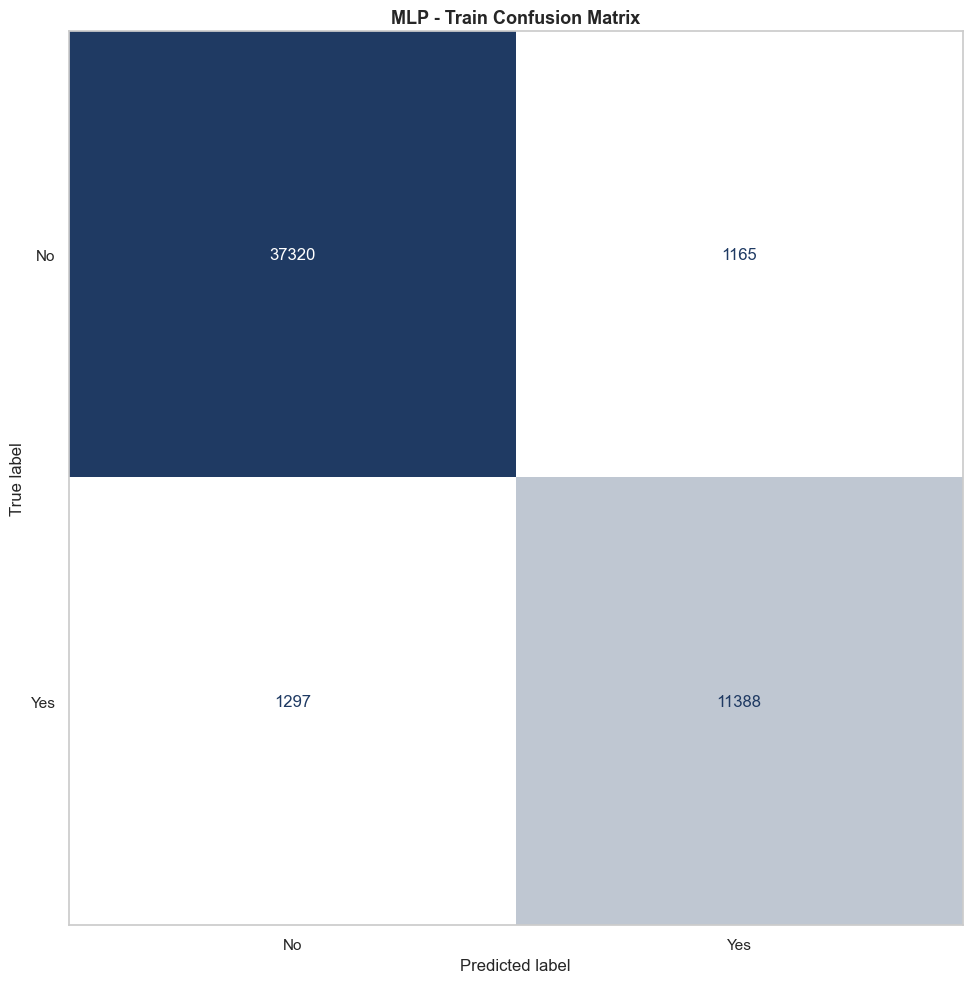

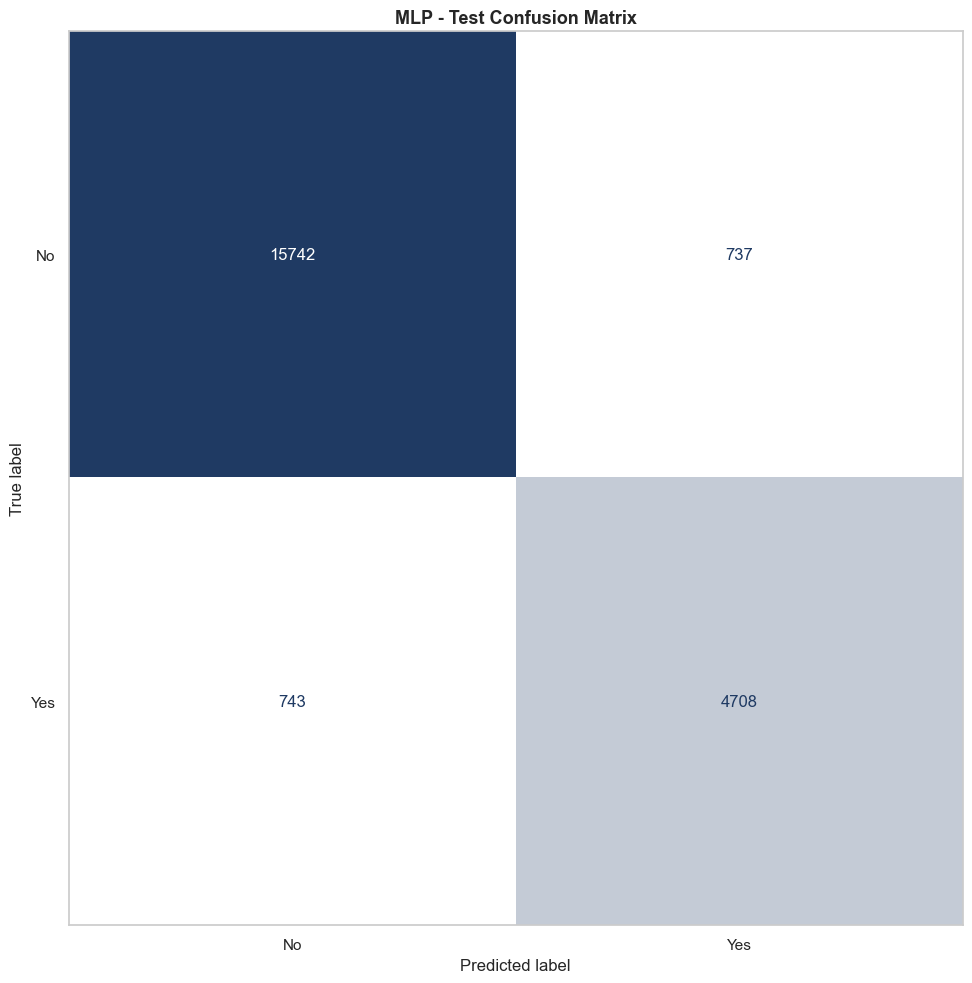

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.97      0.97      0.97     38485
           1       0.91      0.90      0.90     12685

    accuracy                           0.95     51170
   macro avg       0.94      0.93      0.94     51170
weighted avg       0.95      0.95      0.95     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.95      0.96      0.96     16479
           1       0.86      0.86      0.86      5451

    accuracy                           0.93     21930
   macro avg       0.91      0.91      0.91     21930
weighted avg       0.93      0.93      0.93     21930

ROC AUC Score (Train): 0.9910239931410857
ROC AUC Score (Test): 0.9832787411904718
------------------------------------------------------------
🔍 Decision Tree
---------------


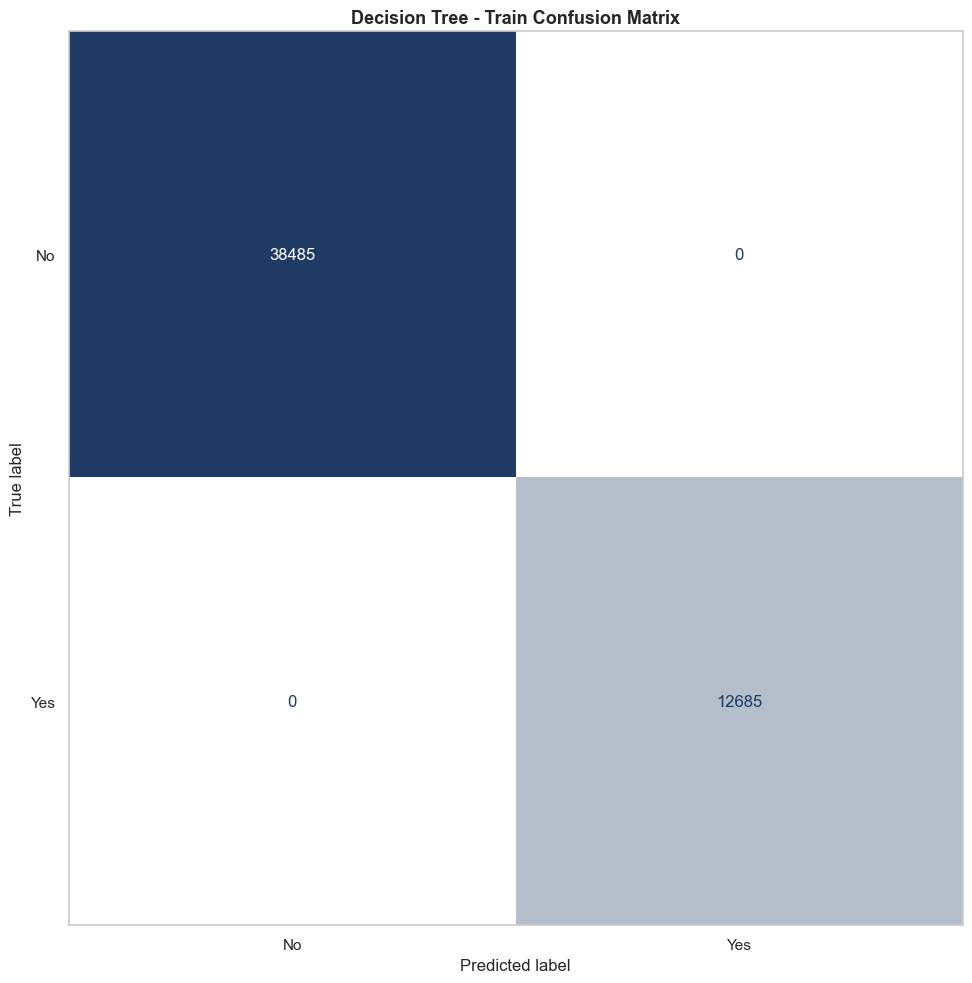

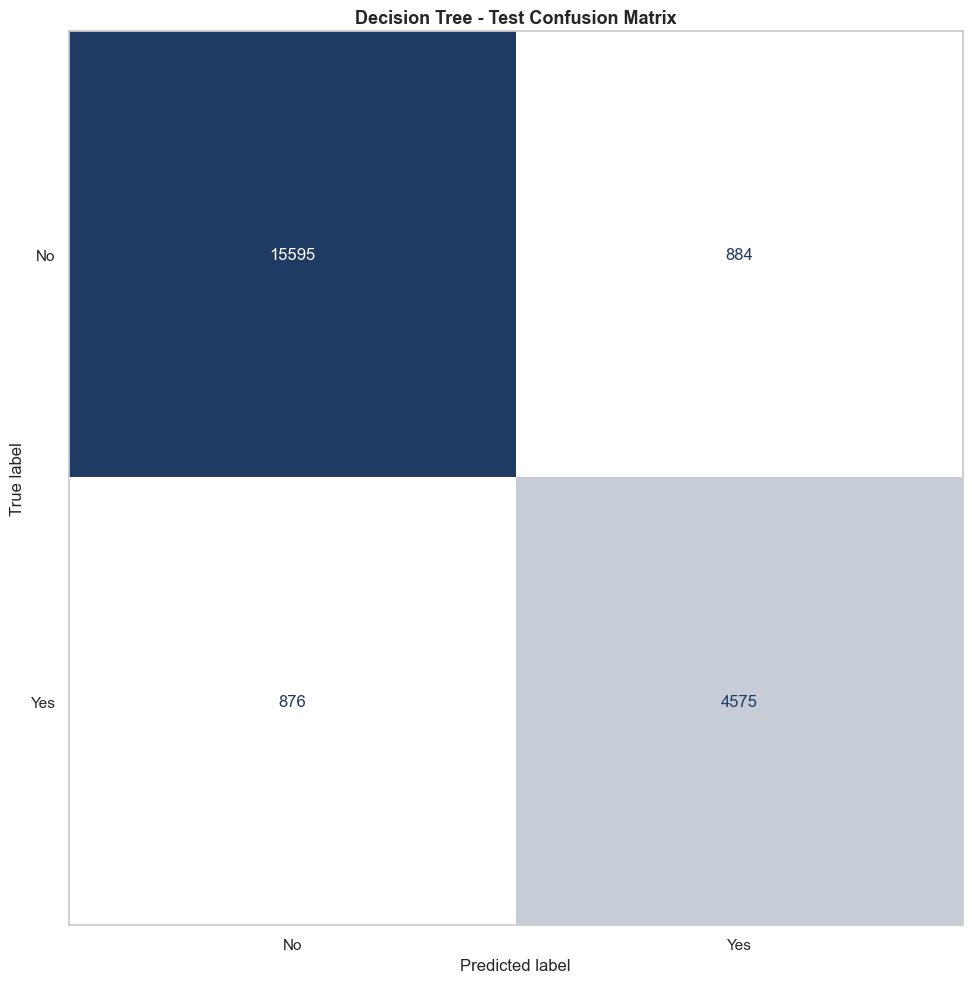

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     38485
           1       1.00      1.00      1.00     12685

    accuracy                           1.00     51170
   macro avg       1.00      1.00      1.00     51170
weighted avg       1.00      1.00      1.00     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.95      0.95      0.95     16479
           1       0.84      0.84      0.84      5451

    accuracy                           0.92     21930
   macro avg       0.89      0.89      0.89     21930
weighted avg       0.92      0.92      0.92     21930

ROC AUC Score (Train): 1.0
ROC AUC Score (Test): 0.8928257551521602
------------------------------------------------------------
🔍 AdaBoost
----------


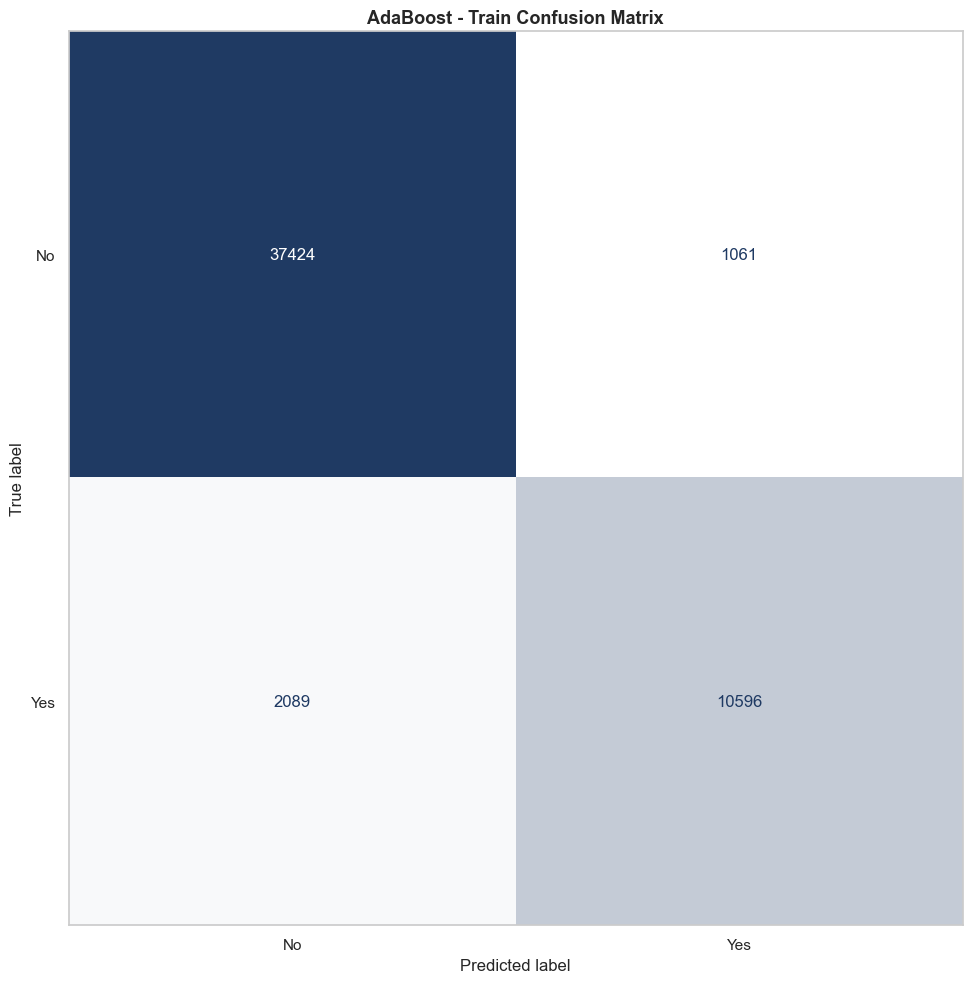

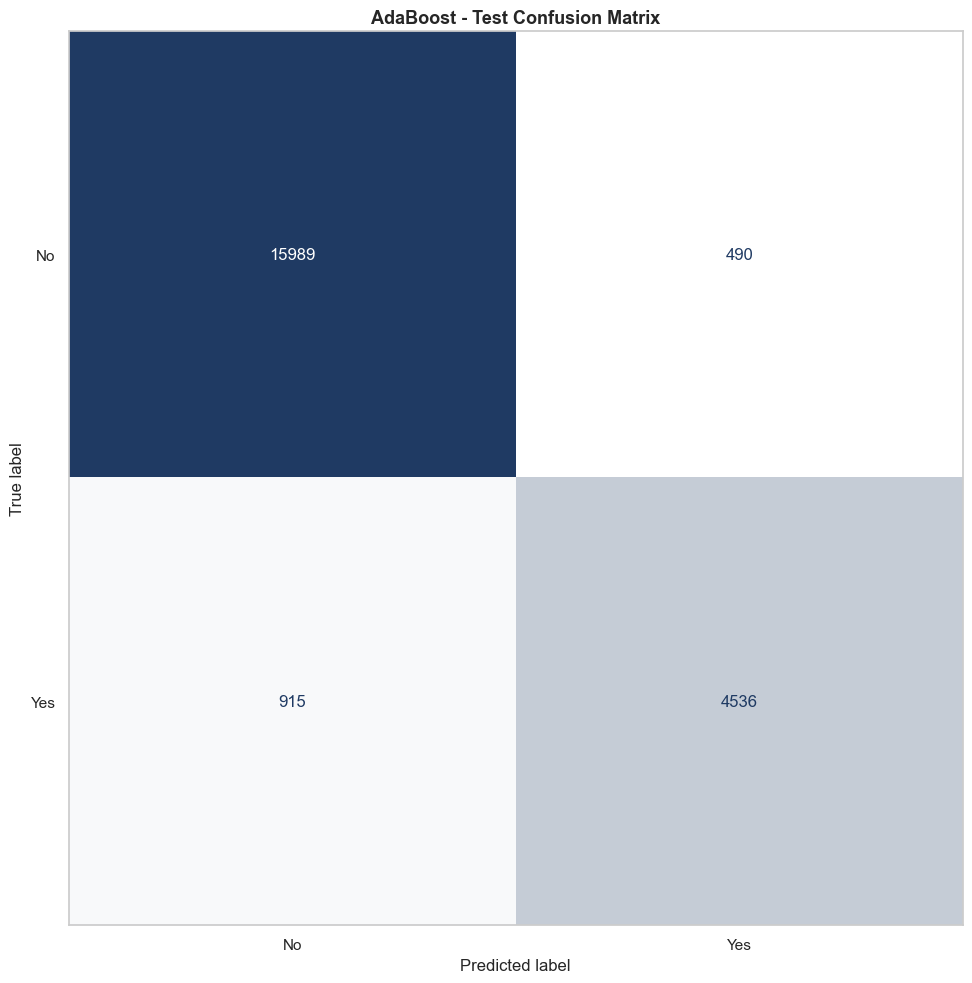

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.95      0.97      0.96     38485
           1       0.91      0.84      0.87     12685

    accuracy                           0.94     51170
   macro avg       0.93      0.90      0.92     51170
weighted avg       0.94      0.94      0.94     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.95      0.97      0.96     16479
           1       0.90      0.83      0.87      5451

    accuracy                           0.94     21930
   macro avg       0.92      0.90      0.91     21930
weighted avg       0.94      0.94      0.94     21930

ROC AUC Score (Train): 0.9854492725539117
ROC AUC Score (Test): 0.9843677953547812
------------------------------------------------------------
🔍 KNN
-----


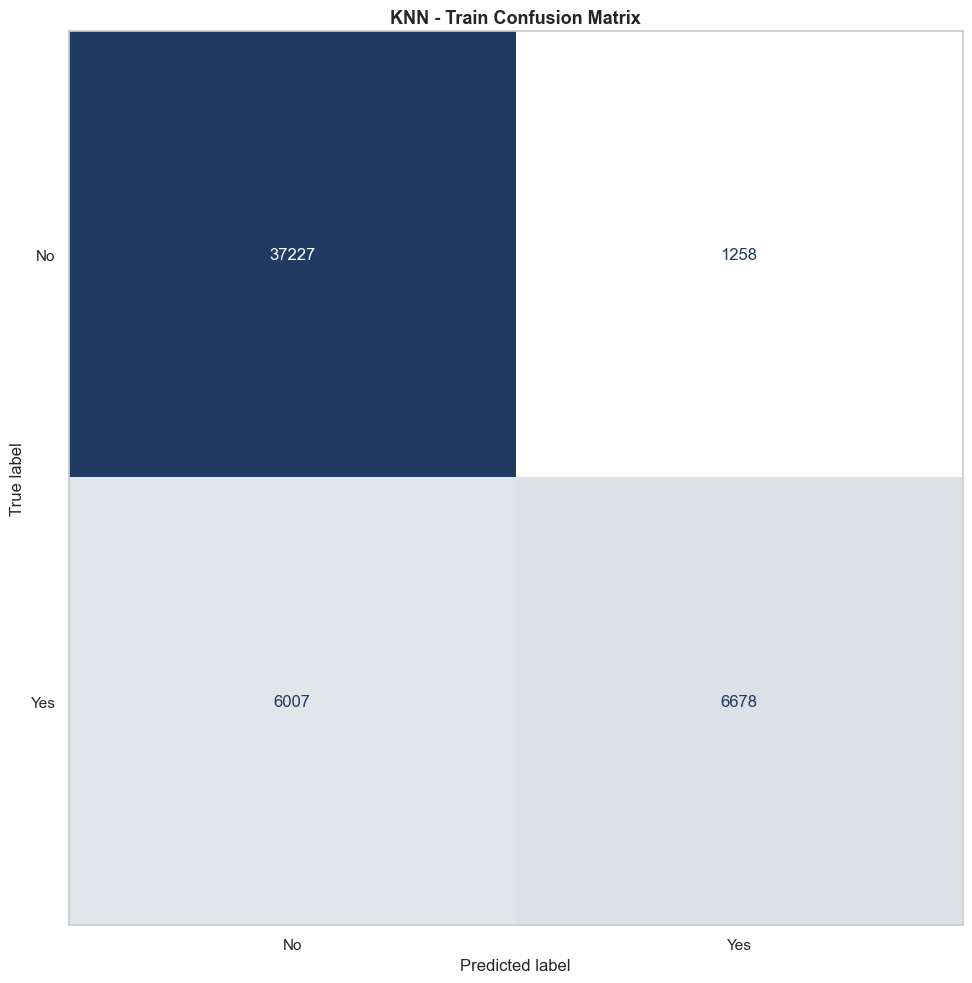

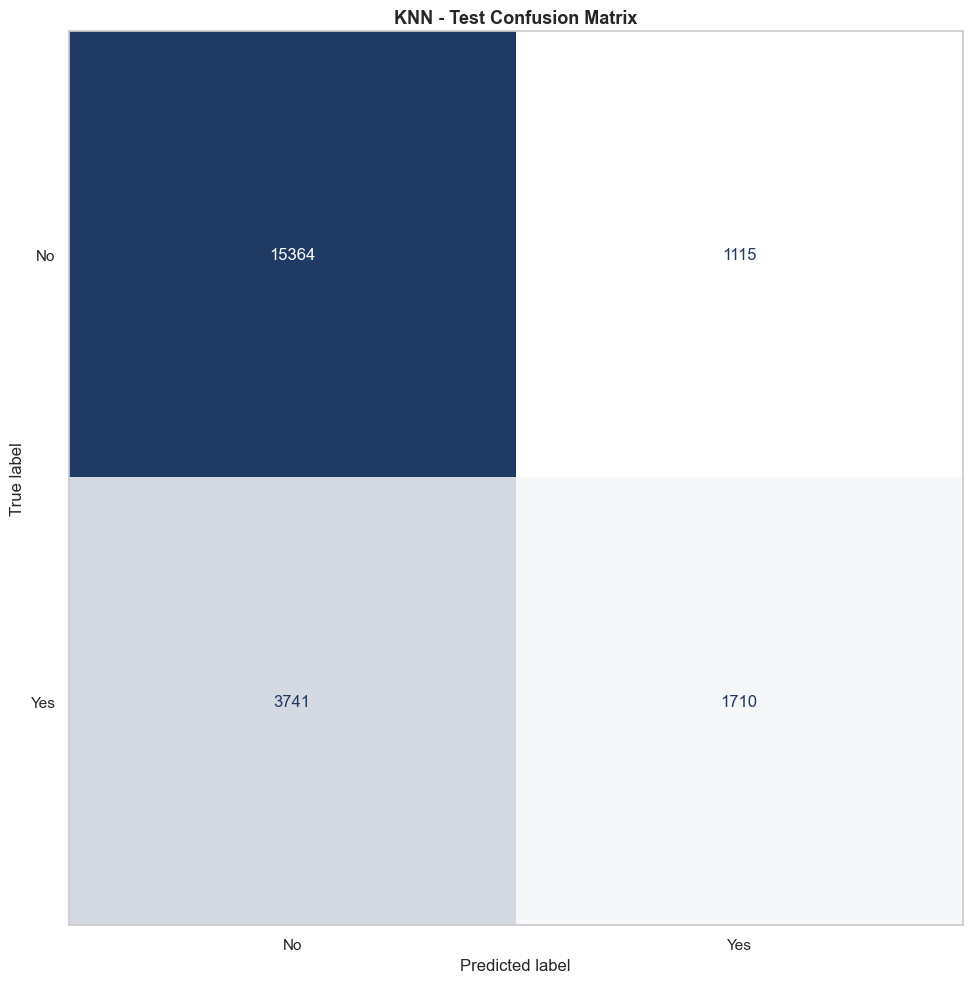

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.86      0.97      0.91     38485
           1       0.84      0.53      0.65     12685

    accuracy                           0.86     51170
   macro avg       0.85      0.75      0.78     51170
weighted avg       0.86      0.86      0.85     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.80      0.93      0.86     16479
           1       0.61      0.31      0.41      5451

    accuracy                           0.78     21930
   macro avg       0.70      0.62      0.64     21930
weighted avg       0.75      0.78      0.75     21930

ROC AUC Score (Train): 0.9193766395325024
ROC AUC Score (Test): 0.7649531467861417
------------------------------------------------------------
🔍 Extra Trees
-------------


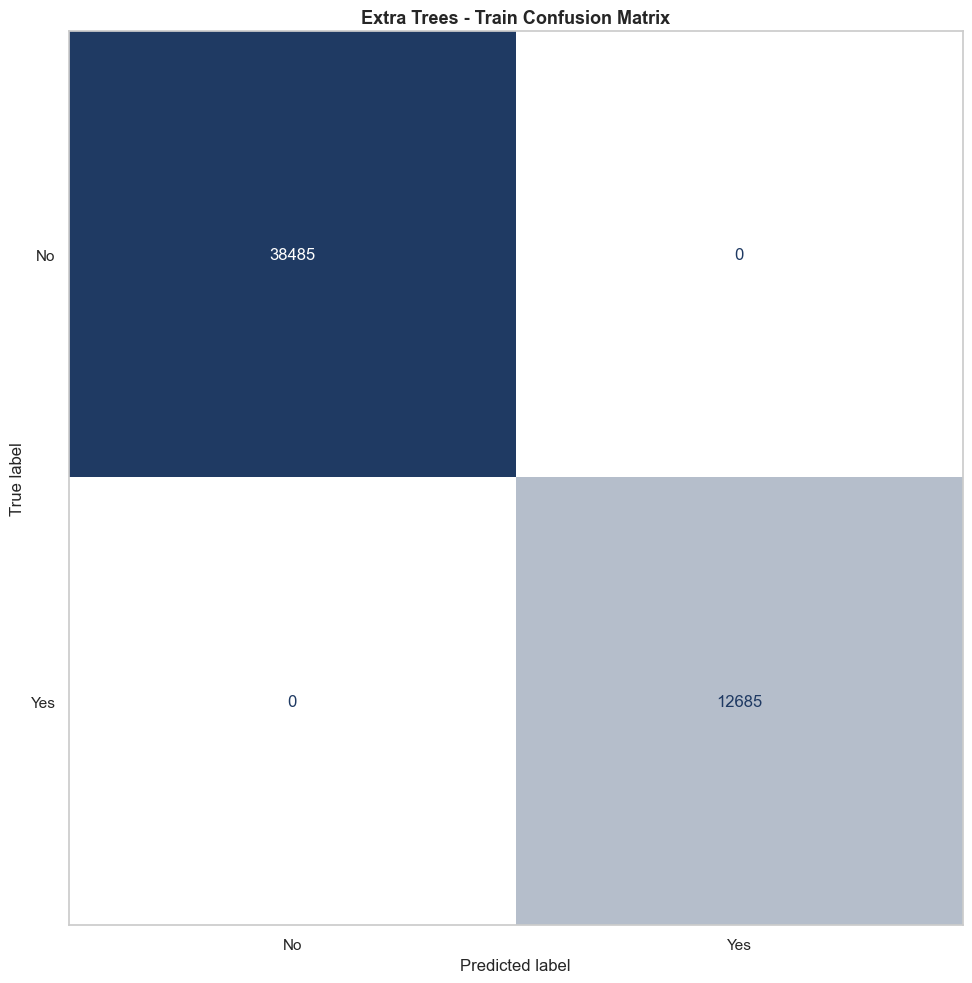

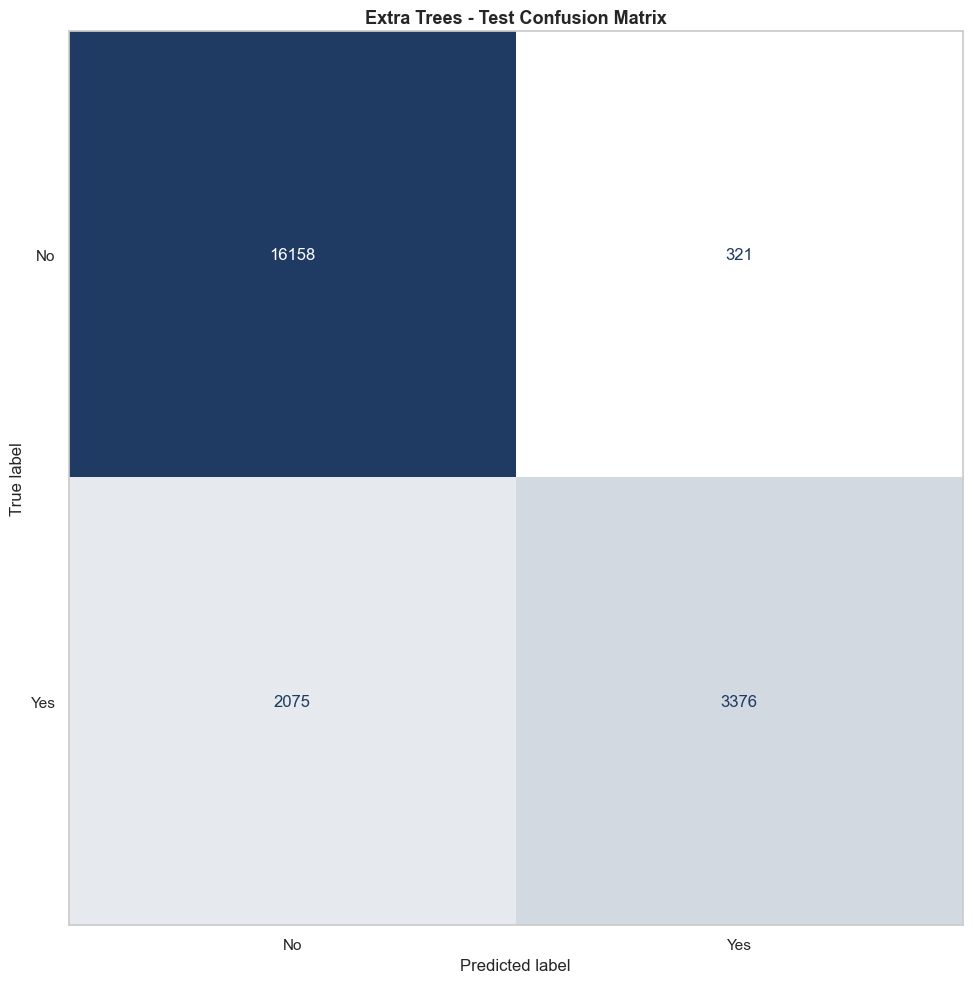

Train Report Before SMOTE:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     38485
           1       1.00      1.00      1.00     12685

    accuracy                           1.00     51170
   macro avg       1.00      1.00      1.00     51170
weighted avg       1.00      1.00      1.00     51170

Test Report Before SMOTE:
               precision    recall  f1-score   support

           0       0.89      0.98      0.93     16479
           1       0.91      0.62      0.74      5451

    accuracy                           0.89     21930
   macro avg       0.90      0.80      0.83     21930
weighted avg       0.89      0.89      0.88     21930

ROC AUC Score (Train): 1.0
ROC AUC Score (Test): 0.9629771847402412
------------------------------------------------------------


In [88]:
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, ExtraTreesClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, roc_auc_score
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train)
y_test_enc = le.transform(y_test)

labels = ['No', 'Yes']
custom_blues = LinearSegmentedColormap.from_list("custom_blues", ['white', '#1F3A63'])

def plot_conf_matrix(y_true, y_pred, title):
    disp = ConfusionMatrixDisplay.from_predictions(
        y_true, y_pred,
        display_labels=labels,
        cmap=custom_blues,
        colorbar=False
    )
    disp.ax_.set_title(title, fontsize=13, weight='bold')
    disp.ax_.tick_params(labelsize=11)
    plt.grid(False)
    plt.tight_layout()
    plt.show()

categorical_features = ['Holiday/Promotion']
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
], remainder='passthrough')

model = LogisticRegression(random_state=42)
gnb_model = GaussianNB()
linear_svc_model = LinearSVC(random_state=42, max_iter=10000)
rf_model = RandomForestClassifier(random_state=42)
pipeline_xgb = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', XGBClassifier(eval_metric='logloss', random_state=42))
])

pipeline_lgb = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression())
])
mlp_model = Pipeline([
    ('scaler', StandardScaler()),
    ('classifier', MLPClassifier(hidden_layer_sizes=(100,), max_iter=300, random_state=42))
])
dt_model = DecisionTreeClassifier(random_state=42)
ab_model = AdaBoostClassifier(random_state=42)
knn_model = Pipeline([
    ('scaler', StandardScaler()),
    ('classifier', KNeighborsClassifier())
])
et_model = ExtraTreesClassifier(random_state=42)

model_blocks = [
    ("Logistic Regression", model, y_train, y_test, "predict_proba"),
    ("GaussianNB", gnb_model, y_train, y_test, "predict_proba"),
    ("LinearSVC", linear_svc_model, y_train, y_test, "decision_function"),
    ("Random Forest", rf_model, y_train, y_test, "predict_proba"),
    ("XGBoost", pipeline_xgb, y_train_enc, y_test_enc, "predict_proba"),
    ("LightGBM", pipeline_lgb, y_train_enc, y_test_enc, "predict_proba"),
    ("MLP", mlp_model, y_train, y_test, "predict_proba"),
    ("Decision Tree", dt_model, y_train, y_test, "predict_proba"),
    ("AdaBoost", ab_model, y_train, y_test, "predict_proba"),
    ("KNN", knn_model, y_train, y_test, "predict_proba"),
    ("Extra Trees", et_model, y_train, y_test, "predict_proba")
]

for name, model, y_train_true, y_test_true, method in model_blocks:
    print(f"🔍 {name}")
    print("-" * len(f"🔍 {name}"))

    model.fit(X_train, y_train_true)

    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    plot_conf_matrix(y_train_true, y_train_pred, f"{name} - Train Confusion Matrix")
    plot_conf_matrix(y_test_true, y_test_pred, f"{name} - Test Confusion Matrix")

    print("Train Report Before SMOTE:\n", classification_report(y_train_true, y_train_pred))
    print("Test Report Before SMOTE:\n", classification_report(y_test_true, y_test_pred))

    if method == "predict_proba":
        y_train_proba = model.predict_proba(X_train)[:, 1]
        y_test_proba = model.predict_proba(X_test)[:, 1]
    else:
        y_train_proba = model.decision_function(X_train)
        y_test_proba = model.decision_function(X_test)

    print("ROC AUC Score (Train):", roc_auc_score(y_train_true, y_train_proba))
    print("ROC AUC Score (Test):", roc_auc_score(y_test_true, y_test_proba))
    print("-" * 60)

<span style="font-family: 'Consolas';"><span style="color:magenta">
MODEL PERFORMANCE AFTER SMOTE

🔍 Logistic Regression (SMOTE)
-----------------------------


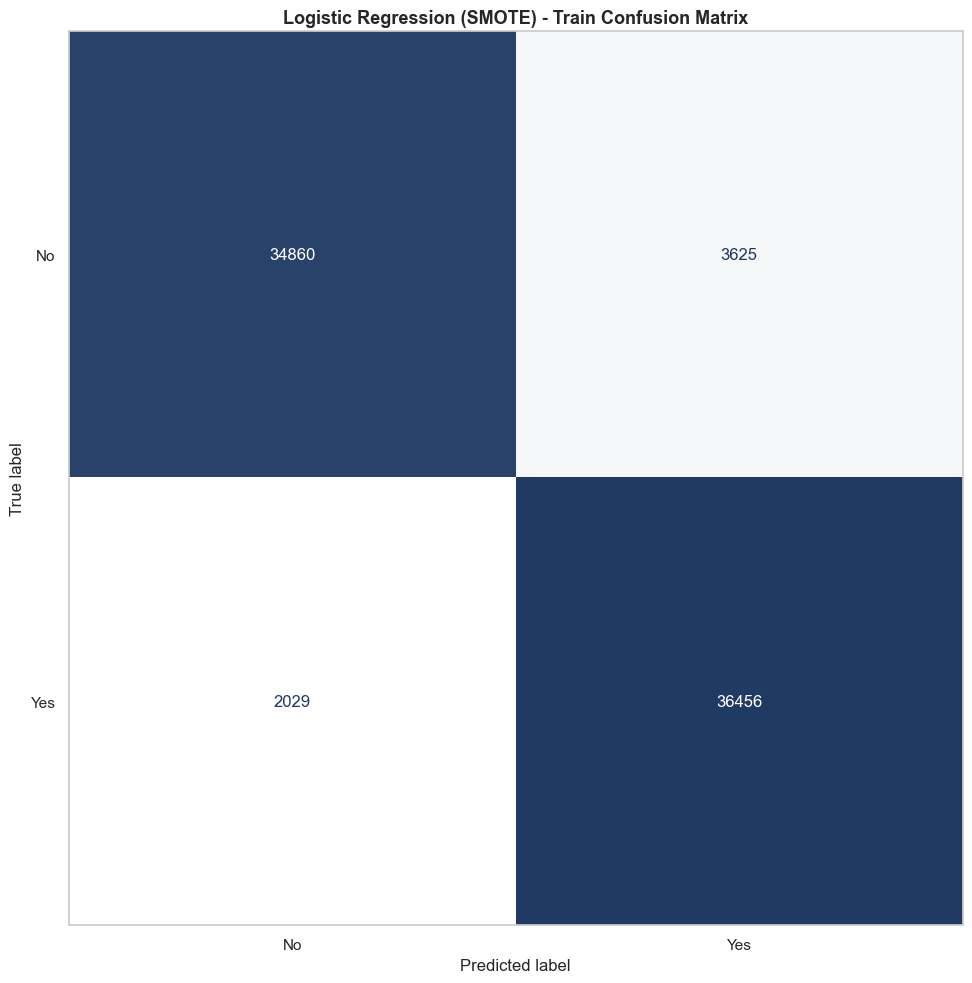

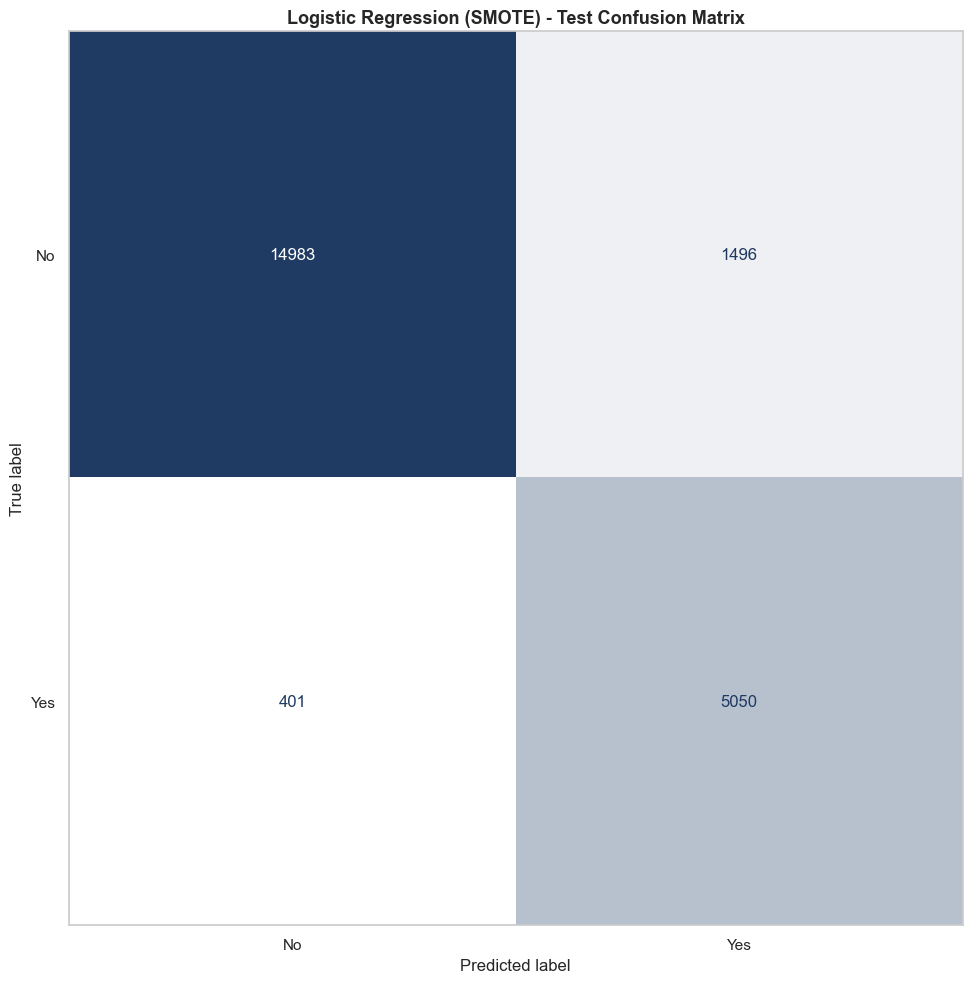

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       0.94      0.91      0.92     38485
           1       0.91      0.95      0.93     38485

    accuracy                           0.93     76970
   macro avg       0.93      0.93      0.93     76970
weighted avg       0.93      0.93      0.93     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.97      0.91      0.94     16479
           1       0.77      0.93      0.84      5451

    accuracy                           0.91     21930
   macro avg       0.87      0.92      0.89     21930
weighted avg       0.92      0.91      0.92     21930

ROC AUC Score (Train): 0.9703555009435669
ROC AUC Score (Test): 0.9691441537045605
------------------------------------------------------------
🔍 GaussianNB (SMOTE)
--------------------


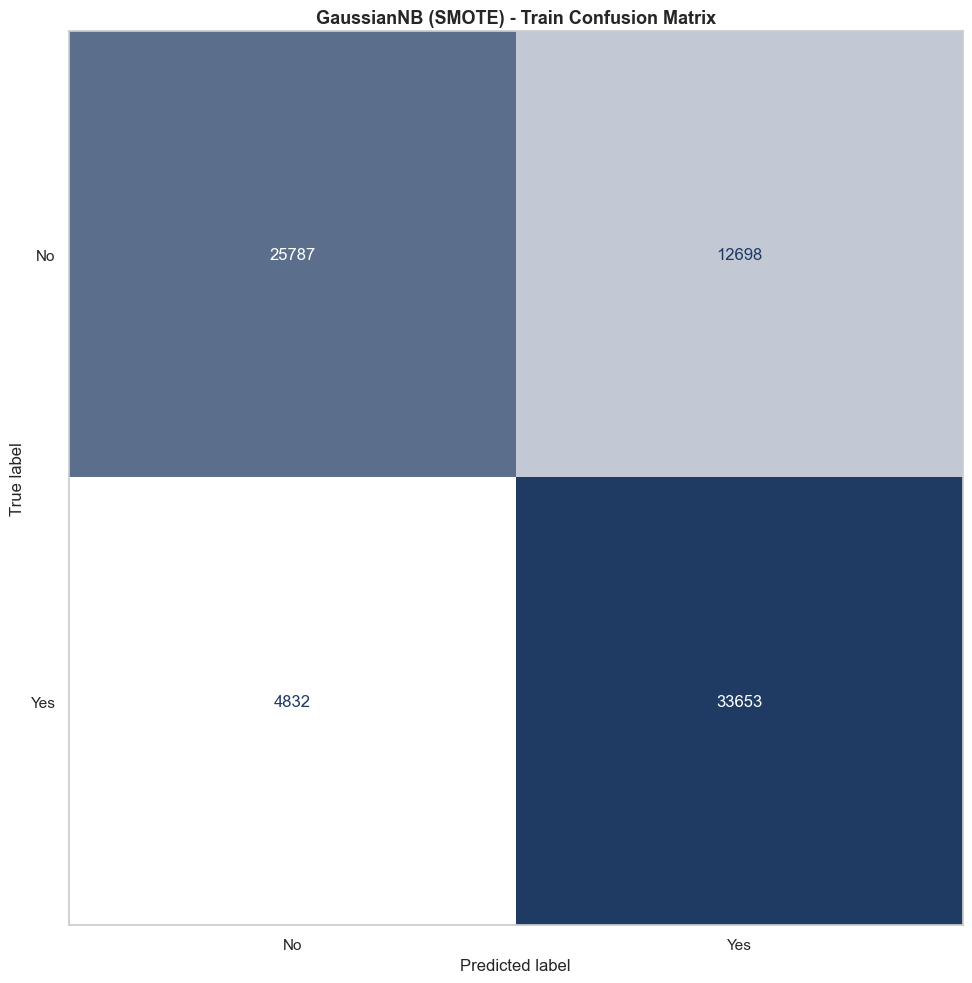

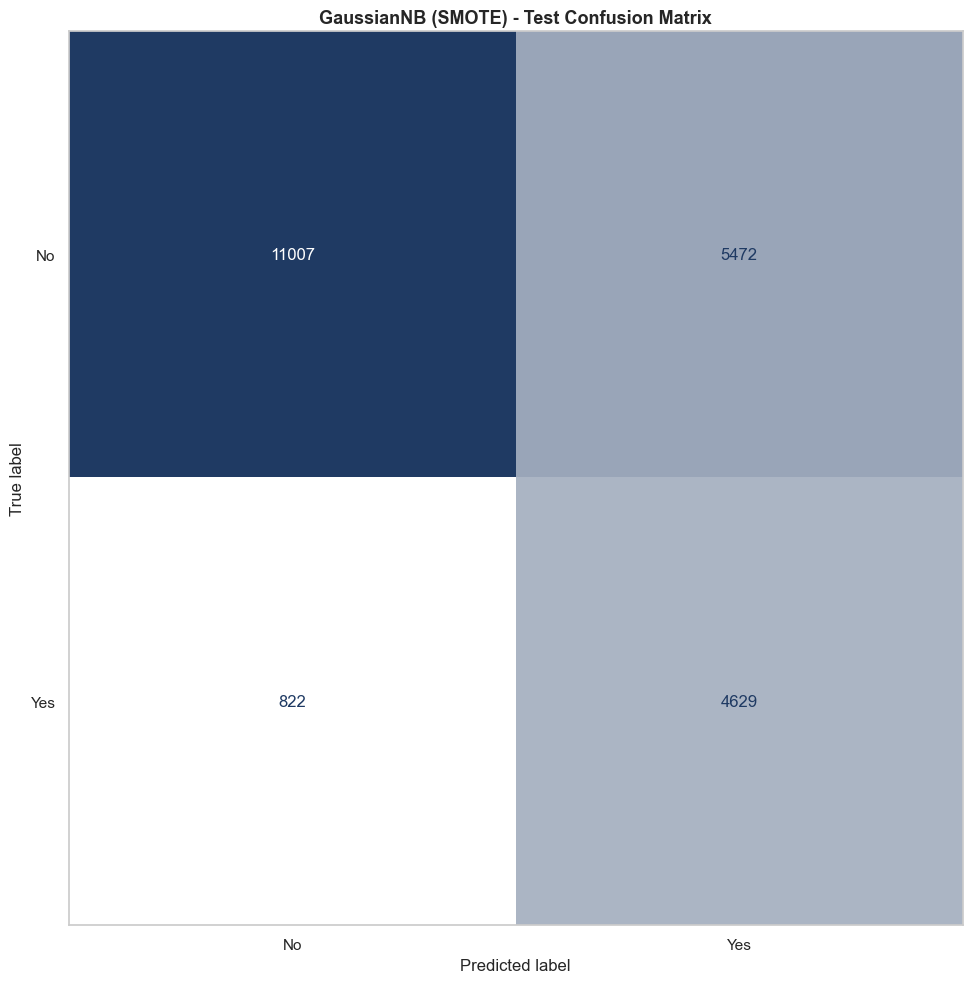

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       0.84      0.67      0.75     38485
           1       0.73      0.87      0.79     38485

    accuracy                           0.77     76970
   macro avg       0.78      0.77      0.77     76970
weighted avg       0.78      0.77      0.77     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.93      0.67      0.78     16479
           1       0.46      0.85      0.60      5451

    accuracy                           0.71     21930
   macro avg       0.69      0.76      0.69     21930
weighted avg       0.81      0.71      0.73     21930

ROC AUC Score (Train): 0.8269479681834773
ROC AUC Score (Test): 0.8162121781852542
------------------------------------------------------------
🔍 LinearSVC (SMOTE)
-------------------


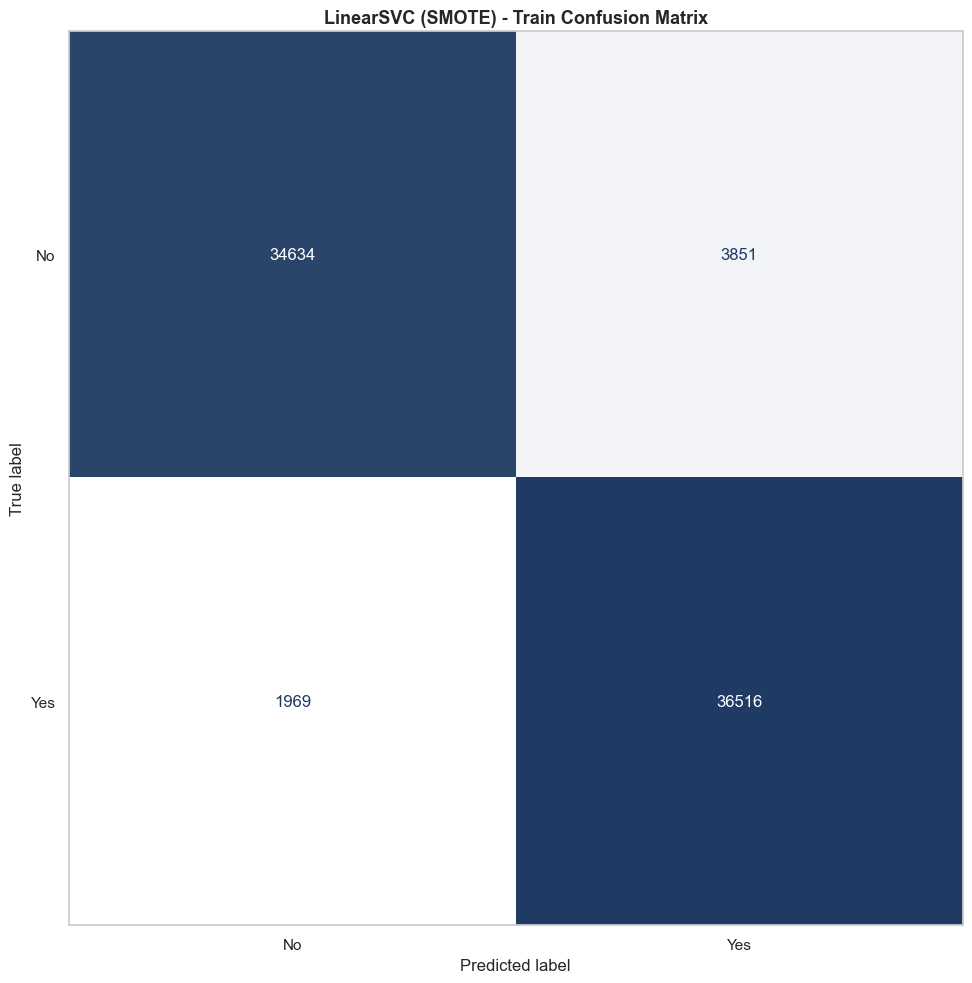

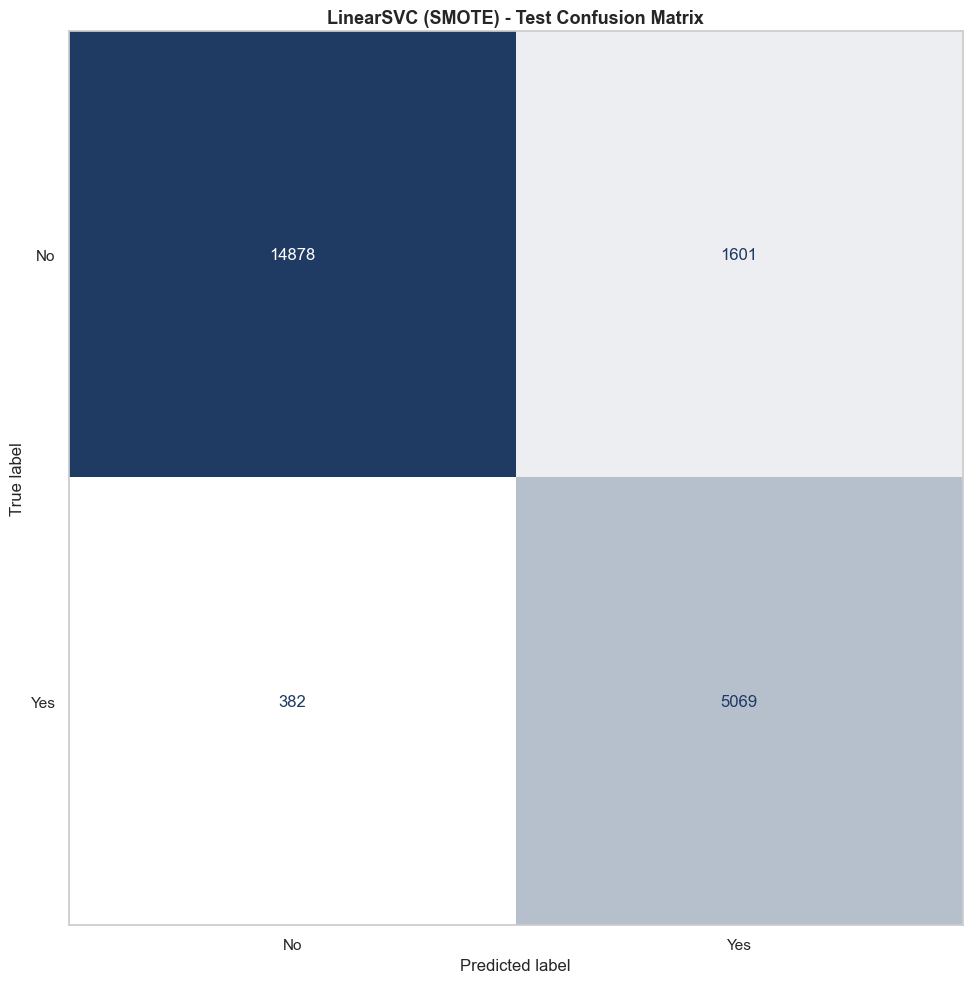

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       0.95      0.90      0.92     38485
           1       0.90      0.95      0.93     38485

    accuracy                           0.92     76970
   macro avg       0.93      0.92      0.92     76970
weighted avg       0.93      0.92      0.92     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.97      0.90      0.94     16479
           1       0.76      0.93      0.84      5451

    accuracy                           0.91     21930
   macro avg       0.87      0.92      0.89     21930
weighted avg       0.92      0.91      0.91     21930

ROC AUC Score (Train): 0.9700418033553515
ROC AUC Score (Test): 0.96881456471192
------------------------------------------------------------
🔍 Random Forest (SMOTE)
-----------------------


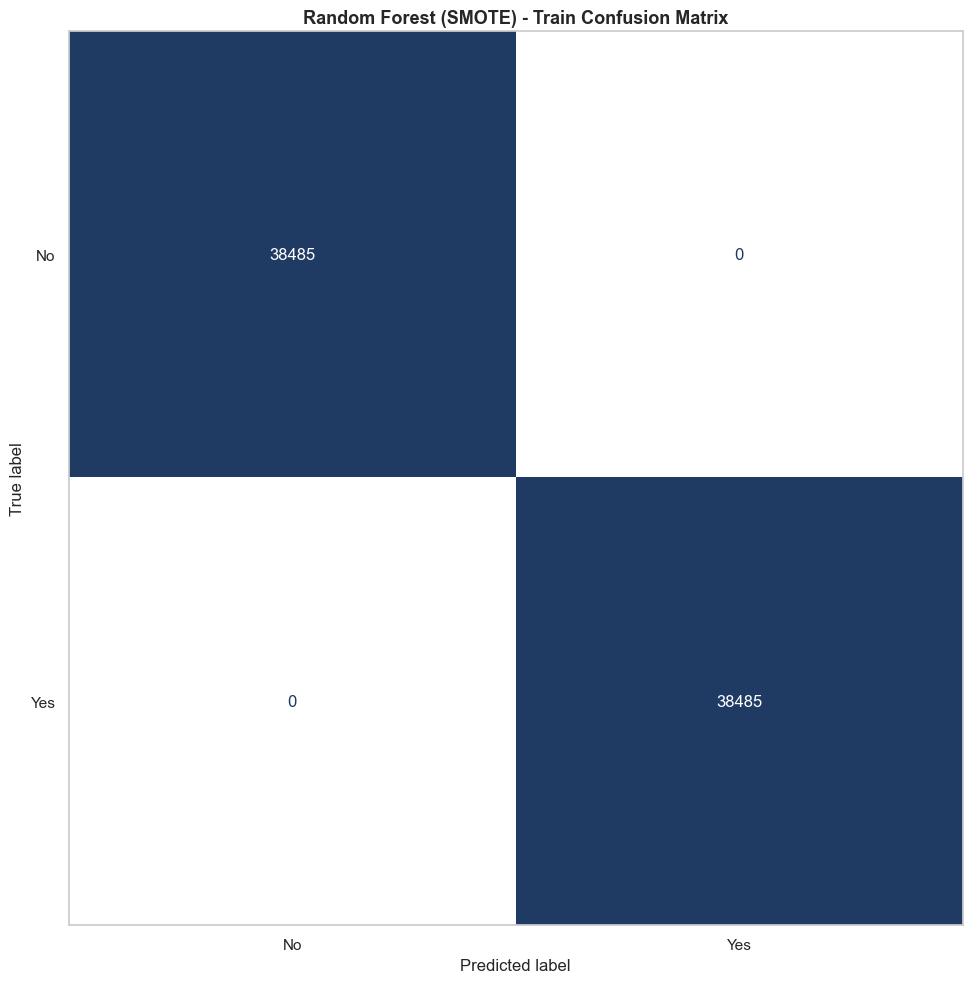

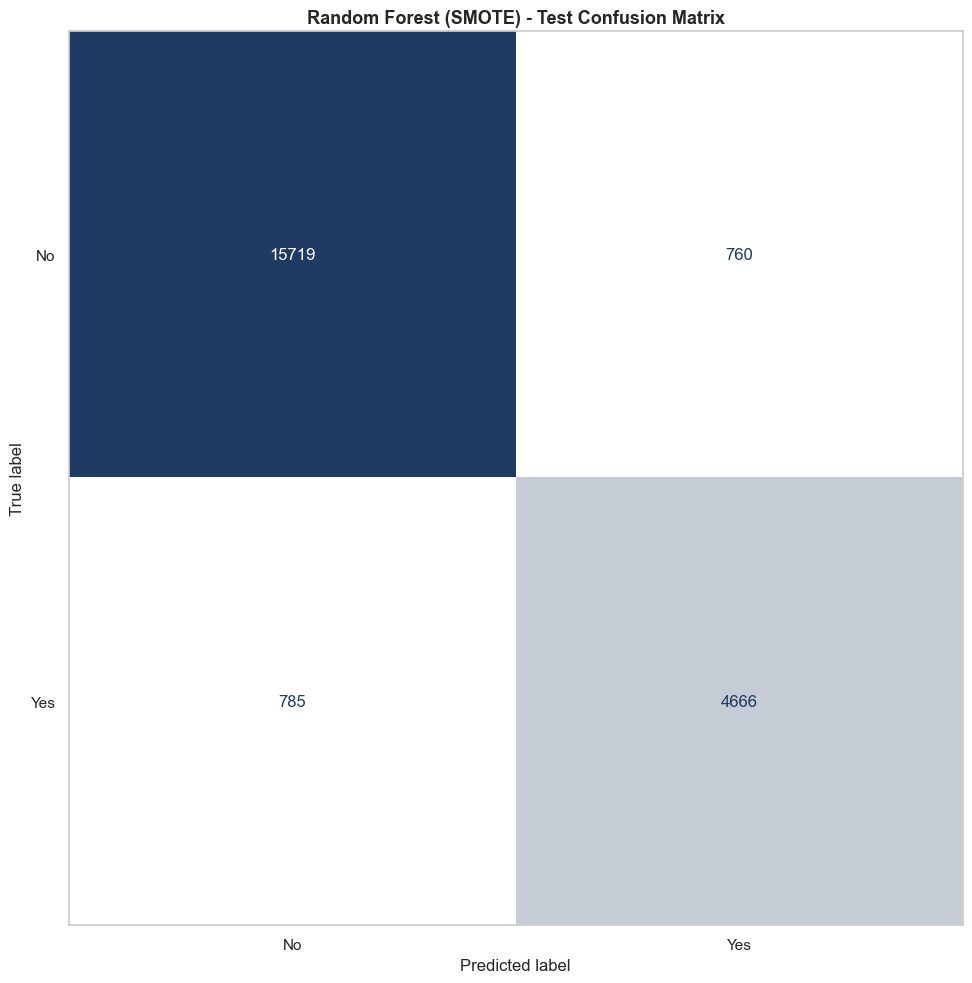

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     38485
           1       1.00      1.00      1.00     38485

    accuracy                           1.00     76970
   macro avg       1.00      1.00      1.00     76970
weighted avg       1.00      1.00      1.00     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.95      0.95      0.95     16479
           1       0.86      0.86      0.86      5451

    accuracy                           0.93     21930
   macro avg       0.91      0.90      0.91     21930
weighted avg       0.93      0.93      0.93     21930

ROC AUC Score (Train): 1.0
ROC AUC Score (Test): 0.981677714176654
------------------------------------------------------------
🔍 XGBoost (SMOTE)
-----------------


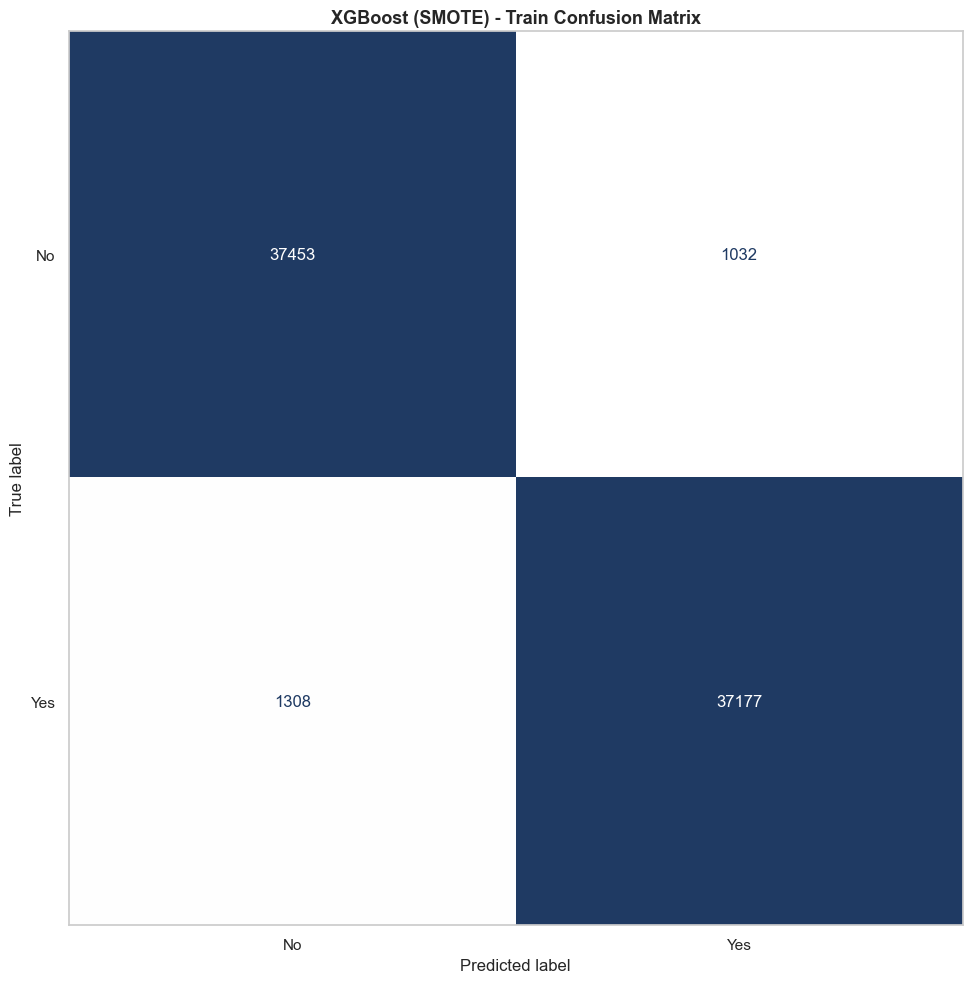

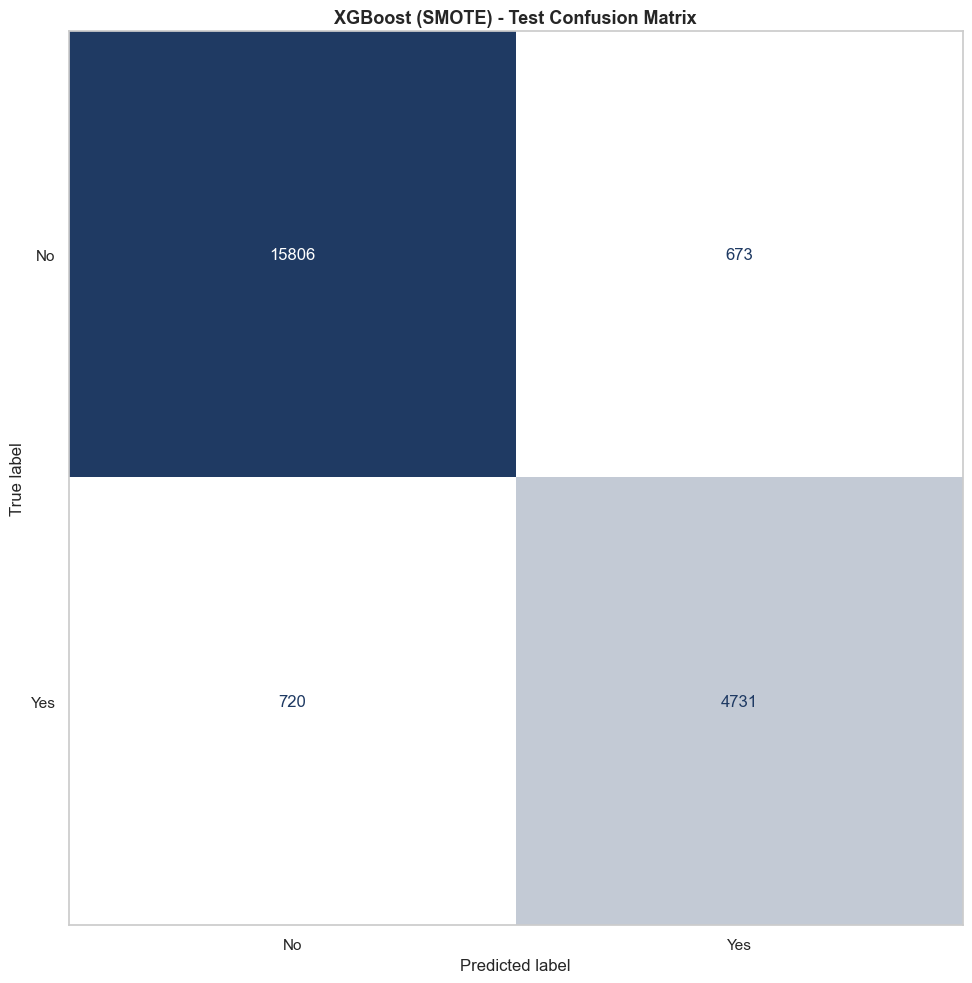

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       0.97      0.97      0.97     38485
           1       0.97      0.97      0.97     38485

    accuracy                           0.97     76970
   macro avg       0.97      0.97      0.97     76970
weighted avg       0.97      0.97      0.97     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.96      0.96      0.96     16479
           1       0.88      0.87      0.87      5451

    accuracy                           0.94     21930
   macro avg       0.92      0.91      0.91     21930
weighted avg       0.94      0.94      0.94     21930

ROC AUC Score (Train): 0.997324652775111
ROC AUC Score (Test): 0.985383174589911
------------------------------------------------------------
🔍 LightGBM (SMOTE)
------------------


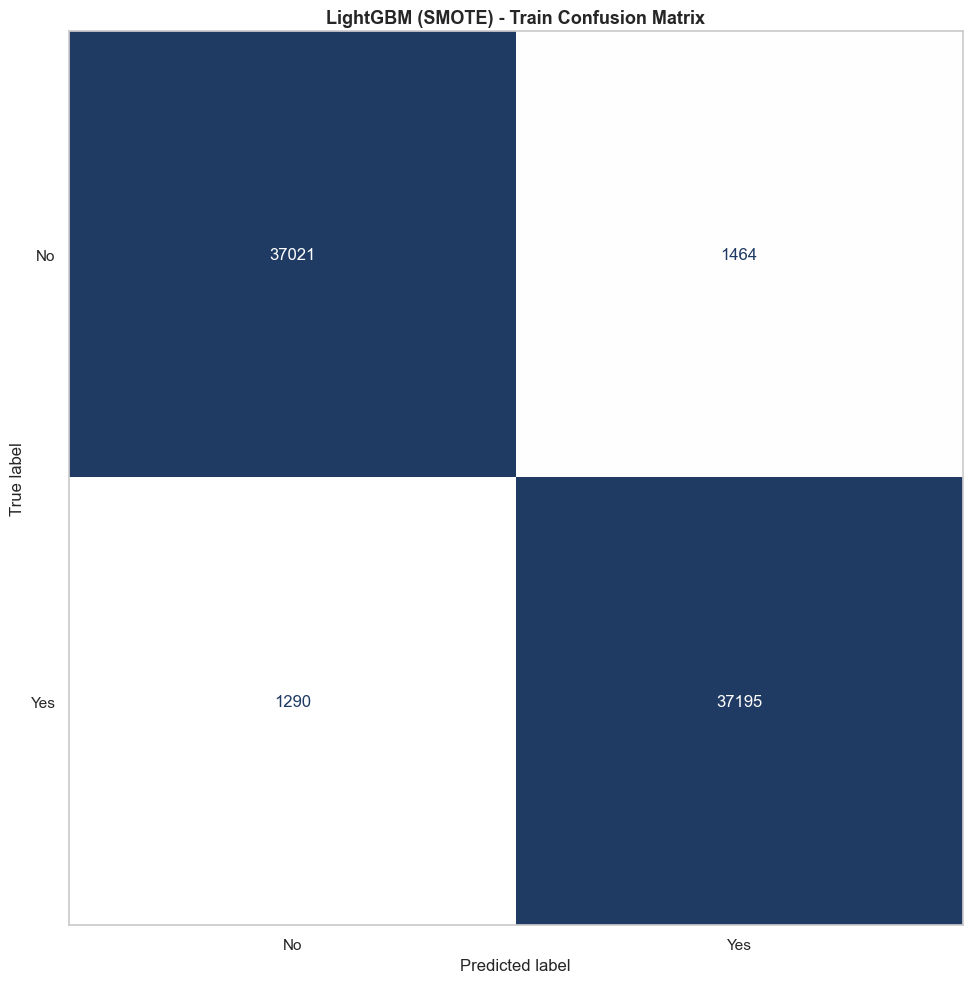

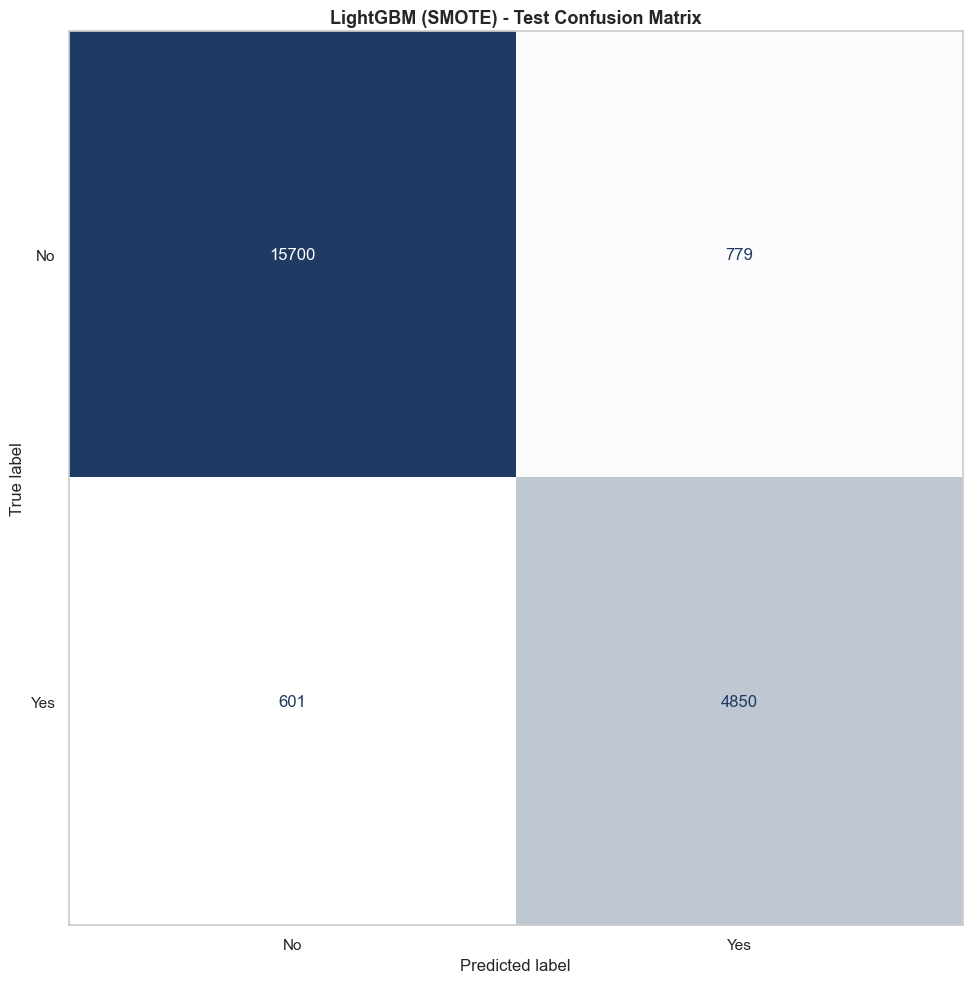

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       0.97      0.96      0.96     38485
           1       0.96      0.97      0.96     38485

    accuracy                           0.96     76970
   macro avg       0.96      0.96      0.96     76970
weighted avg       0.96      0.96      0.96     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.96      0.95      0.96     16479
           1       0.86      0.89      0.88      5451

    accuracy                           0.94     21930
   macro avg       0.91      0.92      0.92     21930
weighted avg       0.94      0.94      0.94     21930

ROC AUC Score (Train): 0.9962848377963004
ROC AUC Score (Test): 0.9863298718251051
------------------------------------------------------------
🔍 MLP (SMOTE)
-------------


C:\Users\medly\anaconda3\envs\old_env\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:684: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


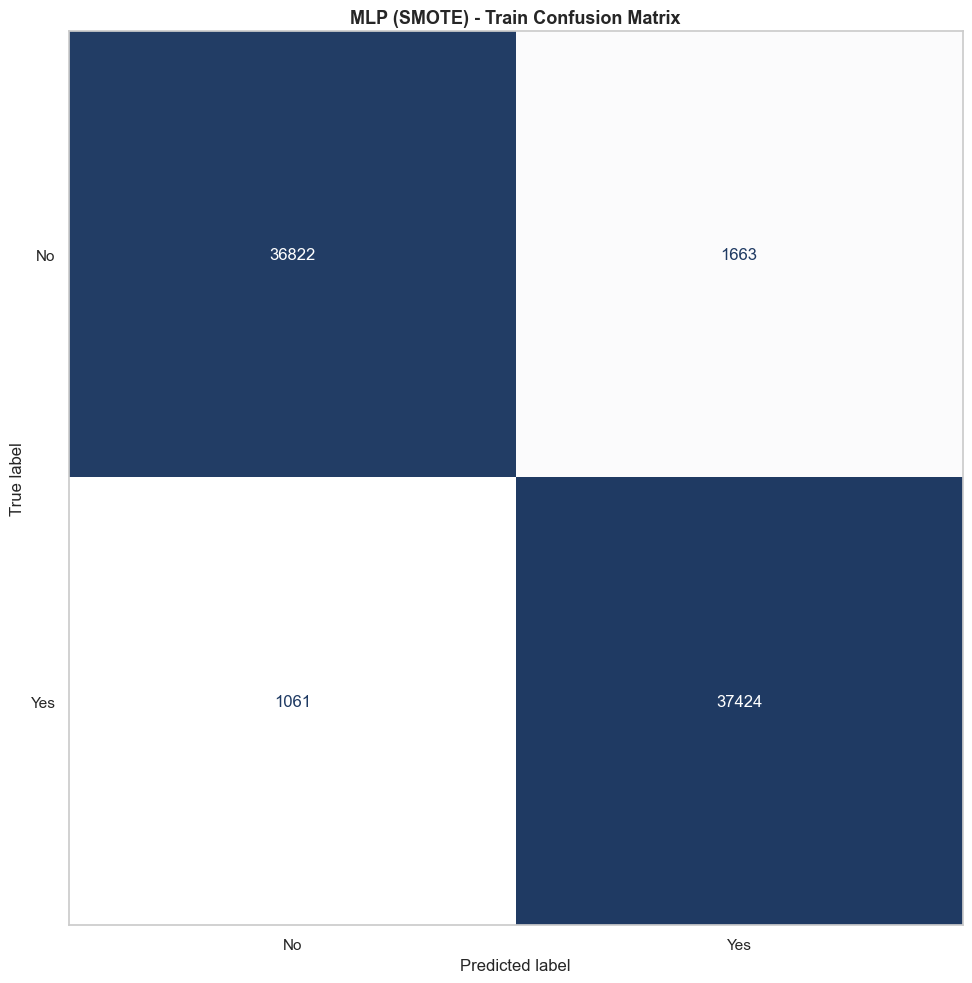

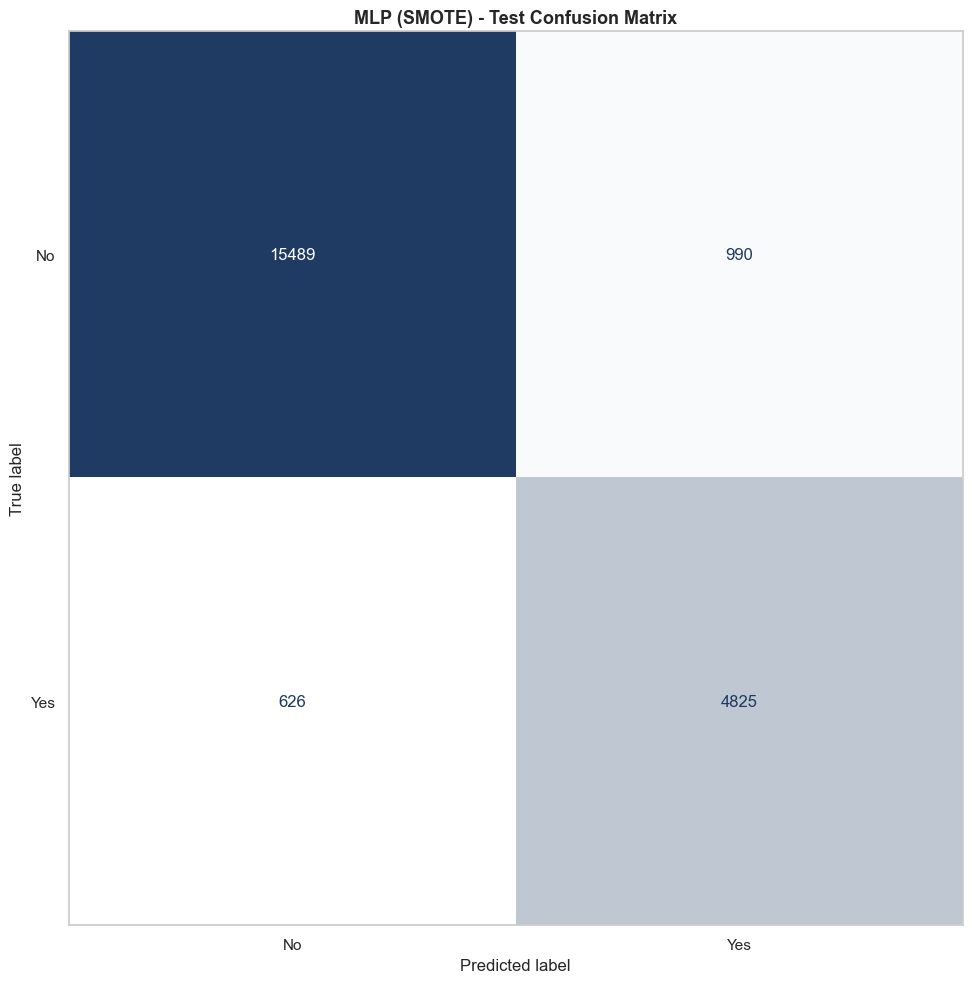

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       0.97      0.96      0.96     38485
           1       0.96      0.97      0.96     38485

    accuracy                           0.96     76970
   macro avg       0.96      0.96      0.96     76970
weighted avg       0.96      0.96      0.96     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.96      0.94      0.95     16479
           1       0.83      0.89      0.86      5451

    accuracy                           0.93     21930
   macro avg       0.90      0.91      0.90     21930
weighted avg       0.93      0.93      0.93     21930

ROC AUC Score (Train): 0.9954900928129048
ROC AUC Score (Test): 0.9821351544422116
------------------------------------------------------------
🔍 Decision Tree (SMOTE)
-----------------------


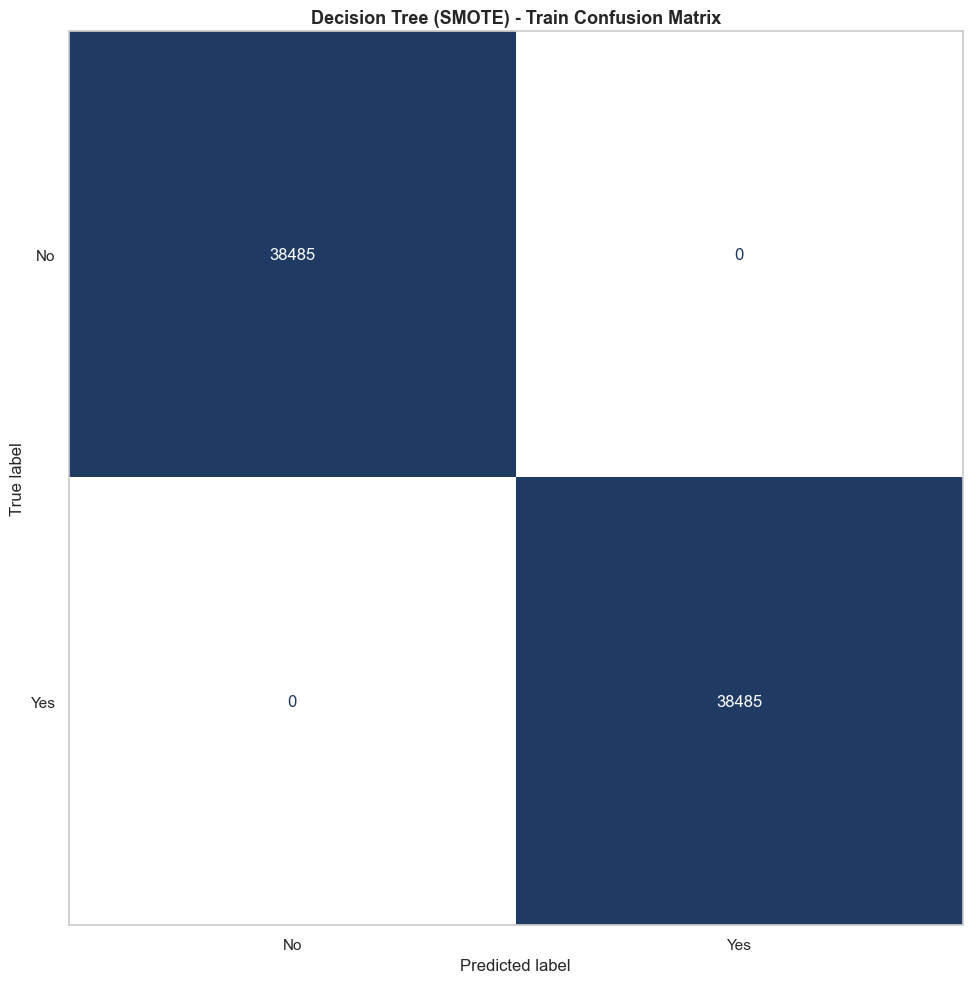

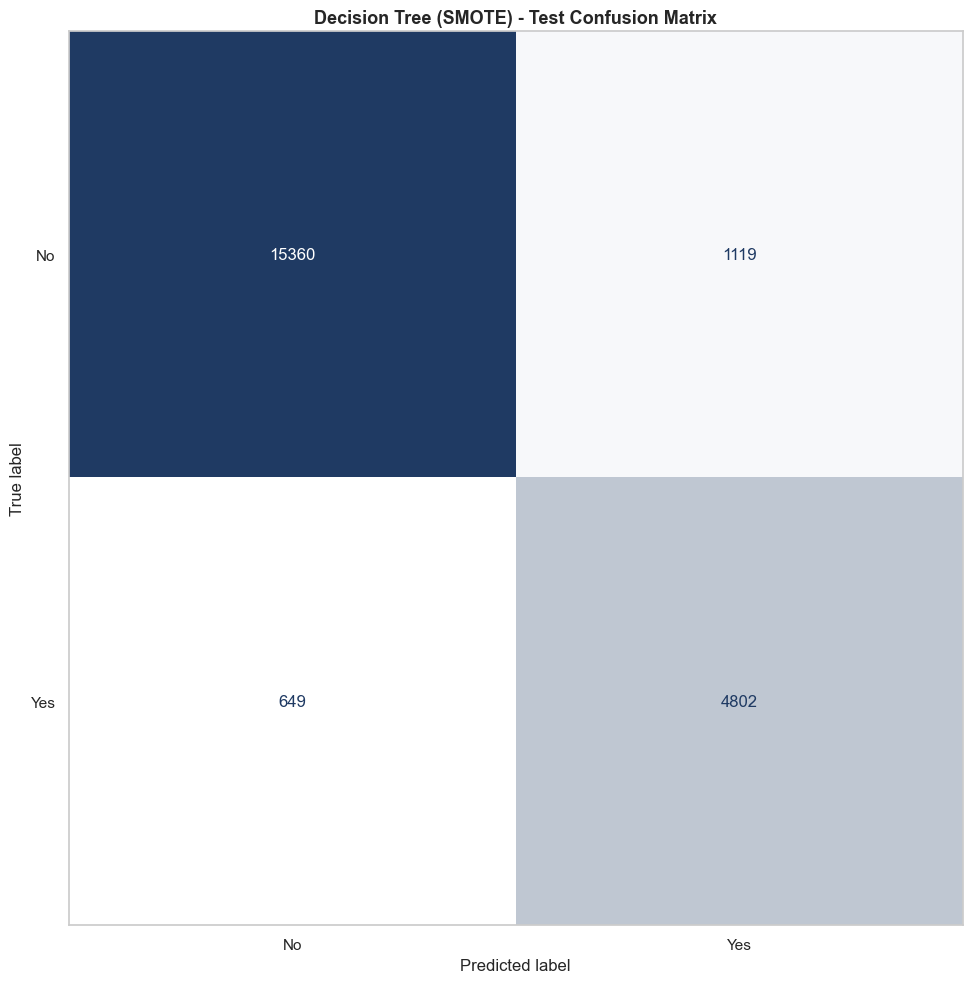

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     38485
           1       1.00      1.00      1.00     38485

    accuracy                           1.00     76970
   macro avg       1.00      1.00      1.00     76970
weighted avg       1.00      1.00      1.00     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.96      0.93      0.95     16479
           1       0.81      0.88      0.84      5451

    accuracy                           0.92     21930
   macro avg       0.89      0.91      0.90     21930
weighted avg       0.92      0.92      0.92     21930

ROC AUC Score (Train): 1.0
ROC AUC Score (Test): 0.9065173356674192
------------------------------------------------------------
🔍 AdaBoost (SMOTE)
------------------


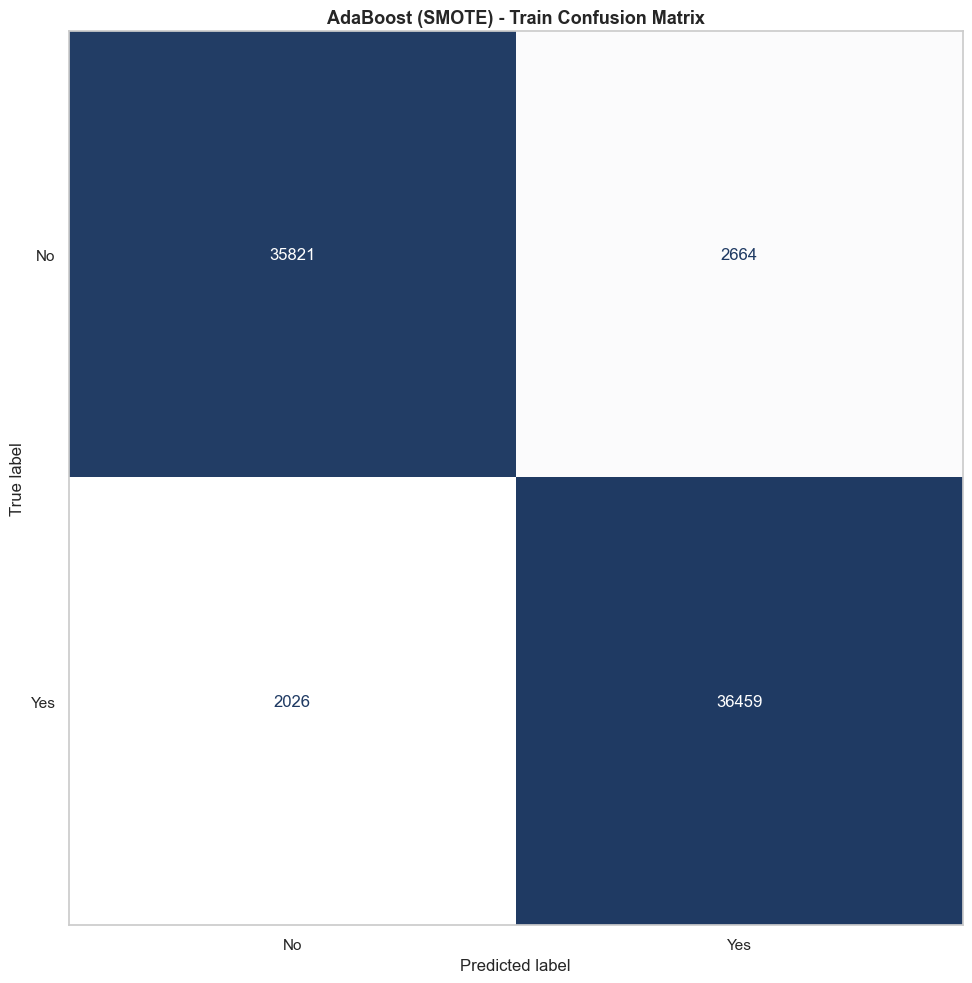

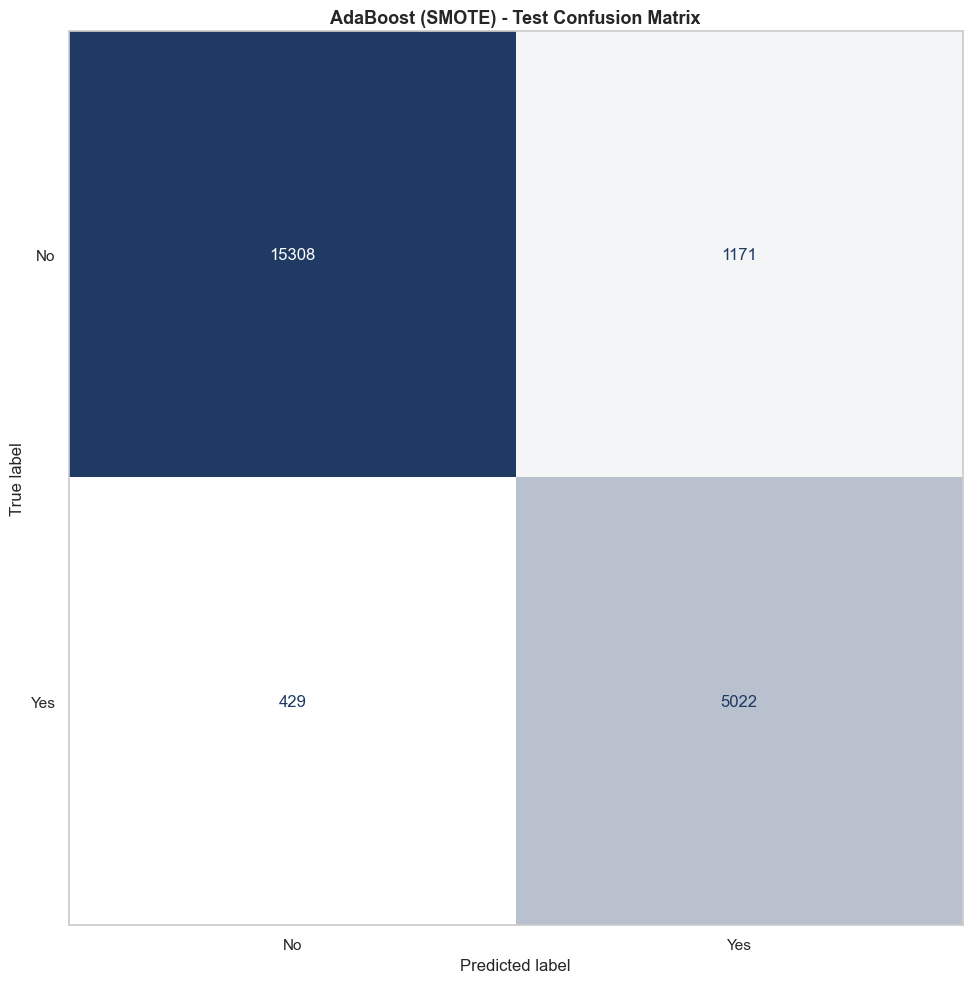

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       0.95      0.93      0.94     38485
           1       0.93      0.95      0.94     38485

    accuracy                           0.94     76970
   macro avg       0.94      0.94      0.94     76970
weighted avg       0.94      0.94      0.94     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.97      0.93      0.95     16479
           1       0.81      0.92      0.86      5451

    accuracy                           0.93     21930
   macro avg       0.89      0.93      0.91     21930
weighted avg       0.93      0.93      0.93     21930

ROC AUC Score (Train): 0.9892843797399995
ROC AUC Score (Test): 0.9846654006557425
------------------------------------------------------------
🔍 KNN (SMOTE)
-------------


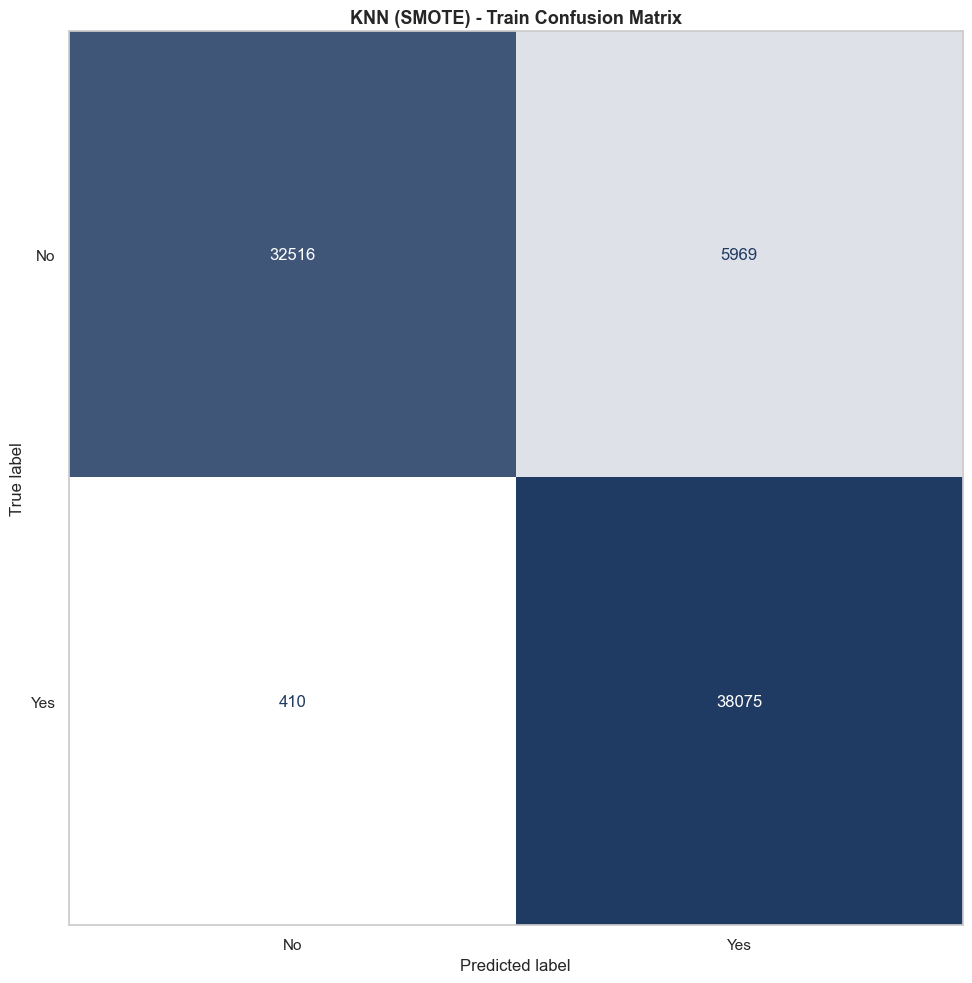

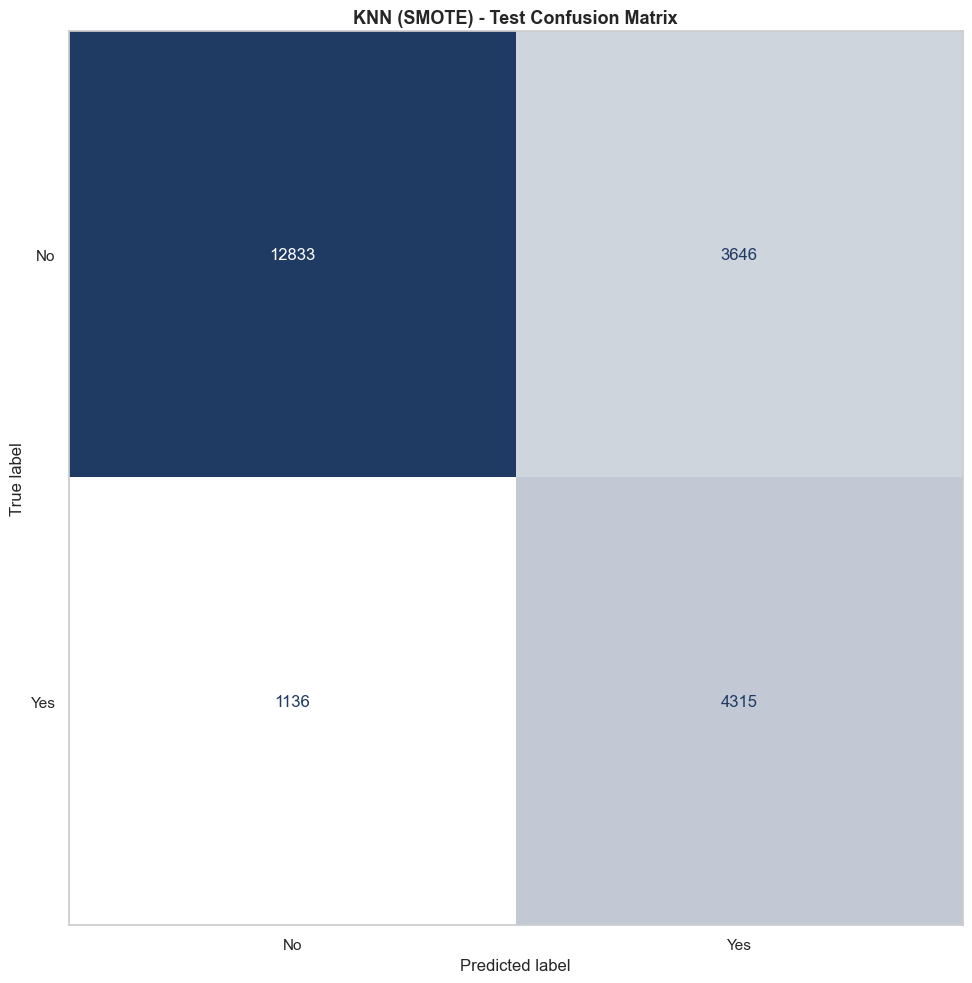

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       0.99      0.84      0.91     38485
           1       0.86      0.99      0.92     38485

    accuracy                           0.92     76970
   macro avg       0.93      0.92      0.92     76970
weighted avg       0.93      0.92      0.92     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.92      0.78      0.84     16479
           1       0.54      0.79      0.64      5451

    accuracy                           0.78     21930
   macro avg       0.73      0.79      0.74     21930
weighted avg       0.83      0.78      0.79     21930

ROC AUC Score (Train): 0.9896025155978746
ROC AUC Score (Test): 0.8590795705822576
------------------------------------------------------------
🔍 Extra Trees (SMOTE)
---------------------


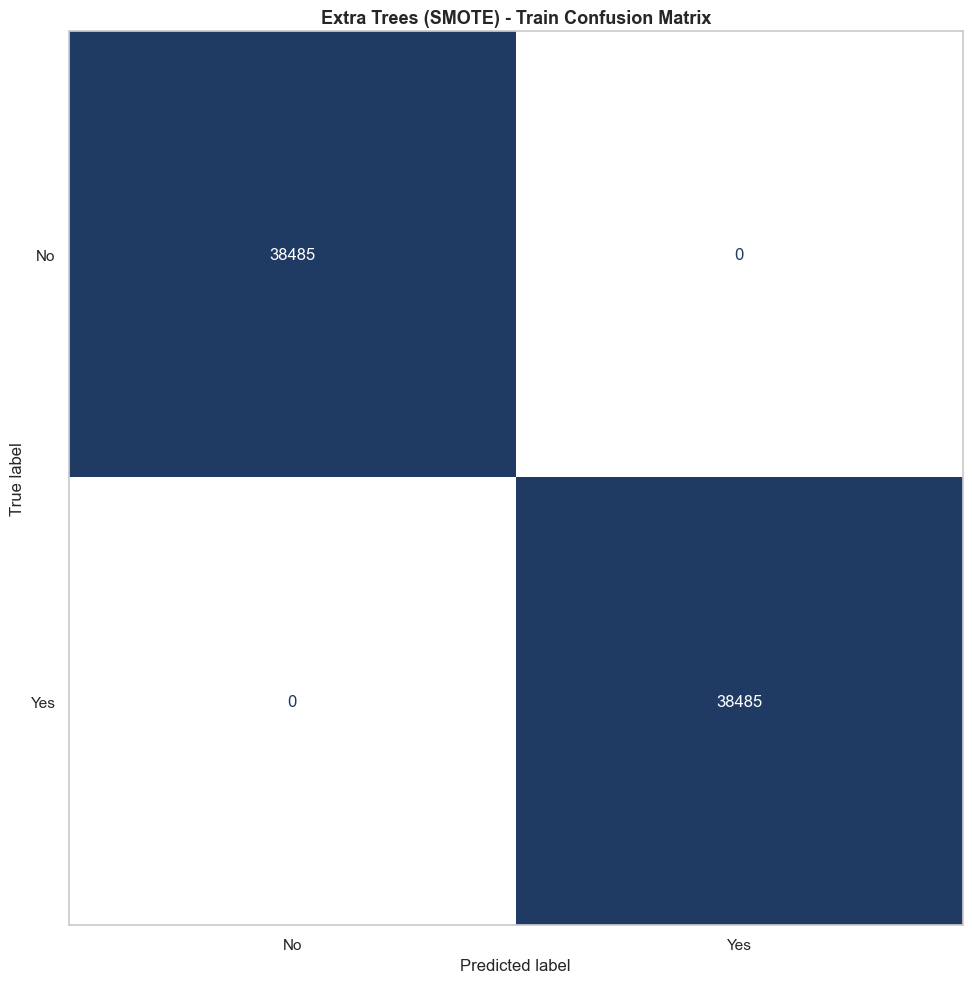

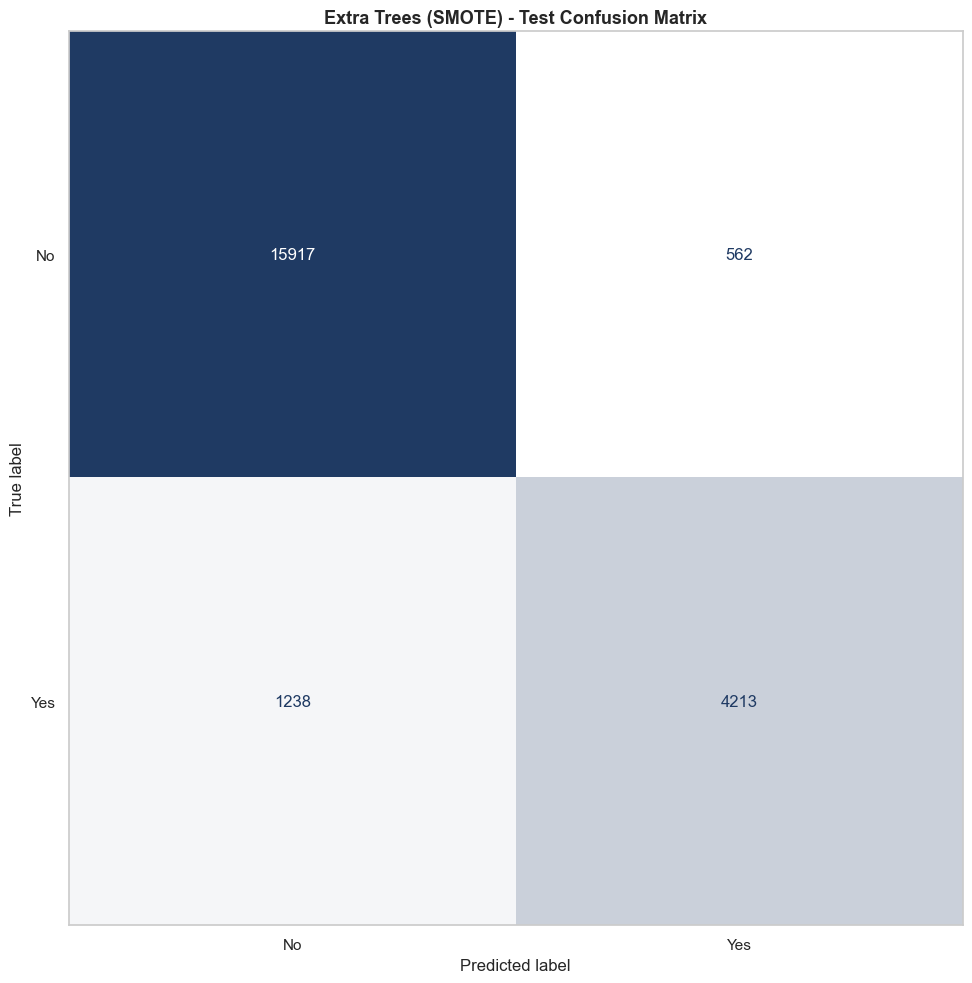

Train Report After SMOTE:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     38485
           1       1.00      1.00      1.00     38485

    accuracy                           1.00     76970
   macro avg       1.00      1.00      1.00     76970
weighted avg       1.00      1.00      1.00     76970

Test Report After SMOTE:
               precision    recall  f1-score   support

           0       0.93      0.97      0.95     16479
           1       0.88      0.77      0.82      5451

    accuracy                           0.92     21930
   macro avg       0.91      0.87      0.89     21930
weighted avg       0.92      0.92      0.92     21930

ROC AUC Score (Train): 1.0
ROC AUC Score (Test): 0.9721931246328986
------------------------------------------------------------


In [90]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from lightgbm import LGBMClassifier

smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline

categorical_features = X_train.select_dtypes(include=['object']).columns.tolist()

preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ],
    remainder='passthrough'
)

from sklearn.preprocessing import LabelEncoder


le = LabelEncoder()

y_train_encoded = le.fit_transform(y_train_smote)
y_test_encoded = le.transform(y_test)



model_blocks_smote = [
    ("Logistic Regression (SMOTE)", LogisticRegression(random_state=42), y_train_smote, y_test, "predict_proba"),
    ("GaussianNB (SMOTE)", GaussianNB(), y_train_smote, y_test, "predict_proba"),
    ("LinearSVC (SMOTE)", LinearSVC(random_state=42, max_iter=10000), y_train_smote, y_test, "decision_function"),
    ("Random Forest (SMOTE)", RandomForestClassifier(random_state=42), y_train_smote, y_test, "predict_proba"),
    ("XGBoost (SMOTE)", make_pipeline(preprocessor, XGBClassifier(eval_metric='logloss', random_state=42)),
     le.fit_transform(y_train_smote), le.transform(y_test), "predict_proba"),
    ("LightGBM (SMOTE)", make_pipeline(preprocessor, LGBMClassifier(verbose=-1, random_state=42)),
     le.fit_transform(y_train_smote), le.transform(y_test), "predict_proba"),
    ("MLP (SMOTE)", make_pipeline(StandardScaler(), MLPClassifier(random_state=42)), y_train_smote, y_test, "predict_proba"),
    ("Decision Tree (SMOTE)", DecisionTreeClassifier(random_state=42), y_train_smote, y_test, "predict_proba"),
    ("AdaBoost (SMOTE)", AdaBoostClassifier(random_state=42), y_train_smote, y_test, "predict_proba"),
    ("KNN (SMOTE)", KNeighborsClassifier(), y_train_smote, y_test, "predict_proba"),
    ("Extra Trees (SMOTE)", ExtraTreesClassifier(random_state=42), y_train_smote, y_test, "predict_proba")
]

for name, model, y_train_true, y_test_true, method in model_blocks_smote:
    print(f"🔍 {name}")
    print("-" * len(f"🔍 {name}"))

    model.fit(X_train_smote, y_train_true)

    y_train_pred = model.predict(X_train_smote)
    y_test_pred = model.predict(X_test)

    plot_conf_matrix(y_train_true, y_train_pred, f"{name} - Train Confusion Matrix")
    plot_conf_matrix(y_test_true, y_test_pred, f"{name} - Test Confusion Matrix")

    print("Train Report After SMOTE:\n", classification_report(y_train_true, y_train_pred))
    print("Test Report After SMOTE:\n", classification_report(y_test_true, y_test_pred))

    if method == "predict_proba":
        y_train_proba = model.predict_proba(X_train_smote)[:, 1]
        y_test_proba = model.predict_proba(X_test)[:, 1]
    else:
        y_train_proba = model.decision_function(X_train_smote)
        y_test_proba = model.decision_function(X_test)

    print("ROC AUC Score (Train):", roc_auc_score(y_train_true, y_train_proba))
    print("ROC AUC Score (Test):", roc_auc_score(y_test_true, y_test_proba))
    print("-" * 60)

<span style="font-family: 'Consolas';"><span style="color:magenta">
HYPERPARAMETER TUNING

In [94]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import make_scorer, recall_score
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, ExtraTreesClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

# Apply SMOTE
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Label encode where needed
le = LabelEncoder()
y_train_res_enc = le.fit_transform(y_train_resampled)
y_test_enc = le.transform(y_test)

# Categorical preprocessing
categorical_features = ['Holiday/Promotion']
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
], remainder='passthrough')

recall_scorer = make_scorer(recall_score, pos_label=1)

# 1. Logistic Regression
param_grid_log = [
    {'penalty': ['l1'], 'C': [0.01, 0.1, 1, 10], 'solver': ['liblinear', 'saga']},
    {'penalty': ['l2'], 'C': [0.01, 0.1, 1, 10], 'solver': ['liblinear', 'saga', 'lbfgs']},
    {'penalty': ['elasticnet'], 'C': [0.01, 0.1, 1], 'solver': ['saga'], 'l1_ratio': [0.3, 0.5, 0.7]},
    {'penalty': [None], 'solver': ['lbfgs', 'newton-cg'], 'C': [1]}
]
grid_log = GridSearchCV(LogisticRegression(max_iter=1000, random_state=42), 
                        param_grid_log, scoring=recall_scorer, cv=5, n_jobs=-1, error_score='raise')
grid_log.fit(X_train_resampled, y_train_resampled)
best_log = grid_log.best_estimator_
print("Best Params of Logistic Regression:", grid_log.best_params_)

# 2. GaussianNB
gnb_model = GaussianNB()
gnb_model.fit(X_train_resampled, y_train_resampled)
print("Naive Bayes has no hyperparameters to tune.")

# 3. Random Forest
param_grid_rf = {
    'n_estimators': [100, 200], 'max_depth': [None, 10],
    'min_samples_split': [2, 5], 'class_weight': ['balanced']
}
random_search_rf = RandomizedSearchCV(RandomForestClassifier(random_state=42), 
                                      param_distributions=param_grid_rf, n_iter=8, 
                                      scoring=recall_scorer, cv=5, n_jobs=-1)
random_search_rf.fit(X_train_resampled, y_train_resampled)
best_rf = random_search_rf.best_estimator_
print("Best Params of Random Forest:", random_search_rf.best_params_)

# 4. XGBoost
pipeline_xgb = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', XGBClassifier(eval_metric='logloss', random_state=42))
])
param_grid_xgb = {'classifier__n_estimators': [100, 200], 'classifier__max_depth': [3, 5]}
grid_xgb = GridSearchCV(pipeline_xgb, param_grid_xgb, scoring='recall', cv=5)
grid_xgb.fit(X_train_resampled, y_train_res_enc)
best_xgb = grid_xgb.best_estimator_
print("Best Params of XGBoost:", grid_xgb.best_params_)

# 5. Linear SVC
param_grid_svc = {'C': [0.1, 1, 10], 'class_weight': ['balanced']}
random_search_svc = RandomizedSearchCV(LinearSVC(max_iter=5000, random_state=42), 
                                       param_distributions=param_grid_svc, n_iter=3, 
                                       scoring='recall', cv=3, n_jobs=-1)
random_search_svc.fit(X_train_resampled, y_train_resampled)
best_linear_svc = random_search_svc.best_estimator_
print("Best Params of Linear SVC:", random_search_svc.best_params_)

# 6. LightGBM
pipeline_lgb = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', LGBMClassifier(verbosity=-1, random_state=42))
])
param_grid_lgb = {
    'classifier__n_estimators': [100, 200],
    'classifier__learning_rate': [0.05, 0.1],
    'classifier__max_depth': [5, 10]
}
grid_lgb = GridSearchCV(pipeline_lgb, param_grid_lgb, scoring='recall', cv=5, n_jobs=-1)
grid_lgb.fit(X_train_resampled, y_train_res_enc)
best_lgb = grid_lgb.best_estimator_
print("Best Params of LightGBM:", grid_lgb.best_params_)

# 7. MLP
pipeline_mlp = Pipeline([
    ('preprocessing', StandardScaler()),
    ('classifier', MLPClassifier(max_iter=300, random_state=42))
])
param_grid_mlp = {
    'classifier__hidden_layer_sizes': [(50,), (100,), (100, 50)],
    'classifier__alpha': [0.0001, 0.001],
    'classifier__learning_rate_init': [0.001, 0.01]
}
grid_mlp = GridSearchCV(pipeline_mlp, param_grid_mlp, scoring='recall', cv=3, n_jobs=-1)
grid_mlp.fit(X_train_resampled, y_train_resampled)
best_mlp = grid_mlp.best_estimator_
print("Best Params of MLPClassifier:", grid_mlp.best_params_)

# 8. Decision Tree
param_grid_dt = {
    'max_depth': [None, 5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'criterion': ['gini', 'entropy'],
    'class_weight': ['balanced']
}
grid_dt = GridSearchCV(DecisionTreeClassifier(random_state=42), 
                       param_grid_dt, scoring=recall_scorer, cv=5, n_jobs=-1)
grid_dt.fit(X_train_resampled, y_train_resampled)
best_dt = grid_dt.best_estimator_
print("Best Params of Decision Tree:", grid_dt.best_params_)

# 9. AdaBoost
param_grid_ab = {'n_estimators': [50, 100, 200], 'learning_rate': [0.5, 1.0, 1.5]}
grid_ab = GridSearchCV(AdaBoostClassifier(random_state=42), param_grid_ab, 
                       scoring=recall_scorer, cv=5, n_jobs=-1)
grid_ab.fit(X_train_resampled, y_train_resampled)
best_ab = grid_ab.best_estimator_
print("Best Params of AdaBoost:", grid_ab.best_params_)

# 10. KNN
pipeline_knn = Pipeline([
    ('scaler', StandardScaler()),
    ('classifier', KNeighborsClassifier())
])
param_grid_knn = {
    'classifier__n_neighbors': [3, 5, 7],
    'classifier__weights': ['uniform', 'distance'],
    'classifier__p': [1, 2]
}
grid_knn = GridSearchCV(pipeline_knn, param_grid_knn, scoring=recall_scorer, cv=5, n_jobs=-1)
grid_knn.fit(X_train_resampled, y_train_resampled)
best_knn = grid_knn.best_estimator_
print("Best Params of KNN:", grid_knn.best_params_)

# 11. Extra Trees
param_grid_et = {
    'n_estimators': [100, 200],
    'max_depth': [None, 10],
    'min_samples_split': [2, 5],
    'class_weight': ['balanced']
}
grid_et = GridSearchCV(ExtraTreesClassifier(random_state=42), 
                       param_grid_et, scoring=recall_scorer, cv=5, n_jobs=-1)
grid_et.fit(X_train_resampled, y_train_resampled)
best_et = grid_et.best_estimator_
print("Best Params of Extra Trees:", grid_et.best_params_)

Best Params of Logistic Regression: {'C': 0.01, 'penalty': 'l2', 'solver': 'liblinear'}
Naive Bayes has no hyperparameters to tune.
Best Params of Random Forest: {'n_estimators': 200, 'min_samples_split': 2, 'max_depth': 10, 'class_weight': 'balanced'}
Best Params of XGBoost: {'classifier__max_depth': 5, 'classifier__n_estimators': 100}
Best Params of Linear SVC: {'class_weight': 'balanced', 'C': 0.1}
Best Params of LightGBM: {'classifier__learning_rate': 0.05, 'classifier__max_depth': 5, 'classifier__n_estimators': 100}
Best Params of MLPClassifier: {'classifier__alpha': 0.0001, 'classifier__hidden_layer_sizes': (100, 50), 'classifier__learning_rate_init': 0.01}
Best Params of Decision Tree: {'class_weight': 'balanced', 'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 2}
Best Params of AdaBoost: {'learning_rate': 0.5, 'n_estimators': 50}
Best Params of KNN: {'classifier__n_neighbors': 3, 'classifier__p': 1, 'classifier__weights': 'distance'}
Best Params of Extra Trees: {'c

<span style="font-family: 'Consolas';"><span style="color:magenta">
MODEL PERFORMANCE AFTER HYPERPARAMETER TUNING SMOTE

Logistic Regression (SMOTE)
---------------------------


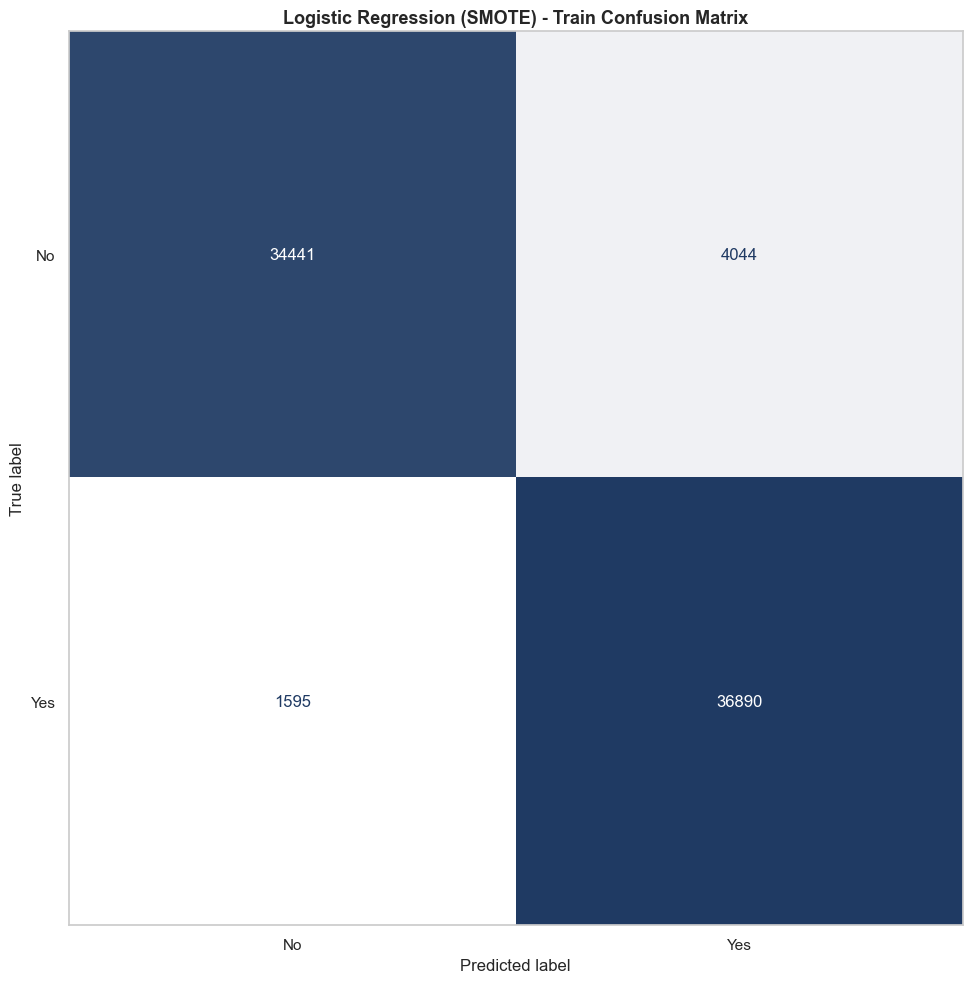

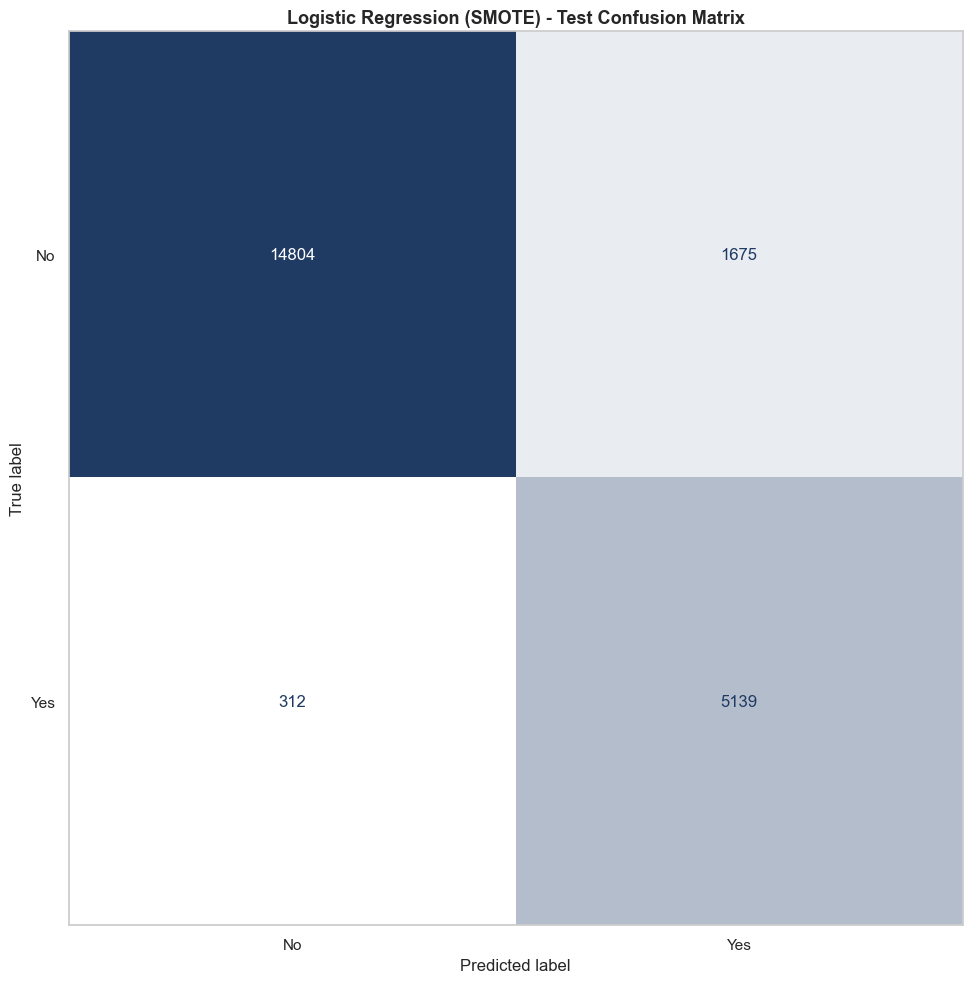

Train Report:
               precision    recall  f1-score   support

           0       0.96      0.89      0.92     38485
           1       0.90      0.96      0.93     38485

    accuracy                           0.93     76970
   macro avg       0.93      0.93      0.93     76970
weighted avg       0.93      0.93      0.93     76970

Test Report:
               precision    recall  f1-score   support

           0       0.98      0.90      0.94     16479
           1       0.75      0.94      0.84      5451

    accuracy                           0.91     21930
   macro avg       0.87      0.92      0.89     21930
weighted avg       0.92      0.91      0.91     21930

ROC AUC Score (Train): 0.970235518111268
ROC AUC Score (Test): 0.9689343727487636
------------------------------------------------------------
Random Forest (SMOTE)
---------------------


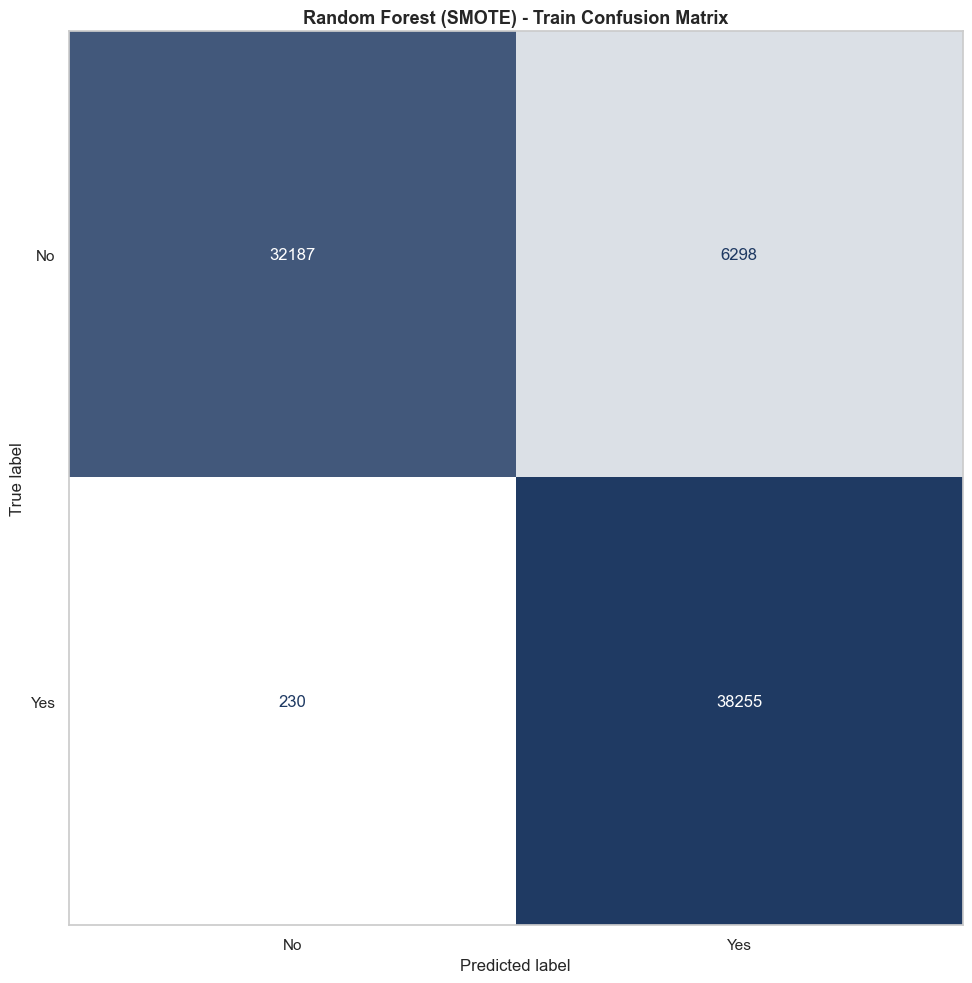

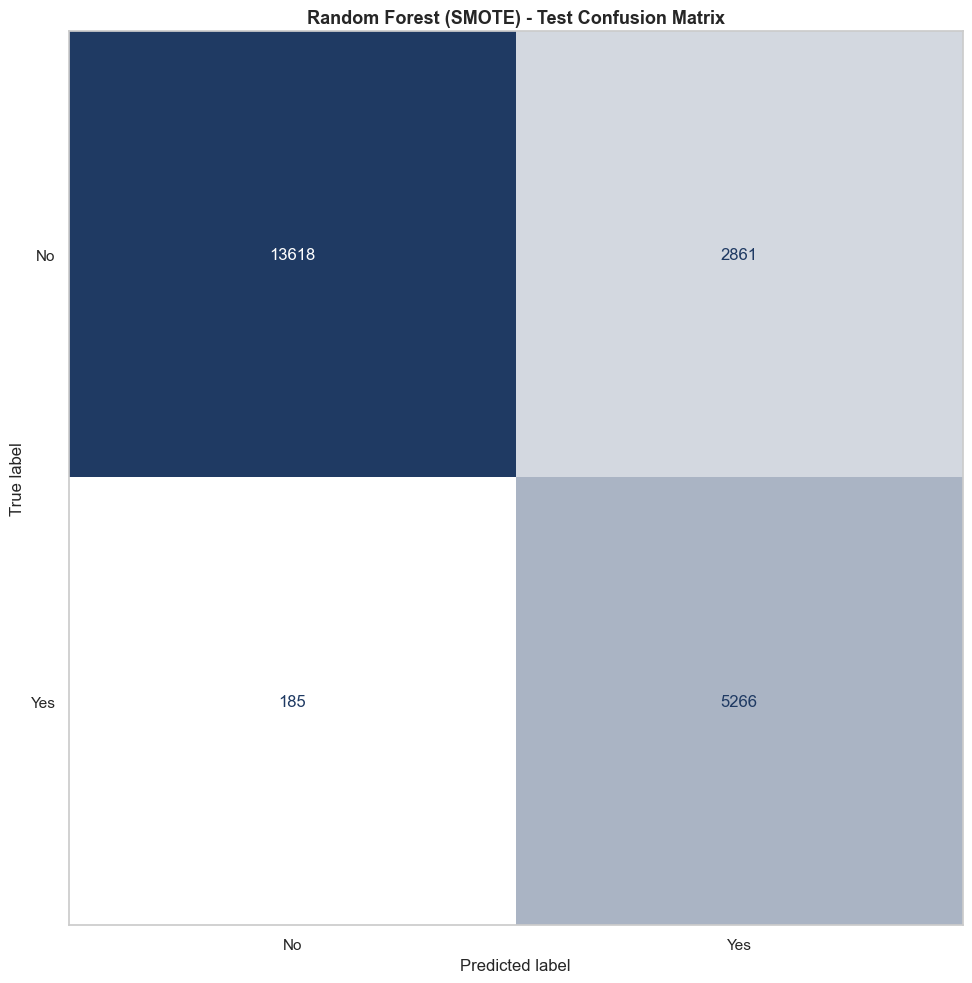

Train Report:
               precision    recall  f1-score   support

           0       0.99      0.84      0.91     38485
           1       0.86      0.99      0.92     38485

    accuracy                           0.92     76970
   macro avg       0.93      0.92      0.91     76970
weighted avg       0.93      0.92      0.91     76970

Test Report:
               precision    recall  f1-score   support

           0       0.99      0.83      0.90     16479
           1       0.65      0.97      0.78      5451

    accuracy                           0.86     21930
   macro avg       0.82      0.90      0.84     21930
weighted avg       0.90      0.86      0.87     21930

ROC AUC Score (Train): 0.9918268010080176
ROC AUC Score (Test): 0.9684537045080271
------------------------------------------------------------
XGBoost (SMOTE)
---------------


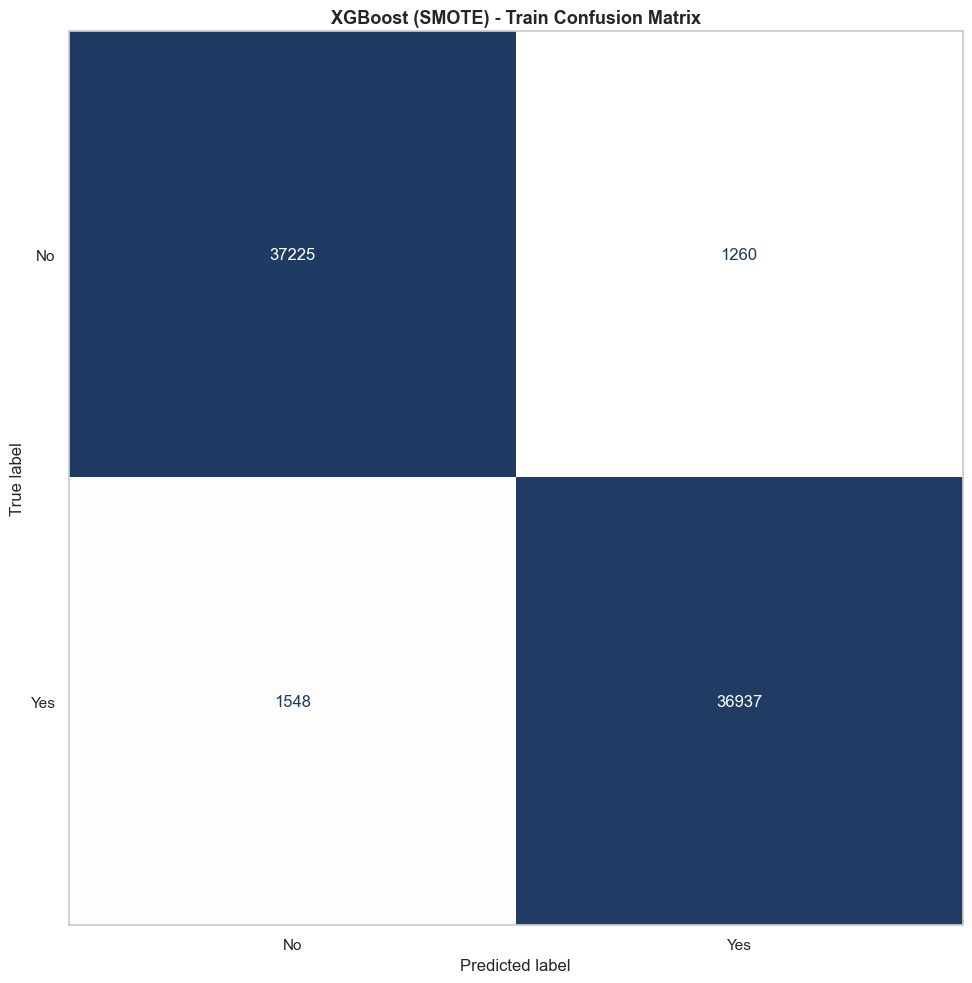

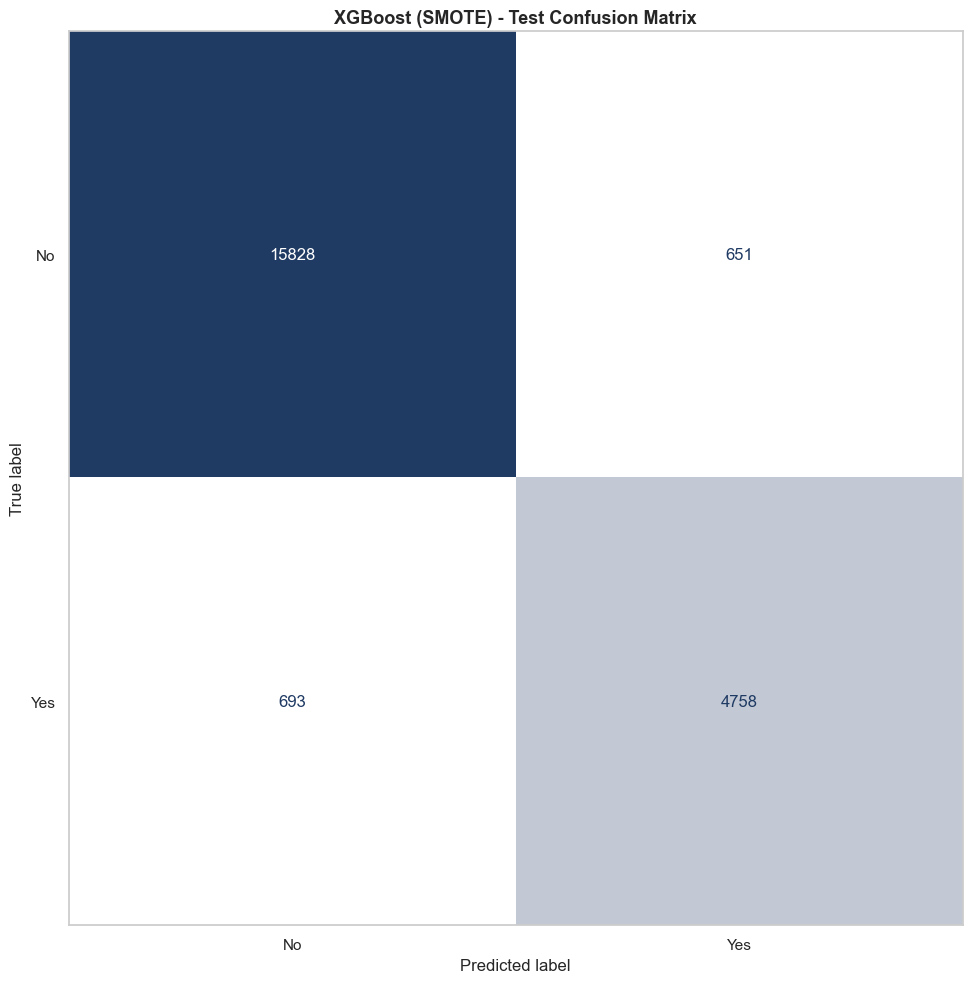

Train Report:
               precision    recall  f1-score   support

           0       0.96      0.97      0.96     38485
           1       0.97      0.96      0.96     38485

    accuracy                           0.96     76970
   macro avg       0.96      0.96      0.96     76970
weighted avg       0.96      0.96      0.96     76970

Test Report:
               precision    recall  f1-score   support

           0       0.96      0.96      0.96     16479
           1       0.88      0.87      0.88      5451

    accuracy                           0.94     21930
   macro avg       0.92      0.92      0.92     21930
weighted avg       0.94      0.94      0.94     21930

ROC AUC Score (Train): 0.9963102210392987
ROC AUC Score (Test): 0.9859026618814254
------------------------------------------------------------
LinearSVC (SMOTE)
-----------------


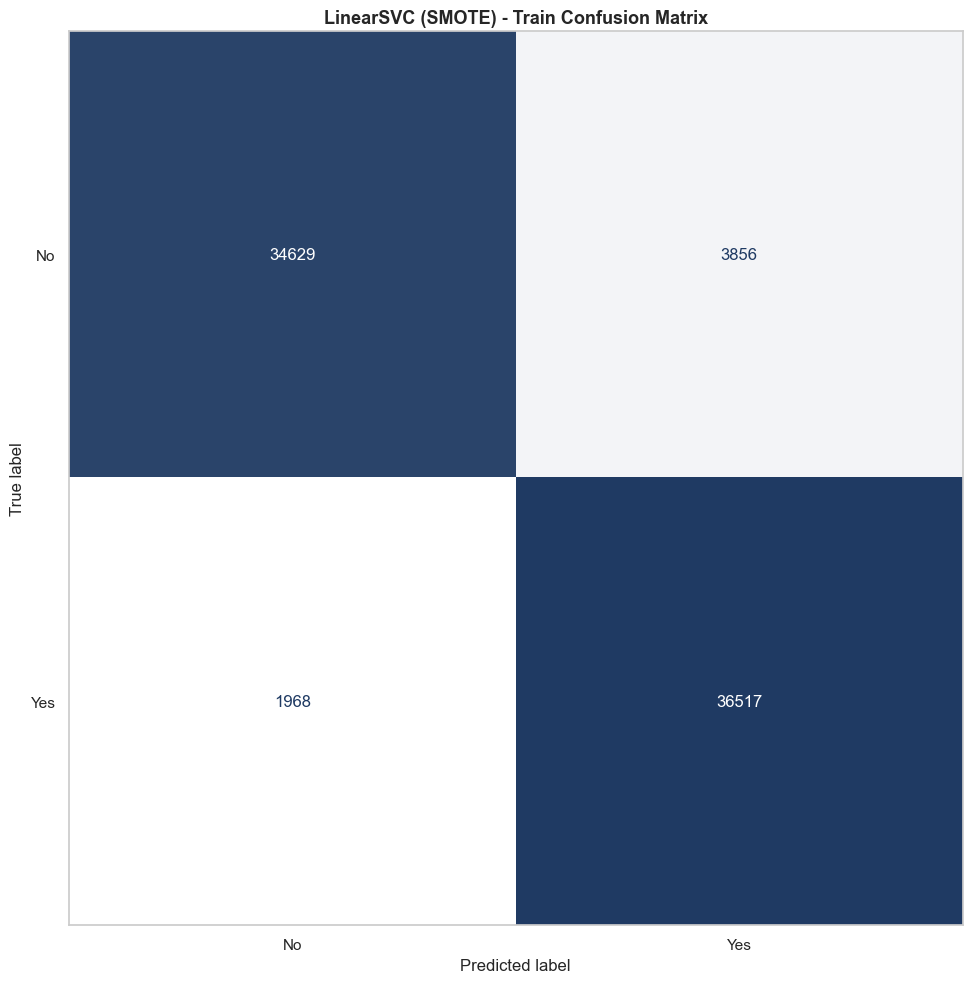

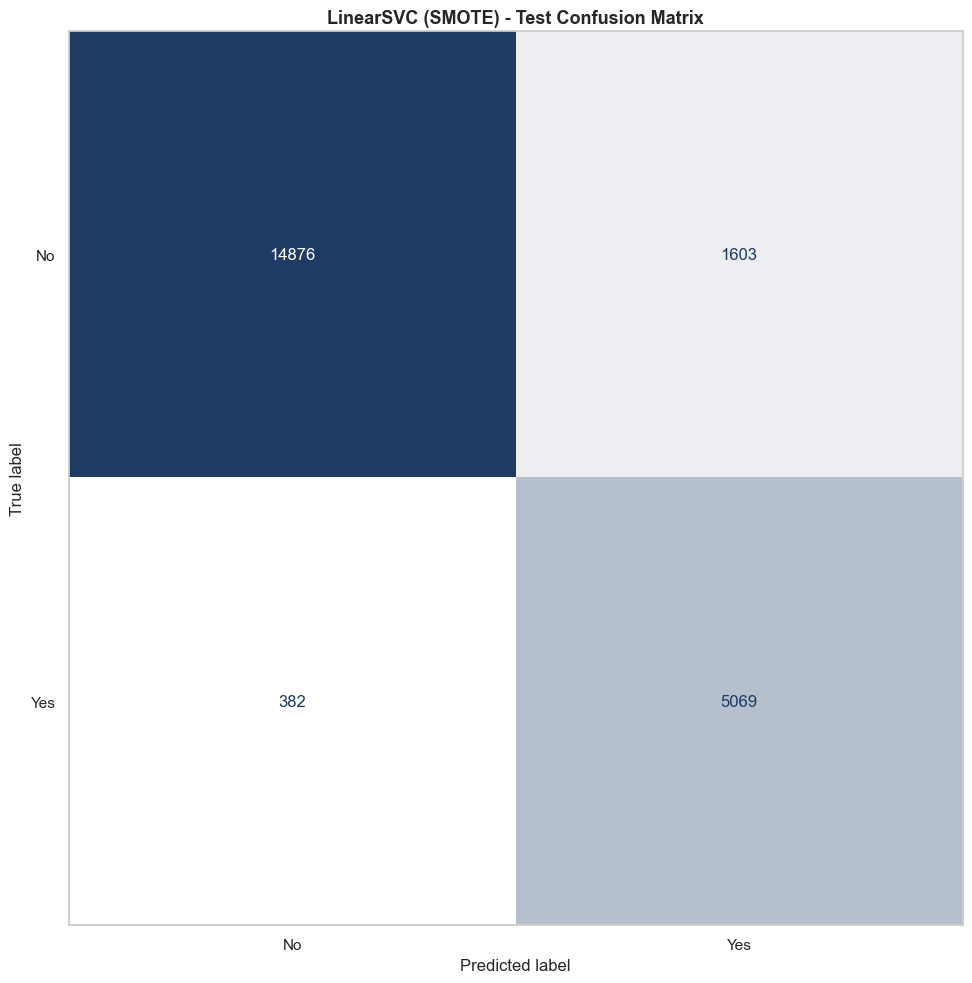

Train Report:
               precision    recall  f1-score   support

           0       0.95      0.90      0.92     38485
           1       0.90      0.95      0.93     38485

    accuracy                           0.92     76970
   macro avg       0.93      0.92      0.92     76970
weighted avg       0.93      0.92      0.92     76970

Test Report:
               precision    recall  f1-score   support

           0       0.97      0.90      0.94     16479
           1       0.76      0.93      0.84      5451

    accuracy                           0.91     21930
   macro avg       0.87      0.92      0.89     21930
weighted avg       0.92      0.91      0.91     21930

ROC AUC Score (Train): 0.9700422948835042
ROC AUC Score (Test): 0.9688142084717061
------------------------------------------------------------
LightGBM (SMOTE)
----------------


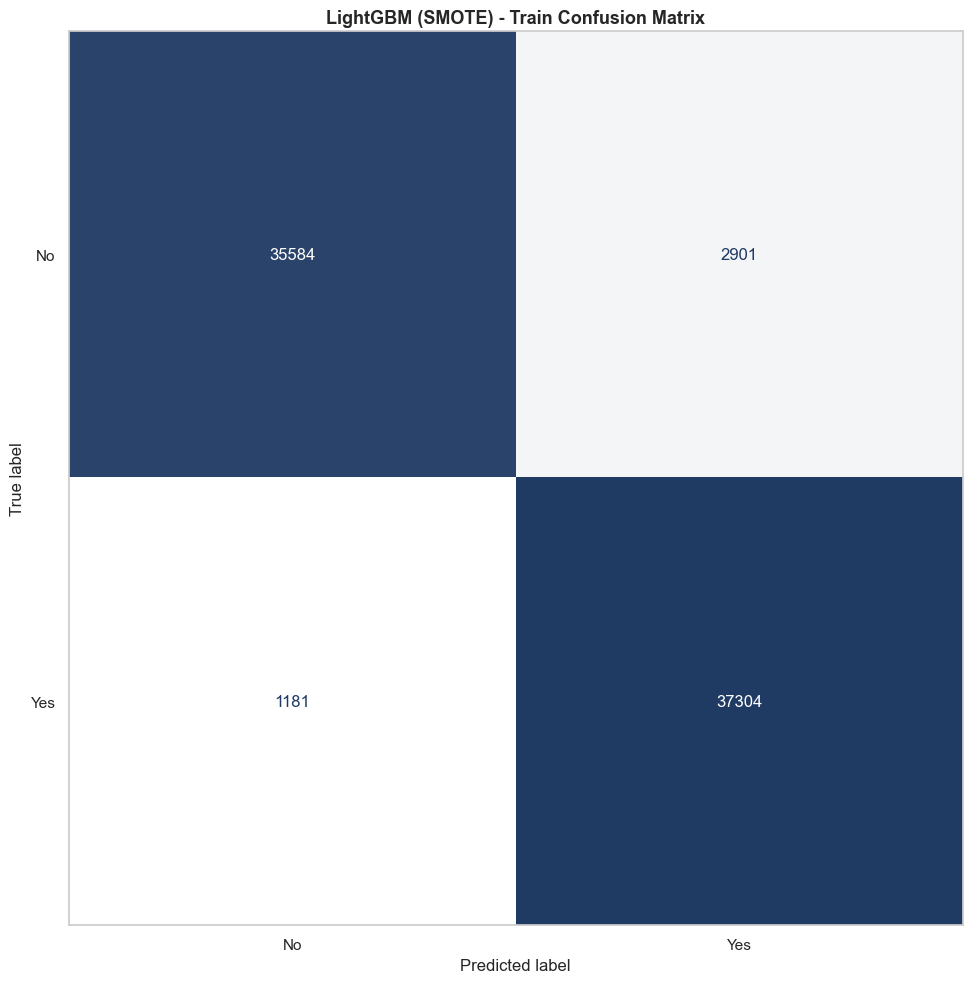

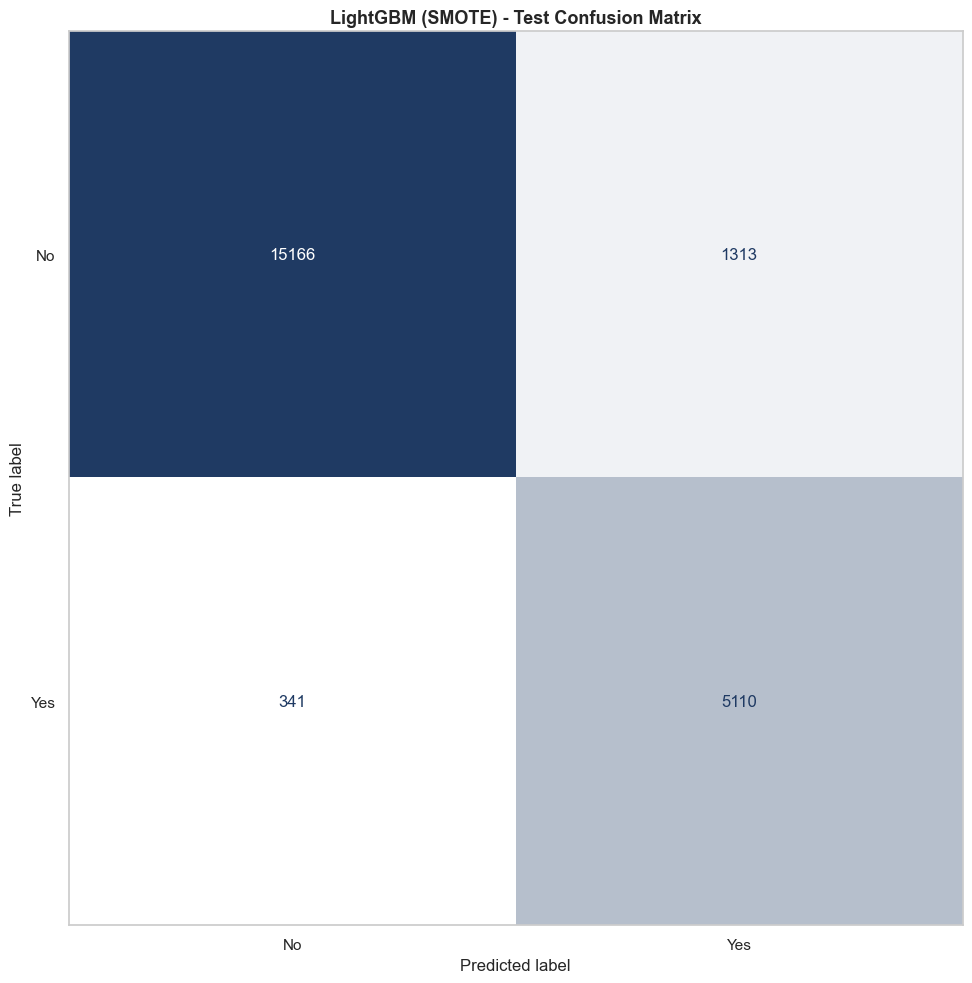

Train Report:
               precision    recall  f1-score   support

           0       0.97      0.92      0.95     38485
           1       0.93      0.97      0.95     38485

    accuracy                           0.95     76970
   macro avg       0.95      0.95      0.95     76970
weighted avg       0.95      0.95      0.95     76970

Test Report:
               precision    recall  f1-score   support

           0       0.98      0.92      0.95     16479
           1       0.80      0.94      0.86      5451

    accuracy                           0.92     21930
   macro avg       0.89      0.93      0.90     21930
weighted avg       0.93      0.92      0.93     21930

ROC AUC Score (Train): 0.991393516578247
ROC AUC Score (Test): 0.9860327786194509
------------------------------------------------------------
MLPClassifier (SMOTE)
---------------------


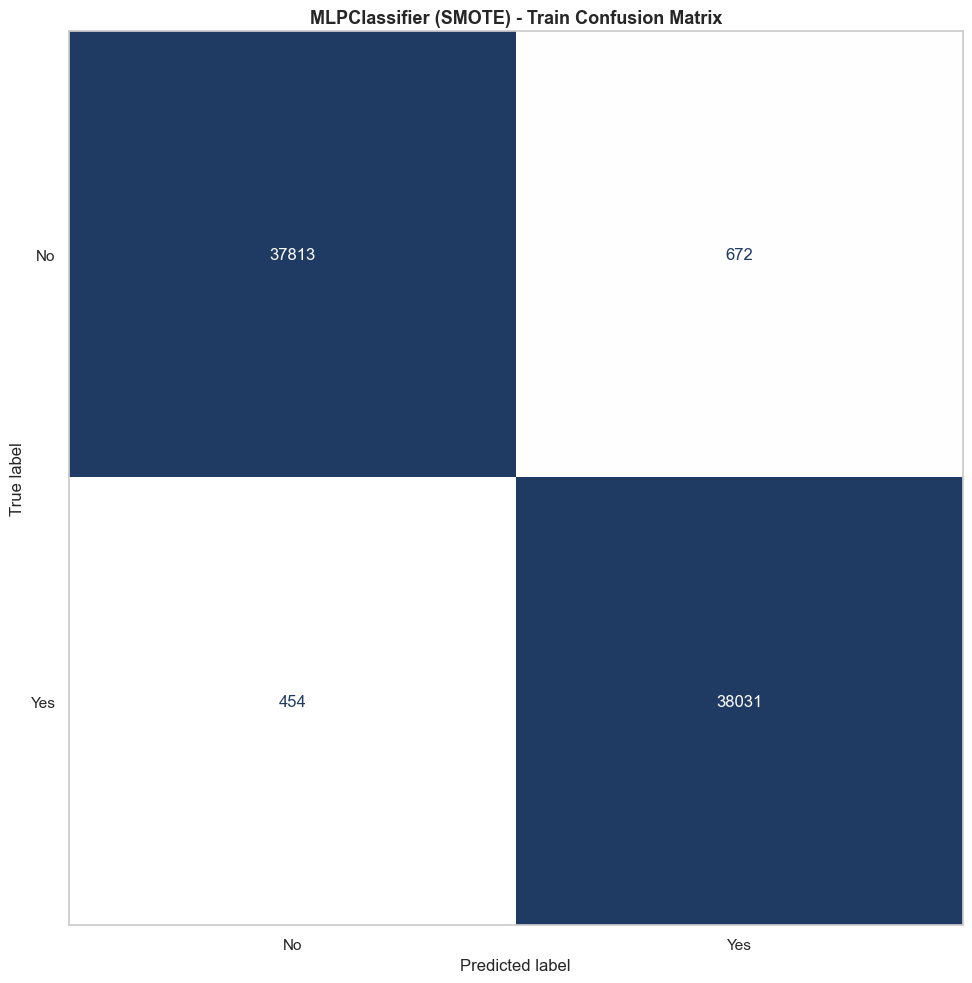

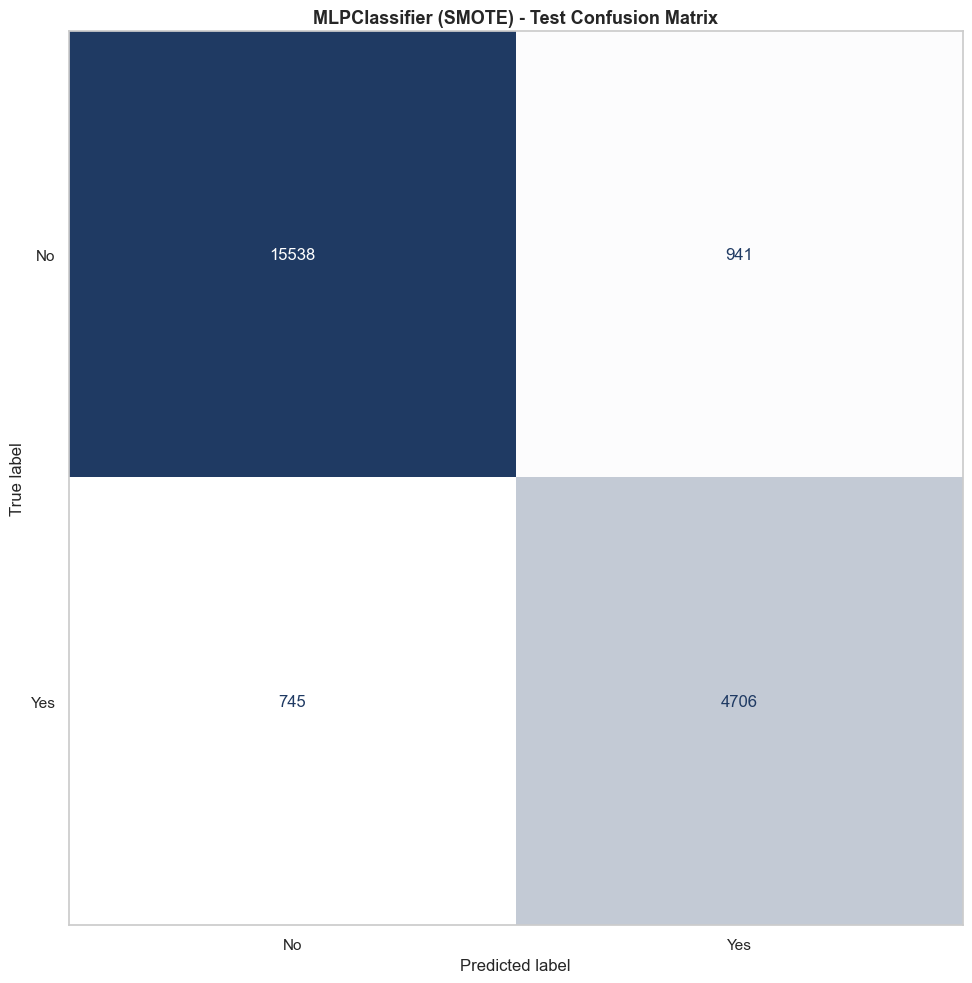

Train Report:
               precision    recall  f1-score   support

           0       0.99      0.98      0.99     38485
           1       0.98      0.99      0.99     38485

    accuracy                           0.99     76970
   macro avg       0.99      0.99      0.99     76970
weighted avg       0.99      0.99      0.99     76970

Test Report:
               precision    recall  f1-score   support

           0       0.95      0.94      0.95     16479
           1       0.83      0.86      0.85      5451

    accuracy                           0.92     21930
   macro avg       0.89      0.90      0.90     21930
weighted avg       0.92      0.92      0.92     21930

ROC AUC Score (Train): 0.9991111496561608
ROC AUC Score (Test): 0.9792579859231456
------------------------------------------------------------
Decision Tree (SMOTE)
---------------------


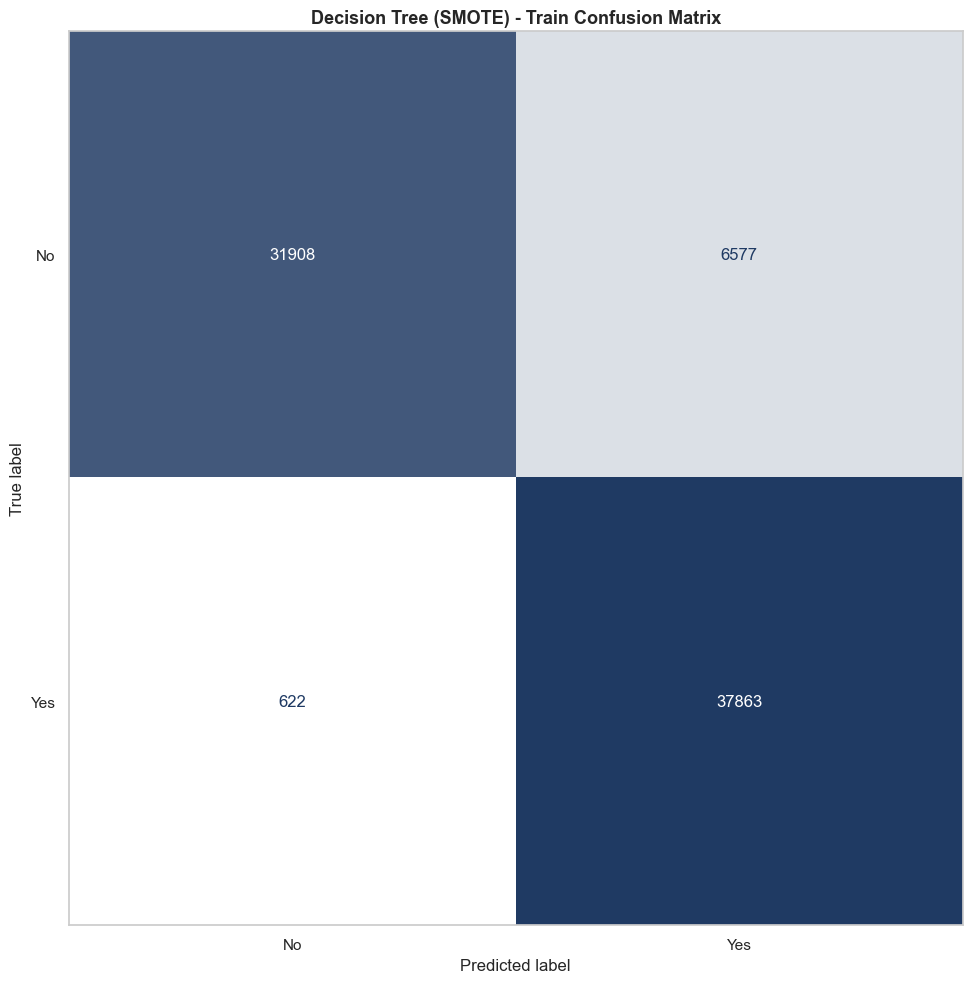

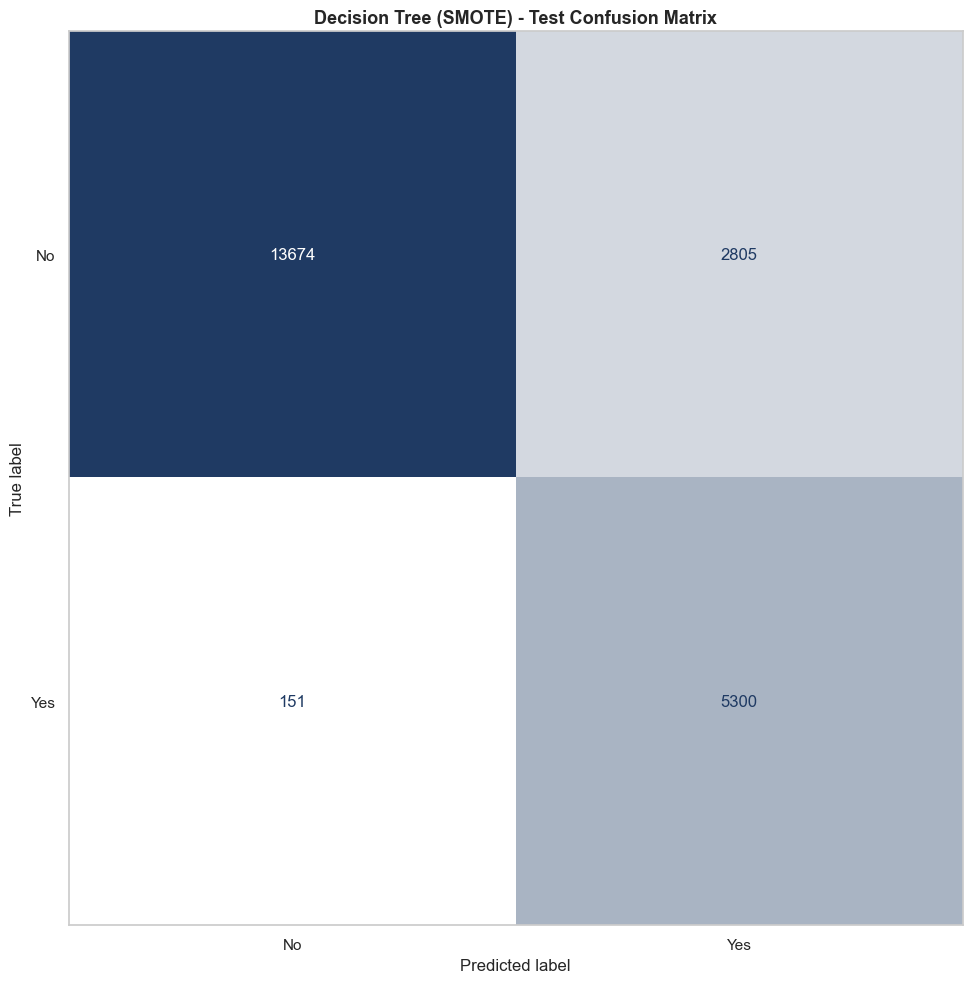

Train Report:
               precision    recall  f1-score   support

           0       0.98      0.83      0.90     38485
           1       0.85      0.98      0.91     38485

    accuracy                           0.91     76970
   macro avg       0.92      0.91      0.91     76970
weighted avg       0.92      0.91      0.91     76970

Test Report:
               precision    recall  f1-score   support

           0       0.99      0.83      0.90     16479
           1       0.65      0.97      0.78      5451

    accuracy                           0.87     21930
   macro avg       0.82      0.90      0.84     21930
weighted avg       0.91      0.87      0.87     21930

ROC AUC Score (Train): 0.9639342932862403
ROC AUC Score (Test): 0.9584965734534091
------------------------------------------------------------
AdaBoost (SMOTE)
----------------


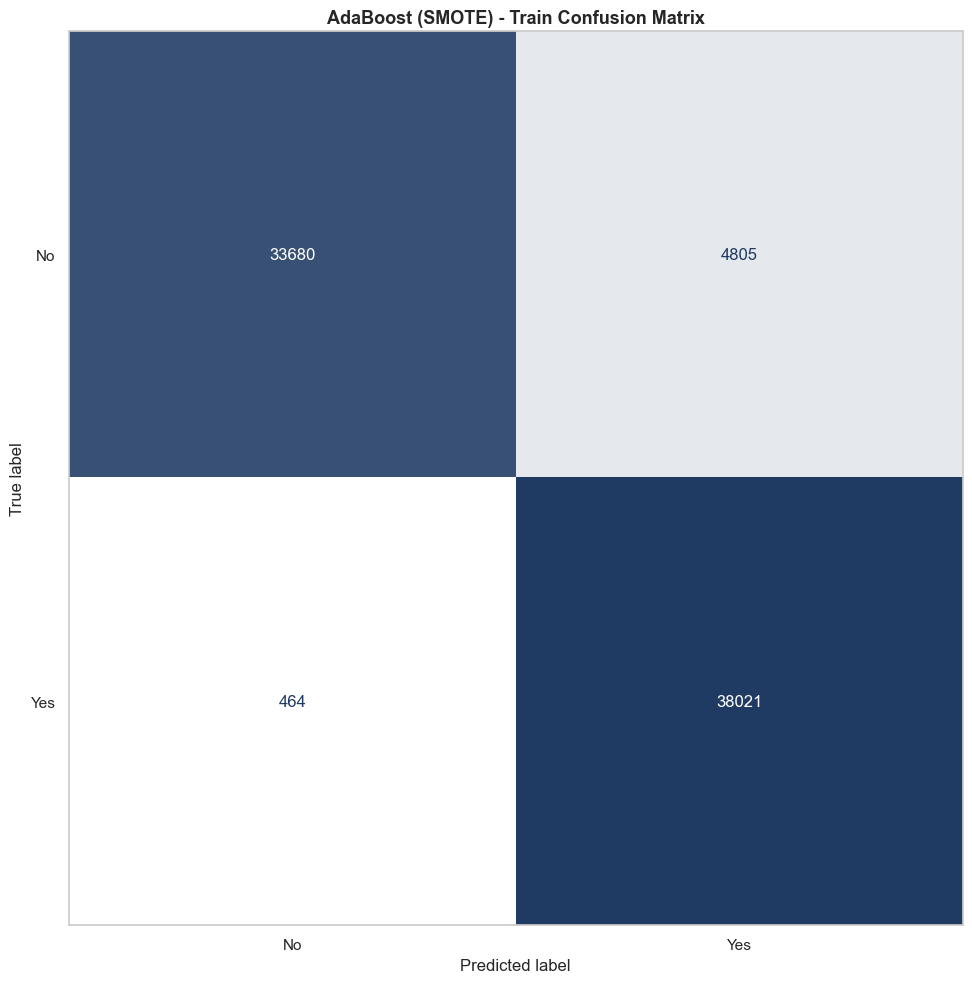

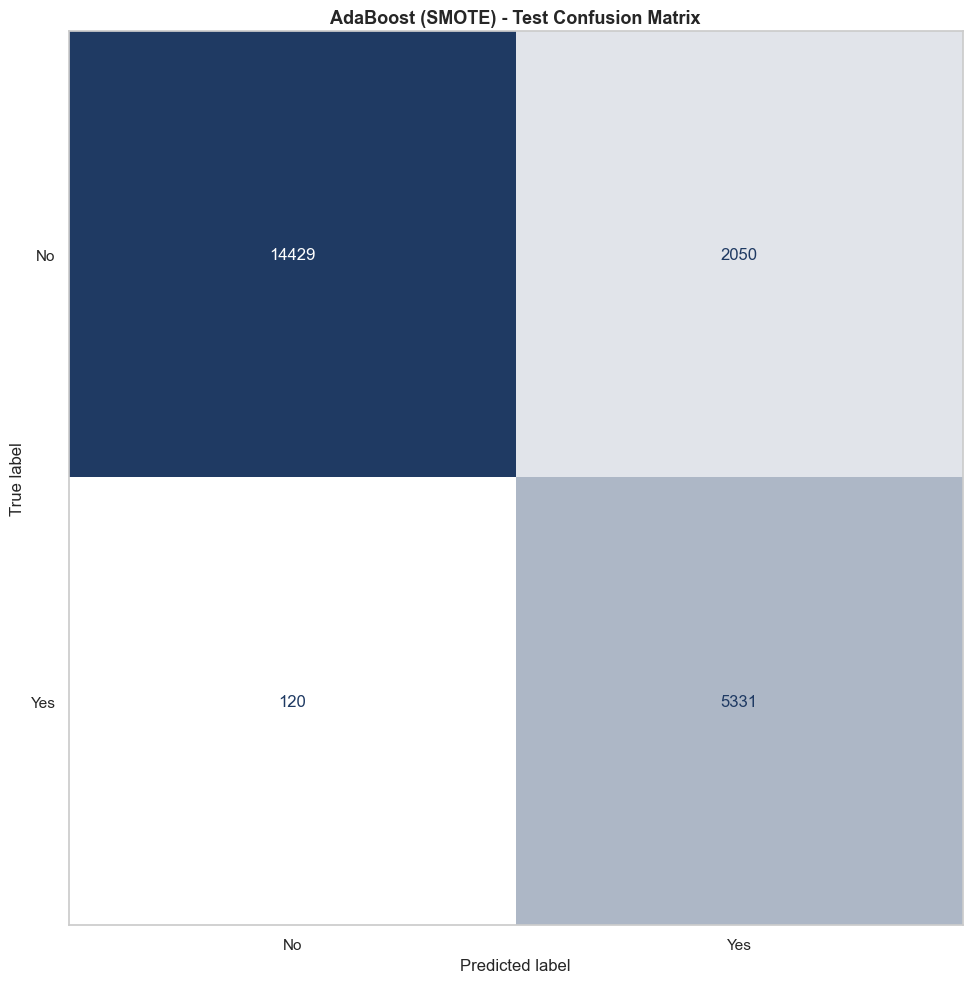

Train Report:
               precision    recall  f1-score   support

           0       0.99      0.88      0.93     38485
           1       0.89      0.99      0.94     38485

    accuracy                           0.93     76970
   macro avg       0.94      0.93      0.93     76970
weighted avg       0.94      0.93      0.93     76970

Test Report:
               precision    recall  f1-score   support

           0       0.99      0.88      0.93     16479
           1       0.72      0.98      0.83      5451

    accuracy                           0.90     21930
   macro avg       0.86      0.93      0.88     21930
weighted avg       0.92      0.90      0.91     21930

ROC AUC Score (Train): 0.9883049363014454
ROC AUC Score (Test): 0.9832029232537568
------------------------------------------------------------
KNN (SMOTE)
-----------


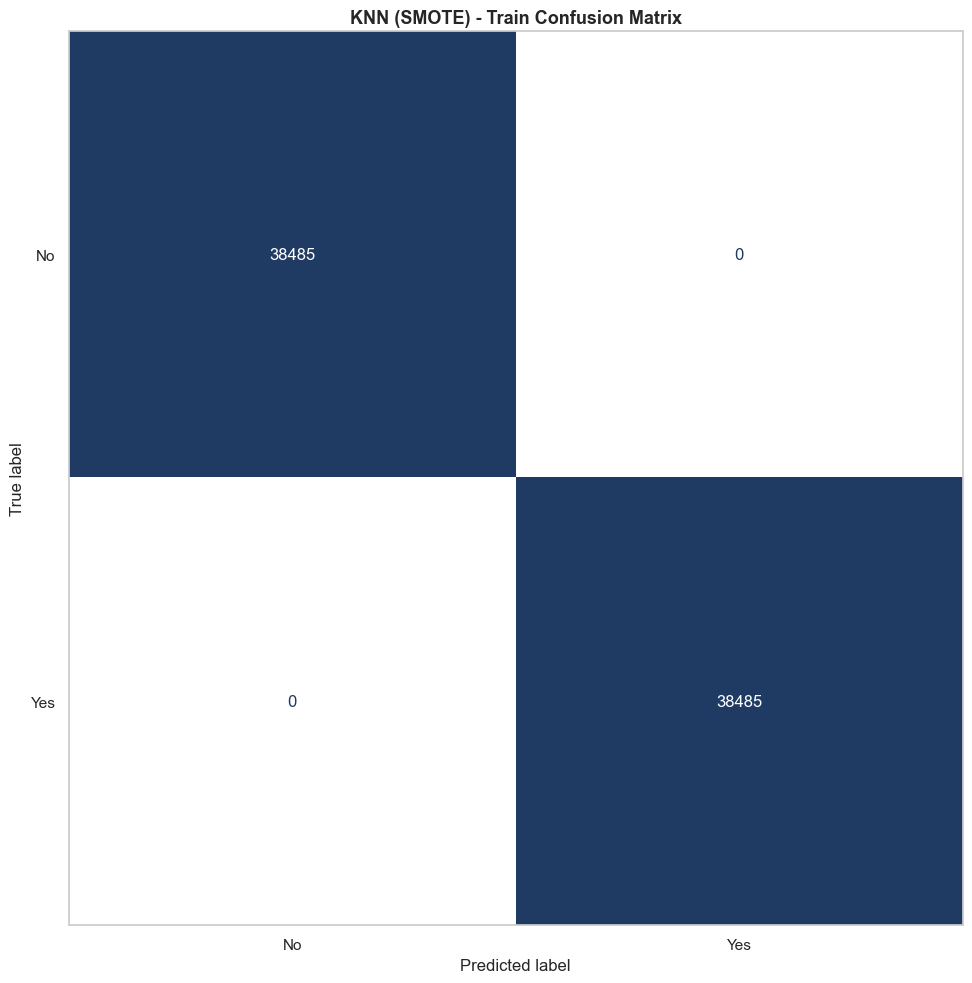

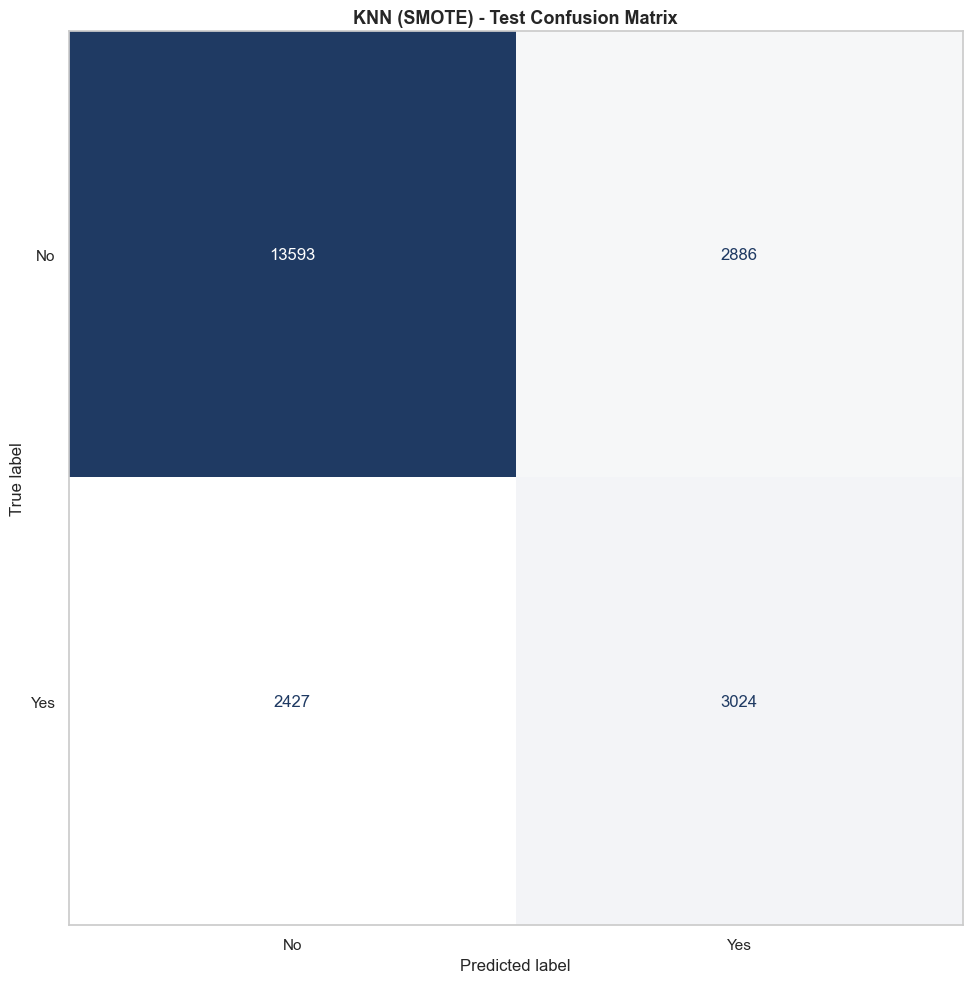

Train Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     38485
           1       1.00      1.00      1.00     38485

    accuracy                           1.00     76970
   macro avg       1.00      1.00      1.00     76970
weighted avg       1.00      1.00      1.00     76970

Test Report:
               precision    recall  f1-score   support

           0       0.85      0.82      0.84     16479
           1       0.51      0.55      0.53      5451

    accuracy                           0.76     21930
   macro avg       0.68      0.69      0.68     21930
weighted avg       0.76      0.76      0.76     21930

ROC AUC Score (Train): 1.0
ROC AUC Score (Test): 0.7618369856137621
------------------------------------------------------------
Extra Trees (SMOTE)
-------------------


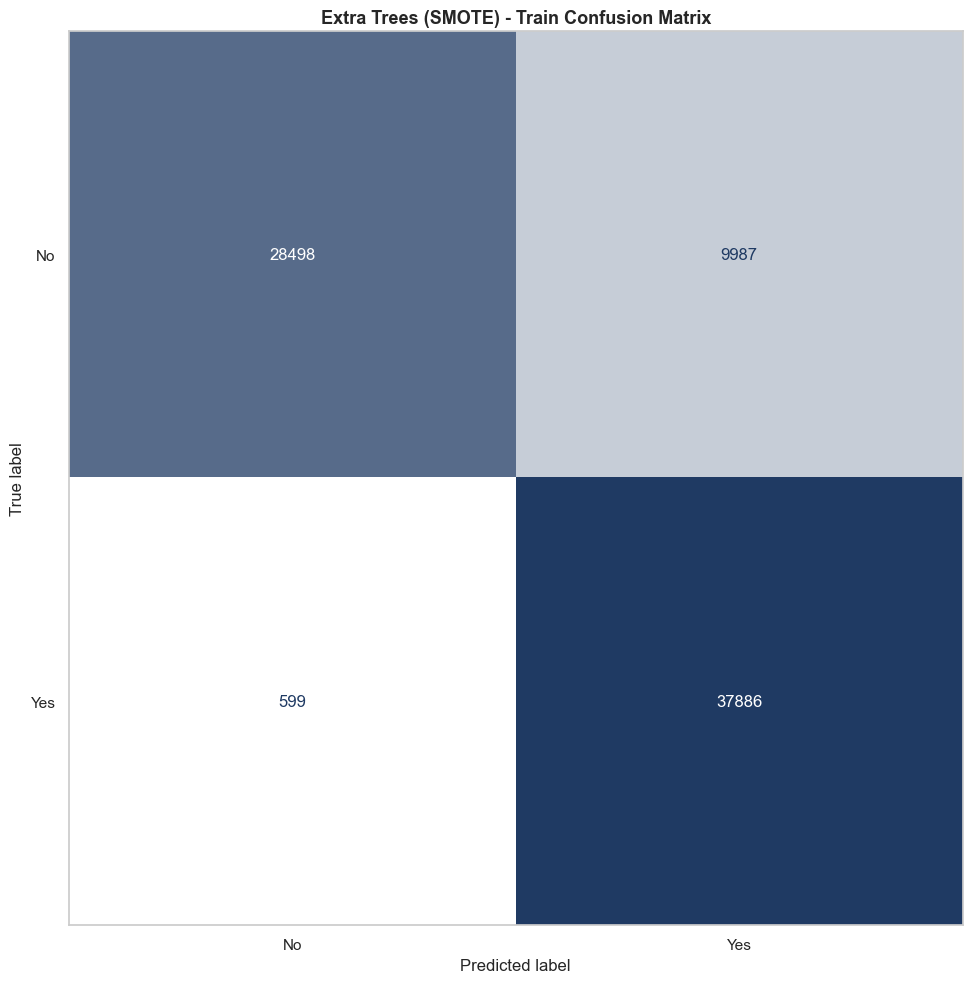

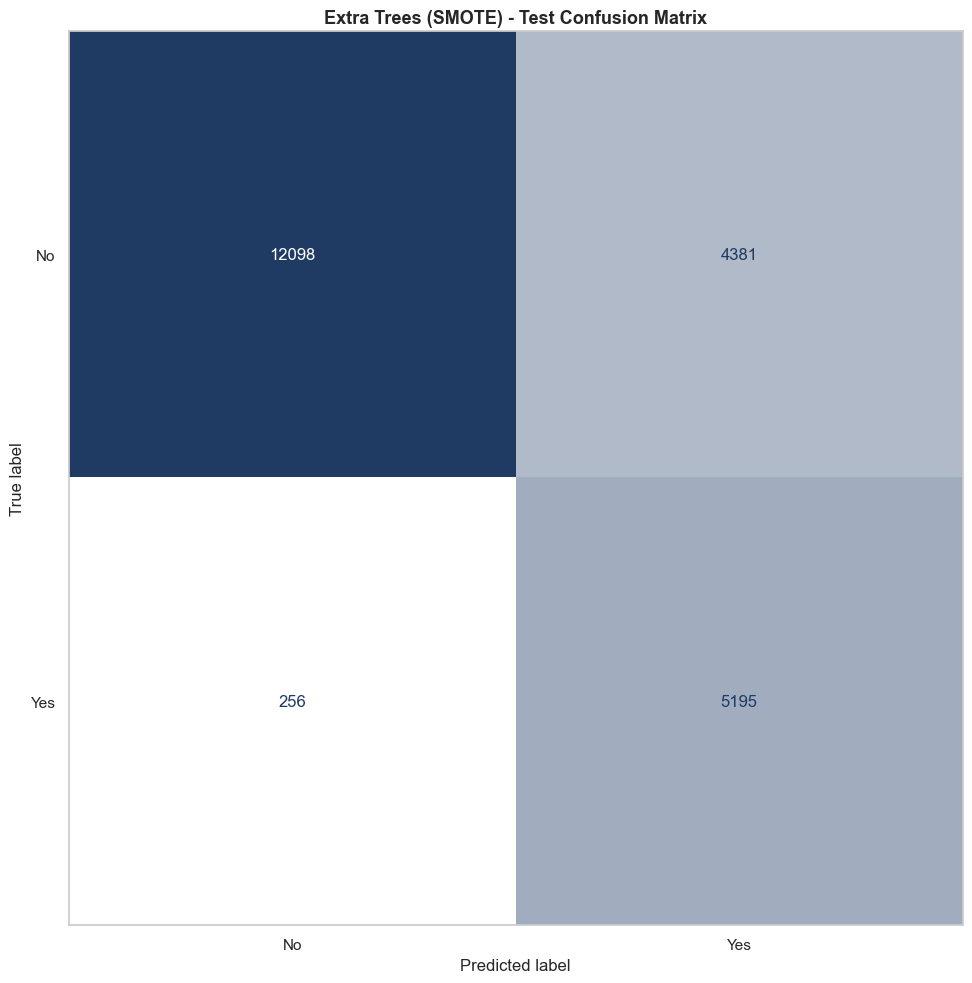

Train Report:
               precision    recall  f1-score   support

           0       0.98      0.74      0.84     38485
           1       0.79      0.98      0.88     38485

    accuracy                           0.86     76970
   macro avg       0.89      0.86      0.86     76970
weighted avg       0.89      0.86      0.86     76970

Test Report:
               precision    recall  f1-score   support

           0       0.98      0.73      0.84     16479
           1       0.54      0.95      0.69      5451

    accuracy                           0.79     21930
   macro avg       0.76      0.84      0.77     21930
weighted avg       0.87      0.79      0.80     21930

ROC AUC Score (Train): 0.9805805450490195
ROC AUC Score (Test): 0.9456856911075172
------------------------------------------------------------


In [96]:
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, roc_auc_score
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

labels = ['No', 'Yes']
custom_blues = LinearSegmentedColormap.from_list("custom_blues", ['white', '#1F3A63'])

def plot_conf_matrix(y_true, y_pred, title):
    disp = ConfusionMatrixDisplay.from_predictions(
        y_true, y_pred,
        display_labels=labels,
        cmap=custom_blues,
        colorbar=False
    )
    disp.ax_.set_title(title, fontsize=13, weight='bold')
    disp.ax_.tick_params(labelsize=11)
    plt.grid(False)
    plt.tight_layout()
    plt.show()

# SMOTE models with correctly matched train/test encoding
models_info = [
    ("Logistic Regression (SMOTE)", best_log, y_train_resampled, y_test, "predict_proba", X_train_resampled, X_test),
    ("Random Forest (SMOTE)", best_rf, y_train_resampled, y_test, "predict_proba", X_train_resampled, X_test),
    ("XGBoost (SMOTE)", best_xgb, y_train_res_enc, y_test_enc, "predict_proba", X_train_resampled, X_test),
    ("LinearSVC (SMOTE)", best_linear_svc, y_train_resampled, y_test, "decision_function", X_train_resampled, X_test),
    ("LightGBM (SMOTE)", best_lgb, y_train_res_enc, y_test_enc, "predict_proba", X_train_resampled, X_test),
    ("MLPClassifier (SMOTE)", best_mlp, y_train_resampled, y_test, "predict_proba", X_train_resampled, X_test),
    ("Decision Tree (SMOTE)", best_dt, y_train_resampled, y_test, "predict_proba", X_train_resampled, X_test),
    ("AdaBoost (SMOTE)", best_ab, y_train_resampled, y_test, "predict_proba", X_train_resampled, X_test),
    ("KNN (SMOTE)", best_knn, y_train_resampled, y_test, "predict_proba", X_train_resampled, X_test),
    ("Extra Trees (SMOTE)", best_et, y_train_resampled, y_test, "predict_proba", X_train_resampled, X_test)
]

for name, model, y_train_true, y_test_true, proba_method, X_train_used, X_test_used in models_info:
    print(name)
    print("-" * len(name))

    # Predictions
    y_train_pred = model.predict(X_train_used)
    y_test_pred = model.predict(X_test_used)

    # Confusion Matrix
    plot_conf_matrix(y_train_true, y_train_pred, f"{name} - Train Confusion Matrix")
    plot_conf_matrix(y_test_true, y_test_pred, f"{name} - Test Confusion Matrix")

    # Classification Report
    print("Train Report:\n", classification_report(y_train_true, y_train_pred))
    print("Test Report:\n", classification_report(y_test_true, y_test_pred))

    # ROC AUC Score
    if proba_method == "predict_proba":
        y_train_proba = model.predict_proba(X_train_used)[:, 1]
        y_test_proba = model.predict_proba(X_test_used)[:, 1]
    else:  # for LinearSVC
        y_train_proba = model.decision_function(X_train_used)
        y_test_proba = model.decision_function(X_test_used)

    print("ROC AUC Score (Train):", roc_auc_score(y_train_true, y_train_proba))
    print("ROC AUC Score (Test):", roc_auc_score(y_test_true, y_test_proba))
    print("-" * 60)
